In [176]:
# Import Required Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.ensemble import IsolationForest
from statsmodels.tsa.arima.model import ARIMA
from sklearn.linear_model import LinearRegression
import warnings
warnings.filterwarnings('ignore')

In [177]:
demo_df = pd.read_csv('demo_df.csv')
biom_df = pd.read_csv('bio_df.csv')
enrol_df = pd.read_csv('enrol_df.csv')


In [178]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
0,02-03-2025,Meghalaya,East Khasi Hills,793121,11,61,37,3,March
1,09-03-2025,Karnataka,Bengaluru Urban,560043,14,33,39,3,March
2,09-03-2025,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,3,March
3,09-03-2025,Uttar Pradesh,Aligarh,202133,62,29,15,3,March
4,09-03-2025,Karnataka,Bengaluru Urban,560016,14,16,21,3,March


In [179]:
enrol_df.shape

(1006007, 9)

In [180]:
enrol_df[enrol_df['state'] == "Assam"]

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
33,15-03-2025,Assam,Marigaon,782104,10,11,46,3,March
34,15-03-2025,Assam,Kokrajhar,783350,10,16,18,3,March
39,15-03-2025,Assam,Nagaon,782124,19,15,22,3,March
45,15-03-2025,Assam,Marigaon,782105,26,16,140,3,March
48,15-03-2025,Assam,Marigaon,782127,12,16,20,3,March
...,...,...,...,...,...,...,...,...,...
1002795,31-12-2025,Assam,South Salmara Mankachar,783128,1,0,0,12,December
1002796,31-12-2025,Assam,Sribhumi,788713,0,1,0,12,December
1002797,31-12-2025,Assam,Sribhumi,788737,1,0,0,12,December
1002798,31-12-2025,Assam,Tinsukia,786154,0,3,2,12,December


In [181]:
def swap_to_dmy(date_str):
    # Ensure it's a string and remove leading/trailing spaces
    date_str = str(date_str).strip()
    
    # Check if the string matches the standard 10-character format (MM-DD-YYYY)
    # This ensures we don't process the "faulty" rows with extra characters like the "5"
    if len(date_str) == 10 and date_str.count('-') == 2:
        parts = date_str.split('-')
        # parts[0] = Month, parts[1] = Day, parts[2] = Year
        # Reorder to Day-Month-Year
        return f"{parts[1]}-{parts[0]}-{parts[2]}"
    
    # If it's a faulty row, return it exactly as it is
    return date_str

# Apply the swap
enrol_df['date'] = enrol_df['date'].apply(swap_to_dmy)

# Verify the result
print(enrol_df[['date']].head())

         date
0  03-02-2025
1  03-09-2025
2  03-09-2025
3  03-09-2025
4  03-09-2025


In [182]:
enrol_df.head() 

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
0,03-02-2025,Meghalaya,East Khasi Hills,793121,11,61,37,3,March
1,03-09-2025,Karnataka,Bengaluru Urban,560043,14,33,39,3,March
2,03-09-2025,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,3,March
3,03-09-2025,Uttar Pradesh,Aligarh,202133,62,29,15,3,March
4,03-09-2025,Karnataka,Bengaluru Urban,560016,14,16,21,3,March


In [183]:
enrol_df.head() 

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
0,03-02-2025,Meghalaya,East Khasi Hills,793121,11,61,37,3,March
1,03-09-2025,Karnataka,Bengaluru Urban,560043,14,33,39,3,March
2,03-09-2025,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,3,March
3,03-09-2025,Uttar Pradesh,Aligarh,202133,62,29,15,3,March
4,03-09-2025,Karnataka,Bengaluru Urban,560016,14,16,21,3,March


In [184]:
enrol_df[enrol_df['state'] == "Assam"]

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
33,03-15-2025,Assam,Marigaon,782104,10,11,46,3,March
34,03-15-2025,Assam,Kokrajhar,783350,10,16,18,3,March
39,03-15-2025,Assam,Nagaon,782124,19,15,22,3,March
45,03-15-2025,Assam,Marigaon,782105,26,16,140,3,March
48,03-15-2025,Assam,Marigaon,782127,12,16,20,3,March
...,...,...,...,...,...,...,...,...,...
1002795,12-31-2025,Assam,South Salmara Mankachar,783128,1,0,0,12,December
1002796,12-31-2025,Assam,Sribhumi,788713,0,1,0,12,December
1002797,12-31-2025,Assam,Sribhumi,788737,1,0,0,12,December
1002798,12-31-2025,Assam,Tinsukia,786154,0,3,2,12,December


In [185]:
import pandas as pd
from datetime import datetime

def fix_date_with_validation(date_str):
    """
    More robust method that validates which format makes sense.
    """
    if pd.isna(date_str):
        return date_str
    
    date_str = str(date_str).strip()
    
    # Try dd-mm-yyyy first
    try:
        day, month, year = map(int, date_str.split('-'))
        
        # Validate if this could be a valid date
        # Month can't be > 12 in dd-mm-yyyy format if it's truly day-first
        if month > 12:
            # This is actually mm-dd-yyyy (month > 12 means it must be day)
            return datetime(year, month, day).strftime('%d-%m-%Y')
        
        # Try creating date to validate
        datetime(year, month, day)
        return f"{day:02d}-{month:02d}-{year}"
    except ValueError:
        pass
    
    # Try mm-dd-yyyy
    try:
        month, day, year = map(int, date_str.split('-'))
        datetime(year, month, day)
        return f"{day:02d}-{month:02d}-{year}"
    except ValueError:
        # If still failing, try other separators or return original
        return date_str

# Apply to DataFrame
enrol_df['date'] = enrol_df['date'].apply(fix_date_with_validation)

In [186]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
0,03-02-2025,Meghalaya,East Khasi Hills,793121,11,61,37,3,March
1,03-09-2025,Karnataka,Bengaluru Urban,560043,14,33,39,3,March
2,03-09-2025,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,3,March
3,03-09-2025,Uttar Pradesh,Aligarh,202133,62,29,15,3,March
4,03-09-2025,Karnataka,Bengaluru Urban,560016,14,16,21,3,March


In [187]:
enrol_df[enrol_df['state'] == "Assam"]

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
33,15-03-2025,Assam,Marigaon,782104,10,11,46,3,March
34,15-03-2025,Assam,Kokrajhar,783350,10,16,18,3,March
39,15-03-2025,Assam,Nagaon,782124,19,15,22,3,March
45,15-03-2025,Assam,Marigaon,782105,26,16,140,3,March
48,15-03-2025,Assam,Marigaon,782127,12,16,20,3,March
...,...,...,...,...,...,...,...,...,...
1002795,31-12-2025,Assam,South Salmara Mankachar,783128,1,0,0,12,December
1002796,31-12-2025,Assam,Sribhumi,788713,0,1,0,12,December
1002797,31-12-2025,Assam,Sribhumi,788737,1,0,0,12,December
1002798,31-12-2025,Assam,Tinsukia,786154,0,3,2,12,December


In [188]:
import pandas as pd

# First ensure your date column is in datetime format
enrol_df['date'] = pd.to_datetime(enrol_df['date'], format='%d-%m-%Y')

# Extract month name (full name)
enrol_df['month_name'] = enrol_df['date'].dt.month_name()


In [189]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,3,February
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,3,September
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,3,September
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,3,September
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,3,September


In [190]:
enrol_df[enrol_df['state'] == "Assam"]

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
33,2025-03-15,Assam,Marigaon,782104,10,11,46,3,March
34,2025-03-15,Assam,Kokrajhar,783350,10,16,18,3,March
39,2025-03-15,Assam,Nagaon,782124,19,15,22,3,March
45,2025-03-15,Assam,Marigaon,782105,26,16,140,3,March
48,2025-03-15,Assam,Marigaon,782127,12,16,20,3,March
...,...,...,...,...,...,...,...,...,...
1002795,2025-12-31,Assam,South Salmara Mankachar,783128,1,0,0,12,December
1002796,2025-12-31,Assam,Sribhumi,788713,0,1,0,12,December
1002797,2025-12-31,Assam,Sribhumi,788737,1,0,0,12,December
1002798,2025-12-31,Assam,Tinsukia,786154,0,3,2,12,December


In [191]:
import pandas as pd

# Convert to datetime if not already
enrol_df['date'] = pd.to_datetime(enrol_df['date'], format='%d-%m-%Y', errors='coerce')

# Extract month number
enrol_df['month'] = enrol_df['date'].dt.month

In [192]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,2,February
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,9,September
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,9,September
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,9,September
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,9,September


In [193]:
biom_df.shape

(1861107, 8)

In [194]:
len(demo_df.state.value_counts())

36

In [195]:
len(biom_df.state.value_counts())

36

In [196]:
len(enrol_df.state.value_counts())

36

In [197]:
for state in sorted(enrol_df['state'].unique()):
    districts = enrol_df[enrol_df['state'] == state]['district'].unique()
    print(f"{state}: {sorted(districts)}")

Andaman And Nicobar Islands: ['Nicobar', 'North And Middle Andaman', 'South Andaman']
Andhra Pradesh: ['Alluri Sitharama Raju', 'Anakapalli', 'Anantapur', 'Ananthapuramu', 'Annamayya', 'Bapatla', 'Chittoor', 'Dr. B.R. Ambedkar Konaseema', 'East Godavari', 'Eluru', 'Guntur', 'Kakinada', 'Krishna', 'Kurnool', 'Nandyal', 'Nellore', 'Ntr', 'Palnadu', 'Parvathipuram Manyam', 'Prakasam', 'Ranga Reddy', 'Spsr Nellore', 'Sri Potti Sriramulu Nellore', 'Sri Sathya Sai', 'Srikakulam', 'Tirupati', 'Visakhapatanam', 'Visakhapatnam', 'Vizianagaram', 'West Godavari', 'Ysr Kadapa']
Arunachal Pradesh: ['Anjaw', 'Changlang', 'Dibang Valley', 'East Kameng', 'East Siang', 'Kamle', 'Kra Daadi', 'Kurung Kumey', 'Leparada', 'Lohit', 'Longding', 'Lower Dibang Valley', 'Lower Siang', 'Lower Subansiri', 'Namsai', 'Pakke Kessang', 'Papum Pare', 'Shi Yomi', 'Siang', 'Tawang', 'Tirap', 'Upper Siang', 'Upper Subansiri', 'West Kameng', 'West Siang']
Assam: ['Bajali', 'Baksa', 'Barpeta', 'Biswanath', 'Bongaigaon', 'C

In [198]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,2,February
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,9,September
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,9,September
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,9,September
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,9,September


In [199]:
# # Add month_name column to each dataframe
# demo_df['month_name'] = pd.to_datetime(demo_df['month'], format='%m').dt.strftime('%B')
# biom_df['month_name'] = pd.to_datetime(biom_df['month'], format='%m').dt.strftime('%B')
# enrol_df['month_name'] = pd.to_datetime(enrol_df['month'], format='%m').dt.strftime('%B')

In [200]:
enrol_df.columns

Index(['date', 'state', 'district', 'pincode', 'age_0_5', 'age_5_17',
       'age_18_greater', 'month', 'month_name'],
      dtype='object')

In [201]:
# Filtering the dataframe for the specific row
target_row = demo_df[
    (demo_df['state'] == 'Karnataka') & 
    (demo_df['district'] == 'Belagavi') & 
    (demo_df['pincode'] == 591240) & 
    (demo_df['demo_age_5_17'] == 0) & 
    (demo_df['demo_age_17_'] == 2) & 
    (demo_df['month_name'] == 'September')
]

# Display the result
print(target_row)

               date      state  district  pincode  demo_age_5_17  \
4193     2025-09-01  Karnataka  Belagavi   591240              0   
4206     2025-09-01  Karnataka  Belagavi   591240              0   
18458    2025-09-04  Karnataka  Belagavi   591240              0   
26051    2025-09-06  Karnataka  Belagavi   591240              0   
83767    2025-09-18  Karnataka  Belagavi   591240              0   
838457   2025-09-02  Karnataka  Belagavi   591240              0   
1328546  2025-09-18  Karnataka  Belagavi   591240              0   

         demo_age_17_  month month_name  
4193                2      9  September  
4206                2      9  September  
18458               2      9  September  
26051               2      9  September  
83767               2      9  September  
838457              2      9  September  
1328546             2      9  September  


In [202]:
# View duplicate rows in demo_df
duplicate_rows = demo_df[demo_df.duplicated()]
duplicate_rows

,date,state,district,pincode,demo_age_5_17,demo_age_17_,month,month_name
4206,2025-09-01,Karnataka,Belagavi,591240,0,2,9,September
4444,2025-09-01,Karnataka,Shivamogga,577418,0,1,9,September
4465,2025-09-01,Karnataka,Tumakuru,572116,0,3,9,September
6366,2025-09-01,Odisha,Jajpur,755050,0,1,9,September
8229,2025-09-02,Andhra Pradesh,Anantapur,515211,0,2,9,September
...,...,...,...,...,...,...,...,...
2070975,2025-12-29,Uttar Pradesh,Ayodhya,224172,0,6,12,December
2071327,2025-12-29,West Bengal,Purba Bardhaman,712134,0,1,12,December
2071365,2025-12-29,West Bengal,Purba Bardhaman,713369,0,1,12,December
2071403,2025-12-29,West Bengal,Purba Medinipur,721428,0,1,12,December


In [203]:
# new_df =demo_df.drop_duplicates(inplace=True)

## Monthwise Bar Graph Demographics Update 

The month with the most demographic updates is March with 11147558 updates.


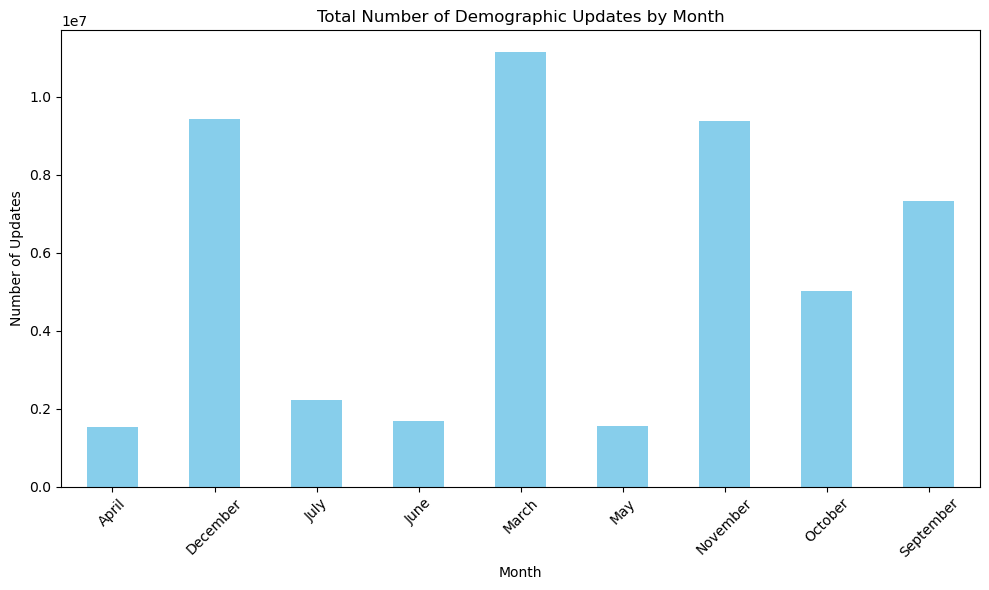

In [204]:
# Analyze monthly demographic updates
monthly_updates = demo_df.groupby('month_name')[['demo_age_5_17', 'demo_age_17_']].sum().sum(axis=1).sort_index()

# Find the month with the most updates
most_updates_month = monthly_updates.idxmax()
most_updates_count = monthly_updates.max()

print(f"The month with the most demographic updates is {most_updates_month} with {most_updates_count} updates.")

# Visualize the monthly updates
plt.figure(figsize=(10, 6))
monthly_updates.plot(kind='bar', color='skyblue')
plt.title('Total Number of Demographic Updates by Month')
plt.xlabel('Month')
plt.ylabel('Number of Updates')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Monthwise Bar Graph Biometrics Update 

The month with the most biometric updates is July with 9792552 updates.


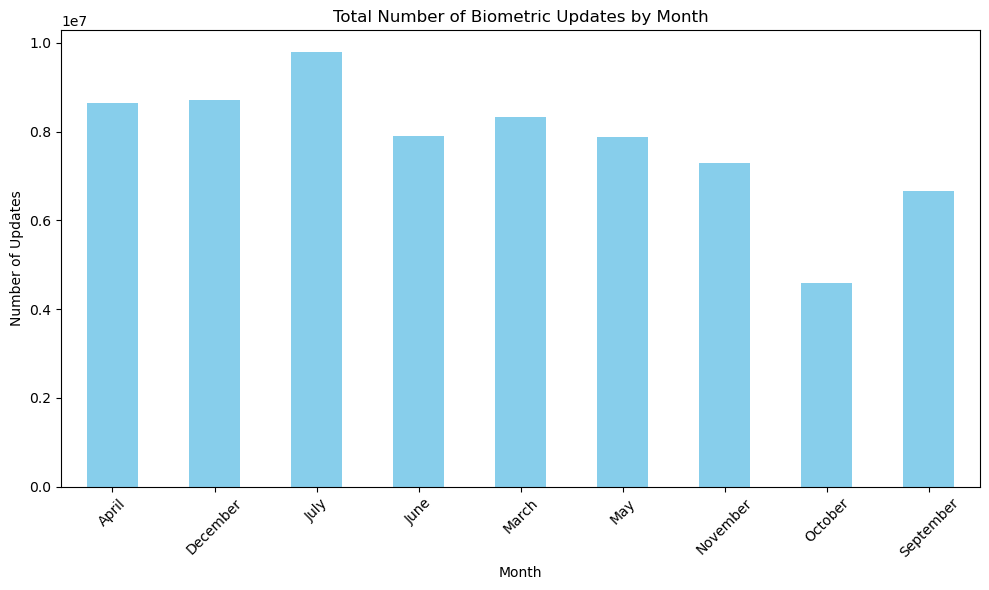

In [205]:
# Analyze monthly biometric updates
monthly_updates = biom_df.groupby('month_name')[['bio_age_5_17', 'bio_age_17_']].sum().sum(axis=1).sort_index()

# Find the month with the most updates
most_updates_month = monthly_updates.idxmax()
most_updates_count = monthly_updates.max()

print(f"The month with the most biometric updates is {most_updates_month} with {most_updates_count} updates.")

# Visualize the monthly updates
plt.figure(figsize=(10, 6))
monthly_updates.plot(kind='bar', color='skyblue')
plt.title('Total Number of Biometric Updates by Month')
plt.xlabel('Month')
plt.ylabel('Number of Updates')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Monthwise Bar Graph Enrollments

The month with the most enrollments is January with 1366494 updates.


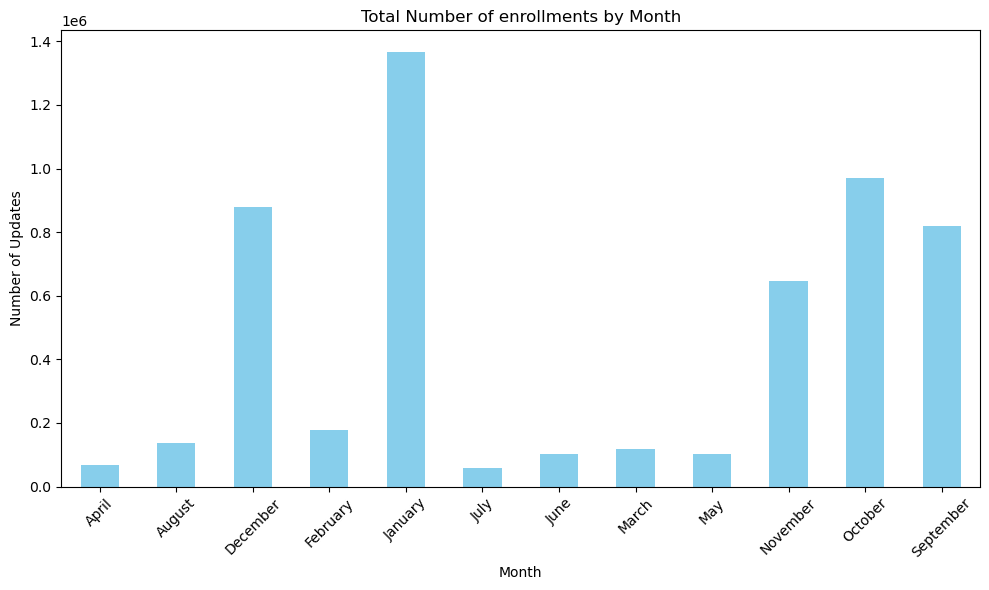

In [206]:
# Analyze monthly enrollments
monthly_updates = enrol_df.groupby('month_name')[['age_0_5', 'age_5_17','age_18_greater']].sum().sum(axis=1).sort_index()

# Find the month with the most updates
most_updates_month = monthly_updates.idxmax()
most_updates_count = monthly_updates.max()

print(f"The month with the most enrollments is {most_updates_month} with {most_updates_count} updates.")

# Visualize the monthly updates
plt.figure(figsize=(10, 6))
monthly_updates.plot(kind='bar', color='skyblue')
plt.title('Total Number of enrollments by Month')
plt.xlabel('Month')
plt.ylabel('Number of Updates')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Age wise Monthly Demographics Updates Bar Graph

Monthly sums for age groups:
            demo_age_5_17  demo_age_17_
month_name                             
April              198744       1316928
December           926183       8510581
July               288449       1932266
June               197767       1487795
March              976095      10171463
May                204893       1361394
November           821273       8566328
October            479232       4531734
September          770788       6553272


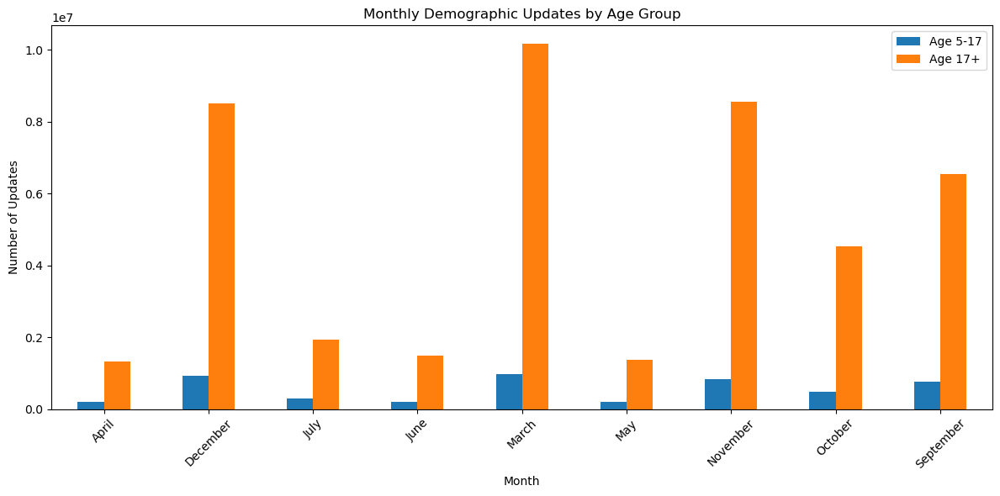

In [207]:
# Group by month and sum the age groups
monthly_age_groups = demo_df.groupby('month_name')[['demo_age_5_17', 'demo_age_17_']].sum().sort_index()

print("Monthly sums for age groups:")
print(monthly_age_groups)

# Visualize
monthly_age_groups.plot(kind='bar', figsize=(12, 6))
plt.title('Monthly Demographic Updates by Age Group')
plt.xlabel('Month')
plt.ylabel('Number of Updates')
plt.legend(['Age 5-17', 'Age 17+'])
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Age wise Monthly Biometrics Updates Bar Graph

Monthly sums for age groups:
            bio_age_5_17  bio_age_17_
month_name                           
April            4356896      4284783
December         4624160      4080148
July             4499057      5293495
June             3710149      4189140
March            3733578      4588644
May              3868247      4011709
November         3608891      3676614
October          2215380      2367275
September        3610497      3044431


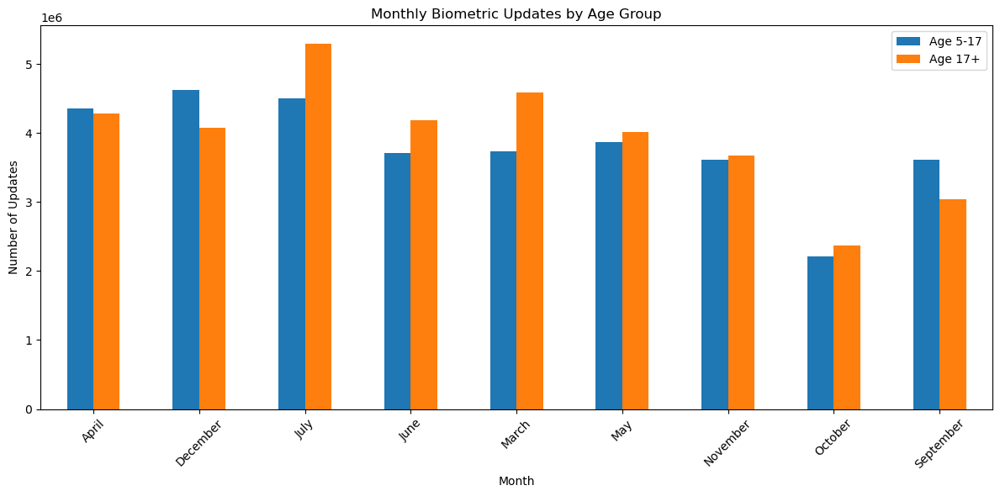

In [208]:
# Group by month and sum the age groups
monthly_age_groups = biom_df.groupby('month_name')[['bio_age_5_17', 'bio_age_17_']].sum().sort_index()

print("Monthly sums for age groups:")
print(monthly_age_groups)

# Visualize
monthly_age_groups.plot(kind='bar', figsize=(12, 6))
plt.title('Monthly Biometric Updates by Age Group')
plt.xlabel('Month')
plt.ylabel('Number of Updates')
plt.legend(['Age 5-17', 'Age 17+'])
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Age wise Monthly Enrollments Bar Graph

Monthly sums for age groups:
            age_0_5  age_5_17  age_18_greater
month_name                                   
April         43793     21728             835
August        93401     40541            1801
December     638136    222923           17759
February     122401     52971            1301
January      713903    557337           95254
July          39294     16112            1582
June          69673     30799            2070
March         73075     38207            5306
May           71641     28840            1181
November     457688    172129           15325
October      667501    283481           18222
September    556459    255315            7500


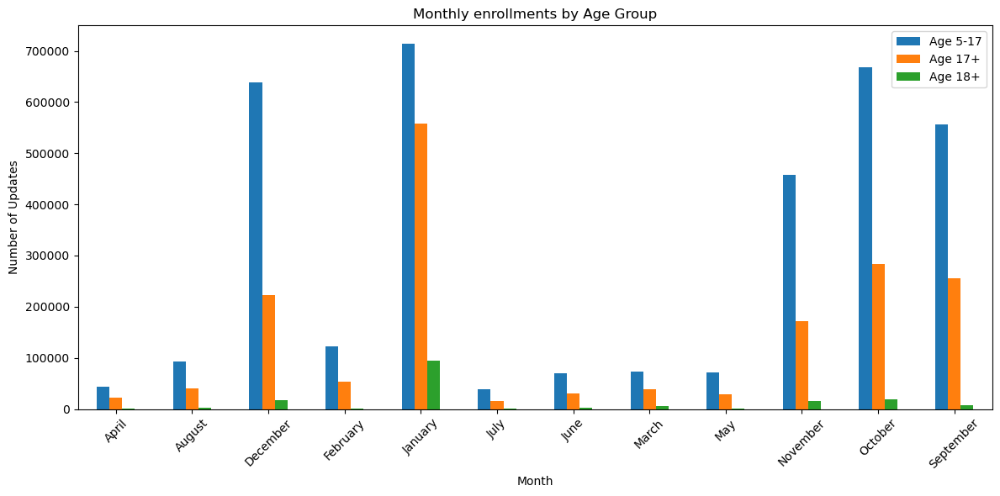

In [209]:
# Group by month and sum the age groups
monthly_age_groups = enrol_df.groupby('month_name')[['age_0_5', 'age_5_17','age_18_greater']].sum().sort_index()

print("Monthly sums for age groups:")
print(monthly_age_groups)

# Visualize
monthly_age_groups.plot(kind='bar', figsize=(12, 6))
plt.title('Monthly enrollments by Age Group')
plt.xlabel('Month')
plt.ylabel('Number of Updates')
plt.legend(['Age 5-17', 'Age 17+', 'Age 18+'])
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [210]:
enrol_df.state.value_counts()

state
Uttar Pradesh                               110369
Tamil Nadu                                   92552
Maharashtra                                  78875
West Bengal                                  76561
Karnataka                                    70198
Bihar                                        58883
Rajasthan                                    56159
Andhra Pradesh                               55893
Telangana                                    52544
Madhya Pradesh                               50225
Odisha                                       47011
Gujarat                                      46624
Kerala                                       39145
Assam                                        31827
Jharkhand                                    23218
Punjab                                       20442
Chhattisgarh                                 18550
Haryana                                      15997
Jammu And Kashmir                            11089
Himachal Pradesh         

## Total Enrollment State wise in Age group (0 - 5)

Total enrollments in age group 'age_0_5' by state:
state
Uttar Pradesh                               521045
Madhya Pradesh                              367990
Maharashtra                                 281864
West Bengal                                 275420
Bihar                                       259825
Rajasthan                                   229780
Gujarat                                     193031
Tamil Nadu                                  182313
Karnataka                                   179262
Assam                                       141235
Telangana                                   118907
Andhra Pradesh                               99456
Odisha                                       99431
Jharkhand                                    98551
Haryana                                      88042
Chhattisgarh                                 82453
Delhi                                        69183
Punjab                                       61227
Kerala                   

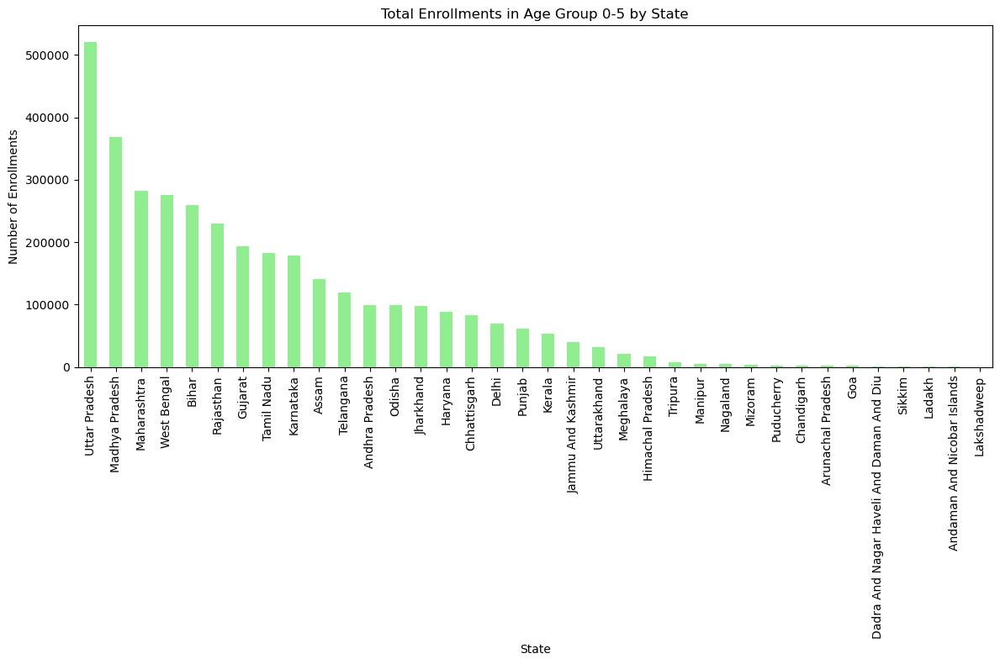

In [211]:
# Analyze enrollments in age group 'age_0_5' by state
age_0_5_by_state = enrol_df.groupby('state')['age_0_5'].sum().sort_values(ascending=False)[0:]

print("Total enrollments in age group 'age_0_5' by state:")
print(age_0_5_by_state)

# Visualize
plt.figure(figsize=(12, 8))
age_0_5_by_state.plot(kind='bar', color='lightgreen')
plt.title('Total Enrollments in Age Group 0-5 by State')
plt.xlabel('State')
plt.ylabel('Number of Enrollments')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [212]:
# demo_df.to_csv('demo_df.csv', index=False)
# biom_df.to_csv('bio_df.csv', index=False)
# enrol_df.to_csv('enrol_df.csv', index=False)

In [213]:
# demo_df = pd.read_csv('demo_df.csv')
# biom_df = pd.read_csv('bio_df.csv')
# enrol_df = pd.read_csv('enrol_df.csv')

In [214]:
enrol_df.columns

Index(['date', 'state', 'district', 'pincode', 'age_0_5', 'age_5_17',
       'age_18_greater', 'month', 'month_name'],
      dtype='object')

## Demographic updates Monthwise Line Plot

In [215]:
# Overall demographics update by month
overall_enrollments = demo_df.groupby('month_name')[['demo_age_5_17', 'demo_age_17_']].sum().sum(axis=1).reset_index()
overall_enrollments.columns = ['month_name', 'total_enrollments']

# Sort by month order
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
overall_enrollments['month_name'] = pd.Categorical(overall_enrollments['month_name'], categories=month_order, ordered=True)
overall_enrollments = overall_enrollments.sort_values('month_name')

# Line plot
fig = px.line(overall_enrollments, x='month_name', y='total_enrollments', 
              title='Overall demographics update by Month',
              labels={'month_name': 'Month', 'total_enrollments': 'Total Enrollments'})
fig.update_layout(xaxis_title='Month', yaxis_title='Total Enrollments')
fig.show()

## Biometric updates Monthwise Line Plot

In [216]:
# Overall biometrics update by month
overall_enrollments = biom_df.groupby('month_name')[['bio_age_5_17', 'bio_age_17_']].sum().sum(axis=1).reset_index()
overall_enrollments.columns = ['month_name', 'total_enrollments']

# Sort by month order
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
overall_enrollments['month_name'] = pd.Categorical(overall_enrollments['month_name'], categories=month_order, ordered=True)
overall_enrollments = overall_enrollments.sort_values('month_name')

# Line plot
fig = px.line(overall_enrollments, x='month_name', y='total_enrollments', 
              title='Overall biometrics update by Month',
              labels={'month_name': 'Month', 'total_enrollments': 'Total Enrollments'})
fig.update_layout(xaxis_title='Month', yaxis_title='Total Enrollments')
fig.show()

## Enrollments Monthwise Line Plot

In [217]:
# Overall enrollments by month
overall_enrollments = enrol_df.groupby('month_name')[['age_0_5', 'age_5_17', 'age_18_greater']].sum().sum(axis=1).reset_index()
overall_enrollments.columns = ['month_name', 'total_enrollments']

# Sort by month order
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
overall_enrollments['month_name'] = pd.Categorical(overall_enrollments['month_name'], categories=month_order, ordered=True)
overall_enrollments = overall_enrollments.sort_values('month_name')

# Line plot
fig = px.line(overall_enrollments, x='month_name', y='total_enrollments', 
              title='Overall Enrollments by Month',
              labels={'month_name': 'Month', 'total_enrollments': 'Total Enrollments'})
fig.update_layout(xaxis_title='Month', yaxis_title='Total Enrollments')
fig.show()

## Line Plot - Age wise monthly Enrollments

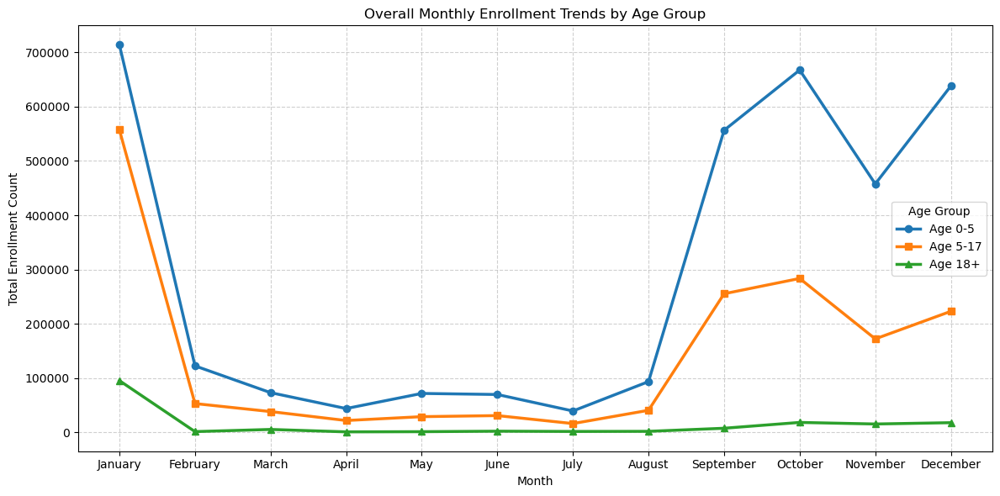

In [218]:
# Group by month and sum the counts for all age groups
monthly_trends = enrol_df.groupby(['month', 'month_name'])[['age_0_5', 'age_5_17', 'age_18_greater']].sum().reset_index()

# Sort by month to ensure chronological order
monthly_trends = monthly_trends.sort_values('month')

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(monthly_trends['month_name'], monthly_trends['age_0_5'], marker='o', label='Age 0-5', linewidth=2.5)
plt.plot(monthly_trends['month_name'], monthly_trends['age_5_17'], marker='s', label='Age 5-17', linewidth=2.5)
plt.plot(monthly_trends['month_name'], monthly_trends['age_18_greater'], marker='^', label='Age 18+', linewidth=2.5)

plt.title('Overall Monthly Enrollment Trends by Age Group')
plt.xlabel('Month')
plt.ylabel('Total Enrollment Count')
plt.legend(title='Age Group')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

## Population Based Analysis

### Densely/Sparsely Populated States - % of Age wise Enrollments

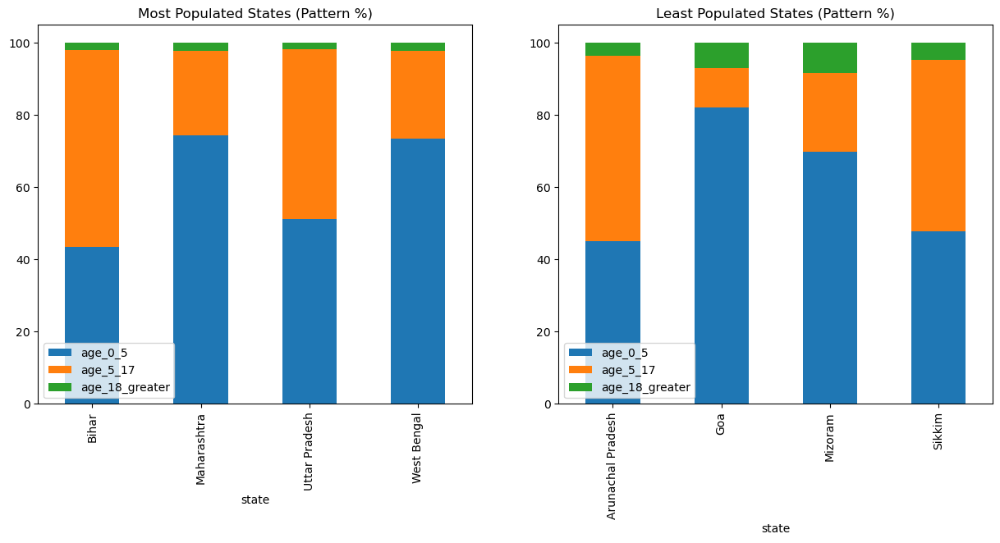

In [219]:
# Defining States based on current (2024/2025) Population Rankings
most_populated = ['Uttar Pradesh', 'Bihar', 'Maharashtra', 'West Bengal']
least_populated = ['Sikkim', 'Mizoram', 'Arunachal Pradesh', 'Goa']

# Aggregating and Calculating Percentages for Patterns
def get_patterns(state_list):
    subset = enrol_df[enrol_df['state'].isin(state_list)]
    agg = subset.groupby('state')[['age_0_5', 'age_5_17', 'age_18_greater']].sum()
    return agg.div(agg.sum(axis=1), axis=0) * 100

most_pop_patterns = get_patterns(most_populated)
least_pop_patterns = get_patterns(least_populated)

# Visualization
fig, axes = plt.subplots(1, 2, figsize=(15, 6))
most_pop_patterns.plot(kind='bar', stacked=True, ax=axes[0], title='Most Populated States (Pattern %)')
least_pop_patterns.plot(kind='bar', stacked=True, ax=axes[1], title='Least Populated States (Pattern %)')
plt.show()

### Age wise Monthly Enrollments in Most/Least Populated States

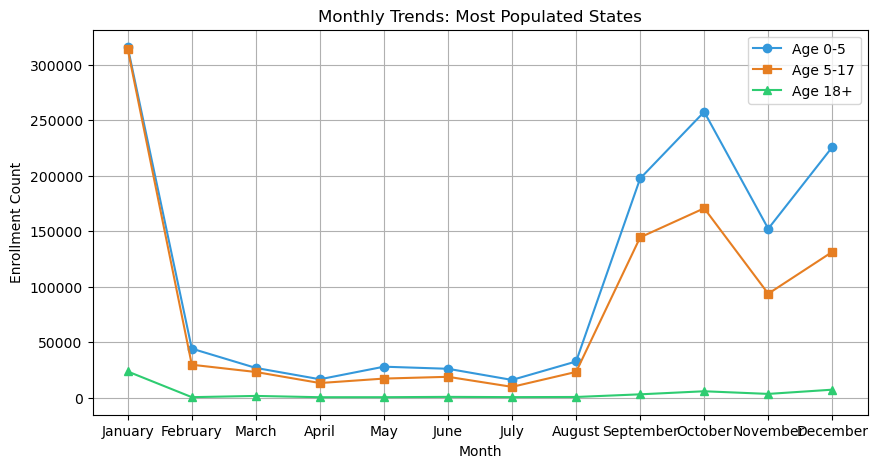

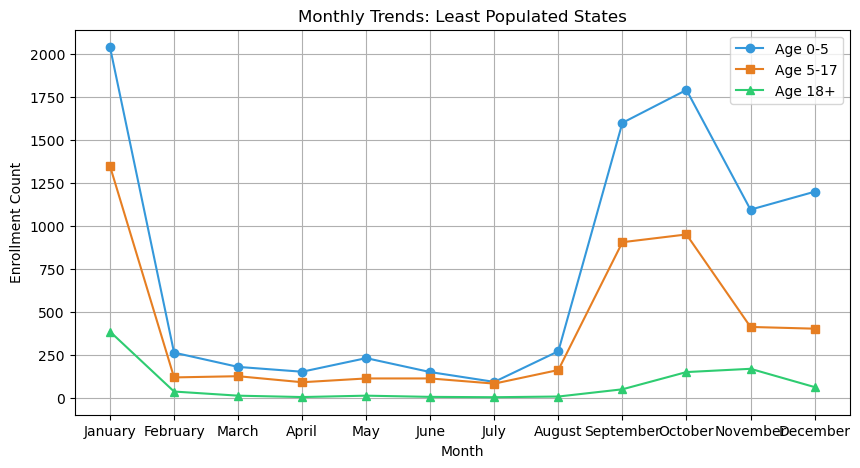

In [220]:
# Define state groups based on current population
most_pop = ['Uttar Pradesh', 'Bihar', 'Maharashtra', 'West Bengal']
least_pop = ['Sikkim', 'Mizoram', 'Arunachal Pradesh', 'Goa']

# Prepare data function
def get_pop_trend(states):
    subset = enrol_df[enrol_df['state'].isin(states)]
    return subset.groupby(['month', 'month_name'])[['age_0_5', 'age_5_17', 'age_18_greater']].sum().reset_index().sort_values('month')

most_pop_trend = get_pop_trend(most_pop)
least_pop_trend = get_pop_trend(least_pop)

# Plotting function
def plot_pop_trend(data, title):
    plt.figure(figsize=(10, 5))
    plt.plot(data['month_name'], data['age_0_5'], marker='o', label='Age 0-5', color='#3498db')
    plt.plot(data['month_name'], data['age_5_17'], marker='s', label='Age 5-17', color='#e67e22')
    plt.plot(data['month_name'], data['age_18_greater'], marker='^', label='Age 18+', color='#2ecc71')
    plt.title(title)
    plt.xlabel('Month')
    plt.ylabel('Enrollment Count')
    plt.legend()
    plt.grid(True)
    plt.show()

# Visualize
plot_pop_trend(most_pop_trend, 'Monthly Trends: Most Populated States')
plot_pop_trend(least_pop_trend, 'Monthly Trends: Least Populated States')

## Literacy Based Analysis

### Literate/Less Literate States - % of Age wise Enrollments

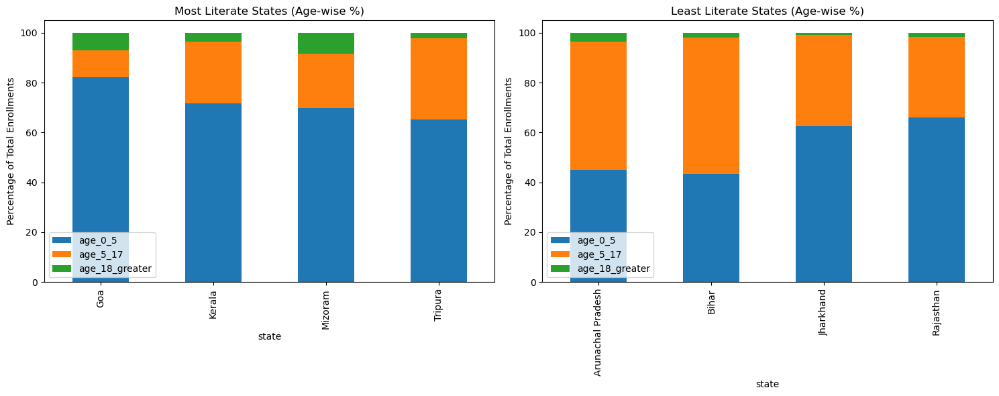

In [221]:
# Define groups based on real-world literacy rankings
most_literate = ['Kerala', 'Mizoram', 'Goa', 'Tripura']
least_literate = ['Bihar', 'Arunachal Pradesh', 'Rajasthan', 'Jharkhand']

# Function to extract age-wise distribution percentage
def get_literacy_patterns(state_list):
    subset = enrol_df[enrol_df['state'].isin(state_list)]
    agg = subset.groupby('state')[['age_0_5', 'age_5_17', 'age_18_greater']].sum()
    # Convert to percentage for relative pattern analysis
    return agg.div(agg.sum(axis=1), axis=0) * 100

most_lit_pct = get_literacy_patterns(most_literate)
least_lit_pct = get_literacy_patterns(least_literate)

# Visualization
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

most_lit_pct.plot(kind='bar', stacked=True, ax=axes[0], title='Most Literate States (Age-wise %)')
axes[0].set_ylabel('Percentage of Total Enrollments')

least_lit_pct.plot(kind='bar', stacked=True, ax=axes[1], title='Least Literate States (Age-wise %)')
axes[1].set_ylabel('Percentage of Total Enrollments')

plt.tight_layout()
plt.show()

### Age wise Monthly Enrollments in Most/Least Literate States

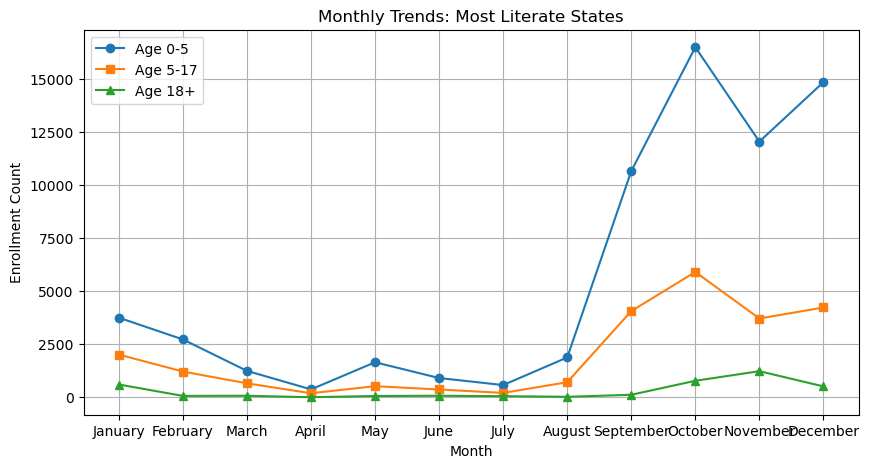

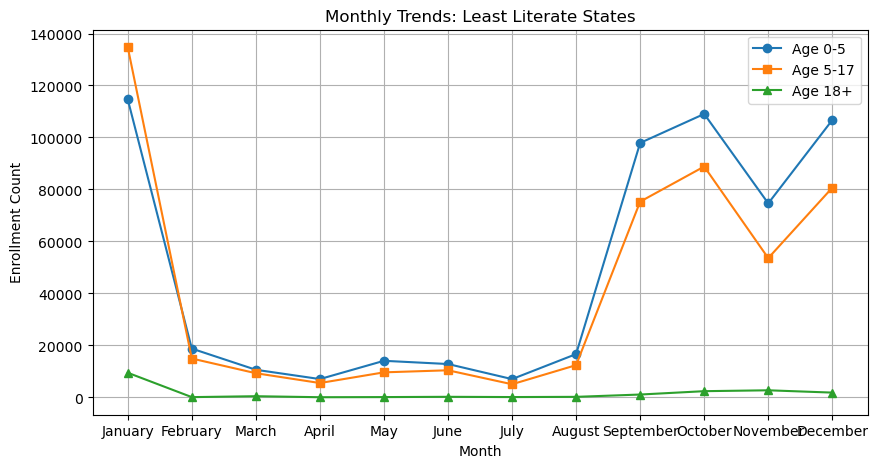

In [222]:
# Define state groups
most_lit = ['Kerala', 'Mizoram', 'Goa', 'Tripura']
least_lit = ['Bihar', 'Arunachal Pradesh', 'Rajasthan', 'Jharkhand']

# Prepare data function
def get_trend(states):
    subset = enrol_df[enrol_df['state'].isin(states)]
    return subset.groupby(['month', 'month_name'])[['age_0_5', 'age_5_17', 'age_18_greater']].sum().reset_index().sort_values('month')

most_trend = get_trend(most_lit)
least_trend = get_trend(least_lit)

# Plotting Function
def plot_trend(data, title):
    plt.figure(figsize=(10, 5))
    plt.plot(data['month_name'], data['age_0_5'], marker='o', label='Age 0-5')
    plt.plot(data['month_name'], data['age_5_17'], marker='s', label='Age 5-17')
    plt.plot(data['month_name'], data['age_18_greater'], marker='^', label='Age 18+')
    plt.title(title)
    plt.xlabel('Month')
    plt.ylabel('Enrollment Count')
    plt.legend()
    plt.grid(True)
    plt.show()

# Generate Plots
plot_trend(most_trend, 'Monthly Trends: Most Literate States')
plot_trend(least_trend, 'Monthly Trends: Least Literate States')

## Top 10 Districts with most enrollments per state

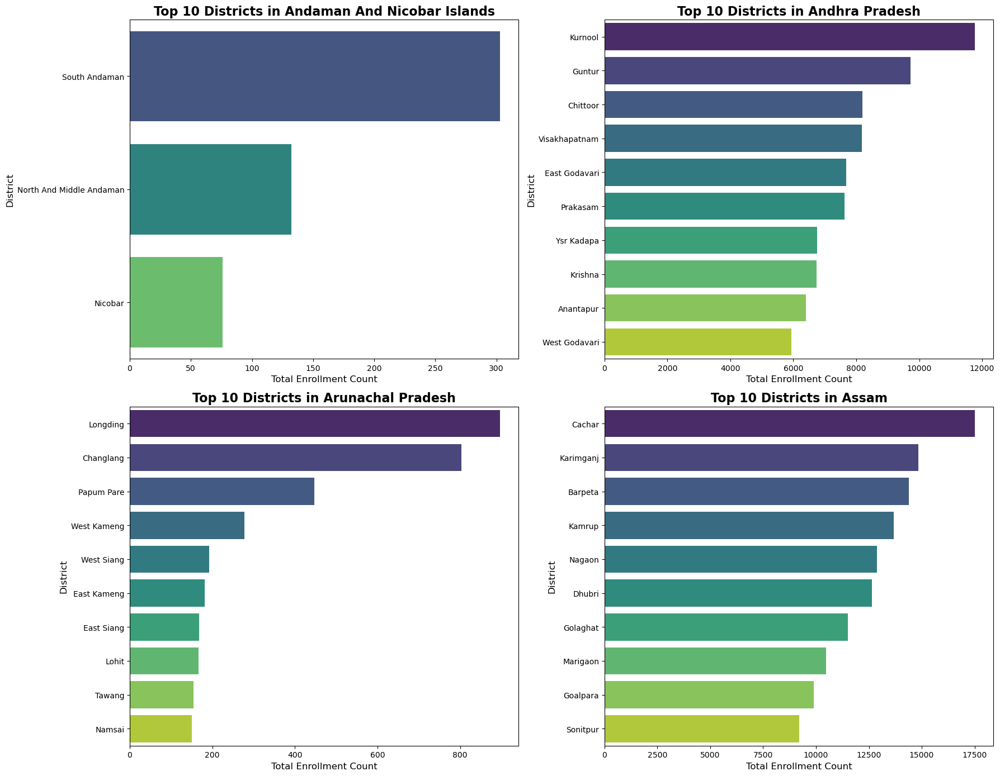

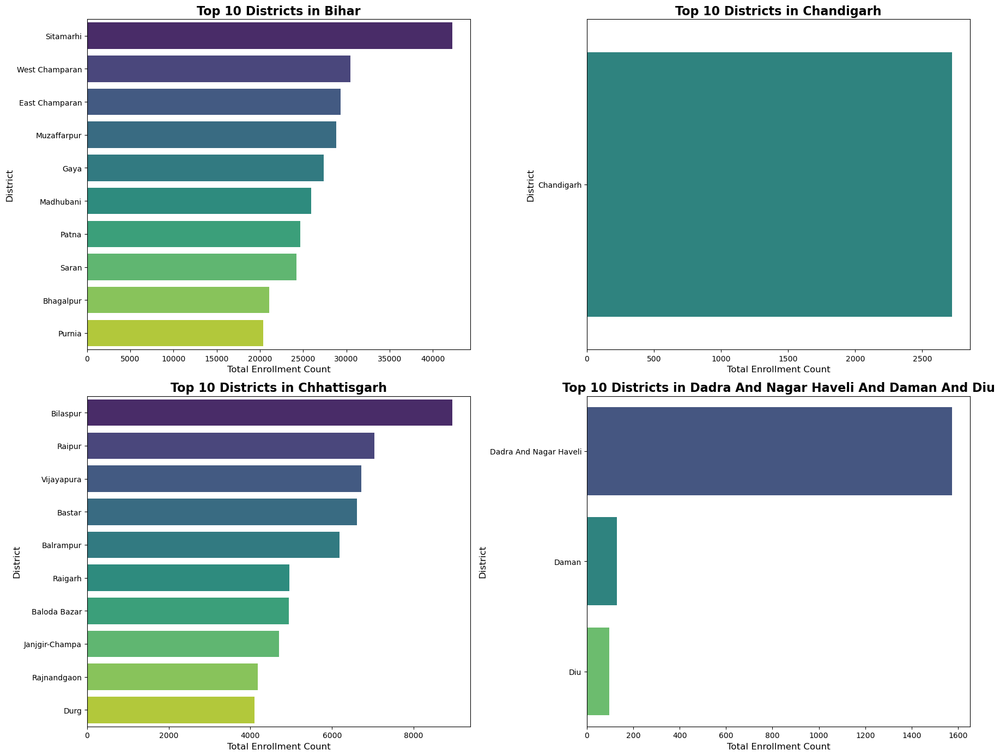

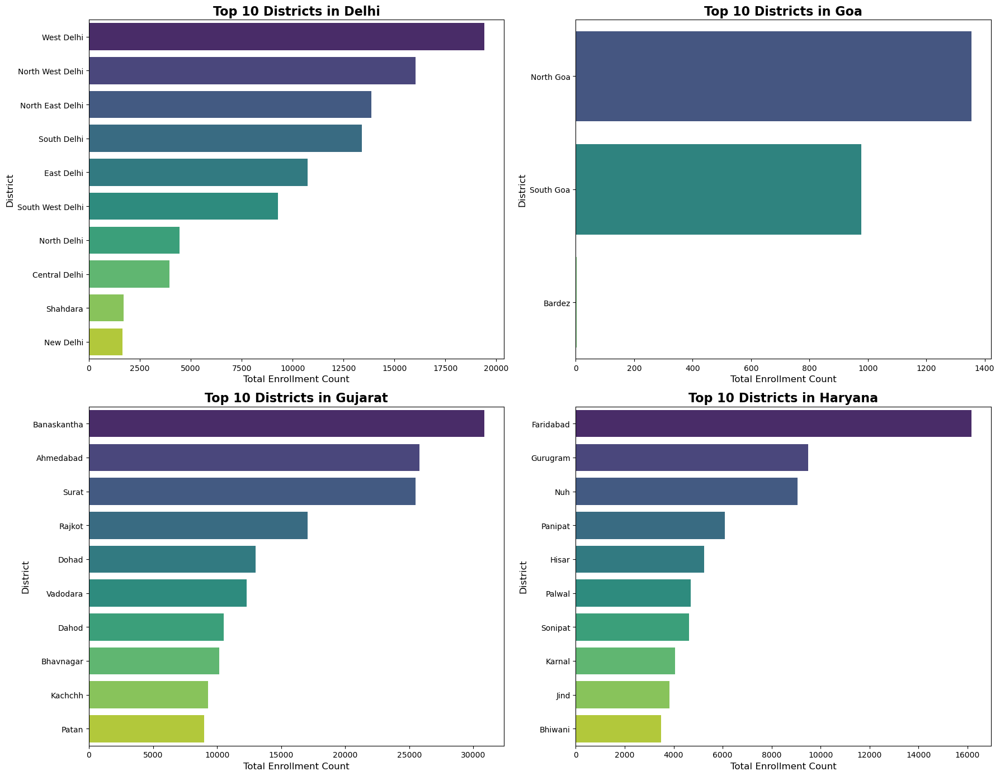

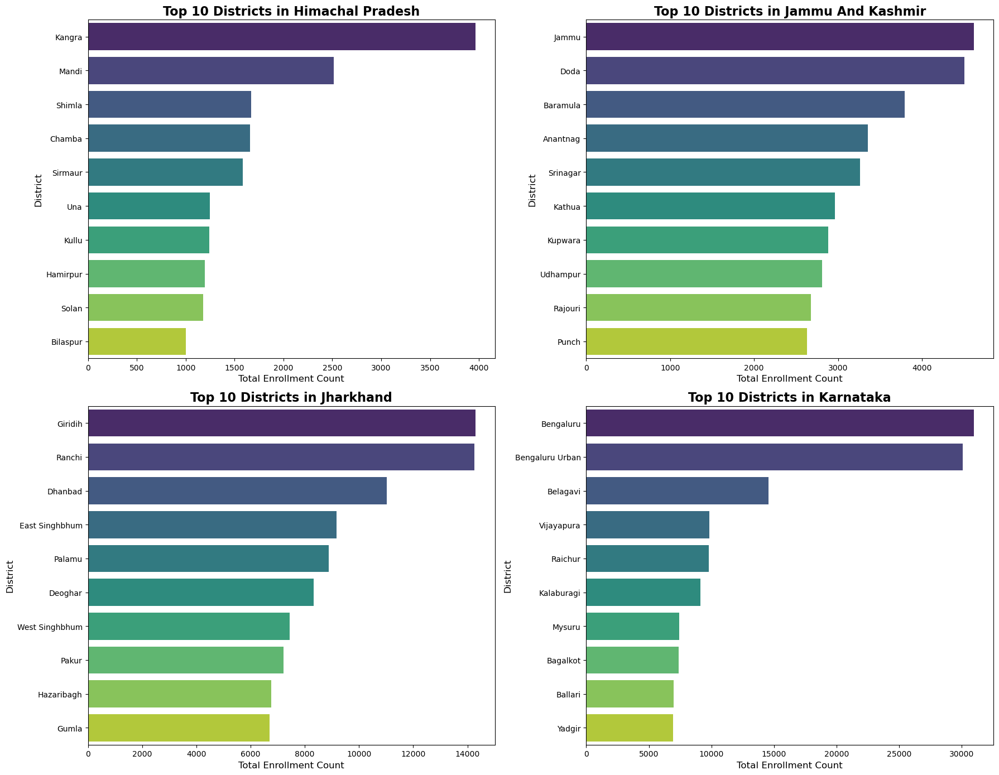

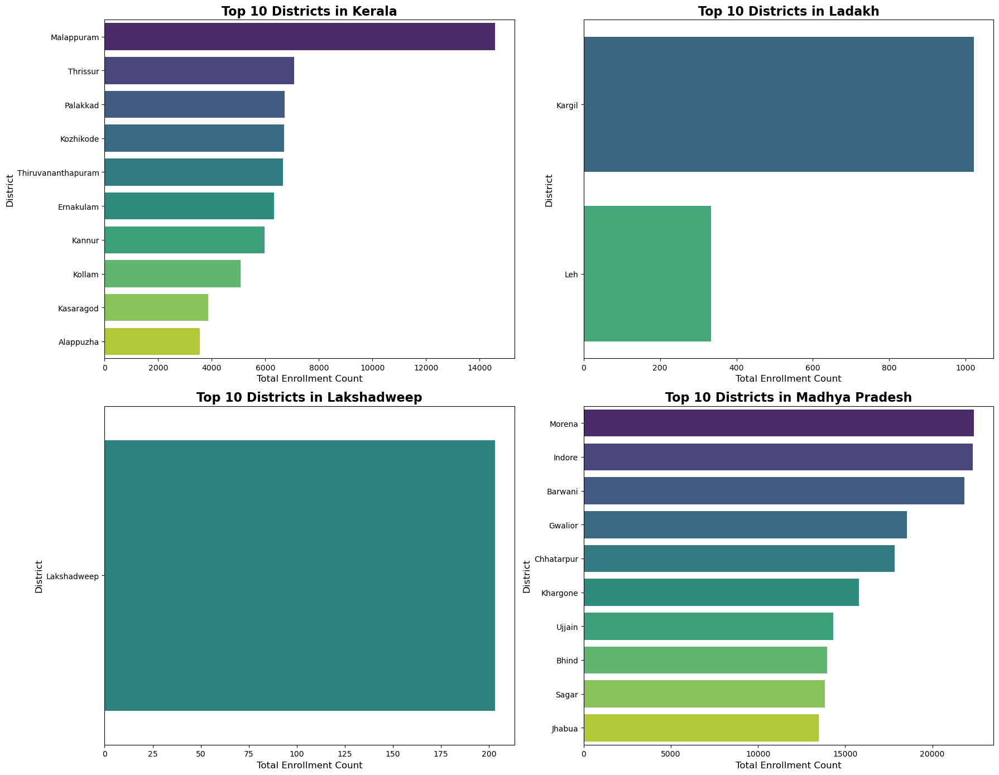

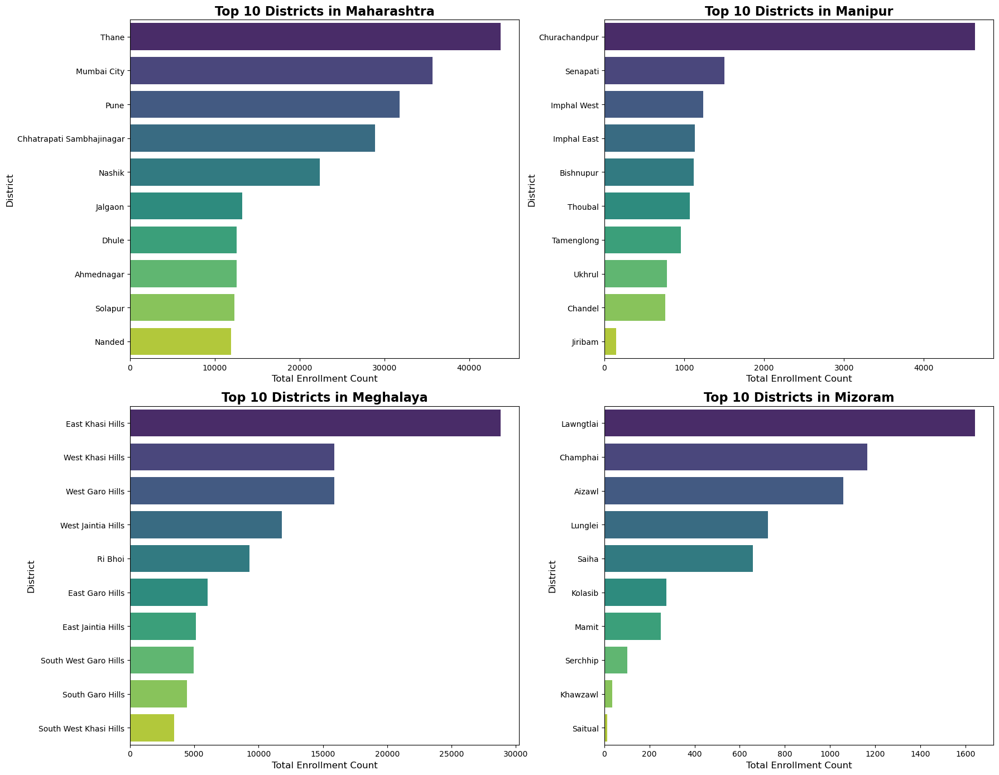

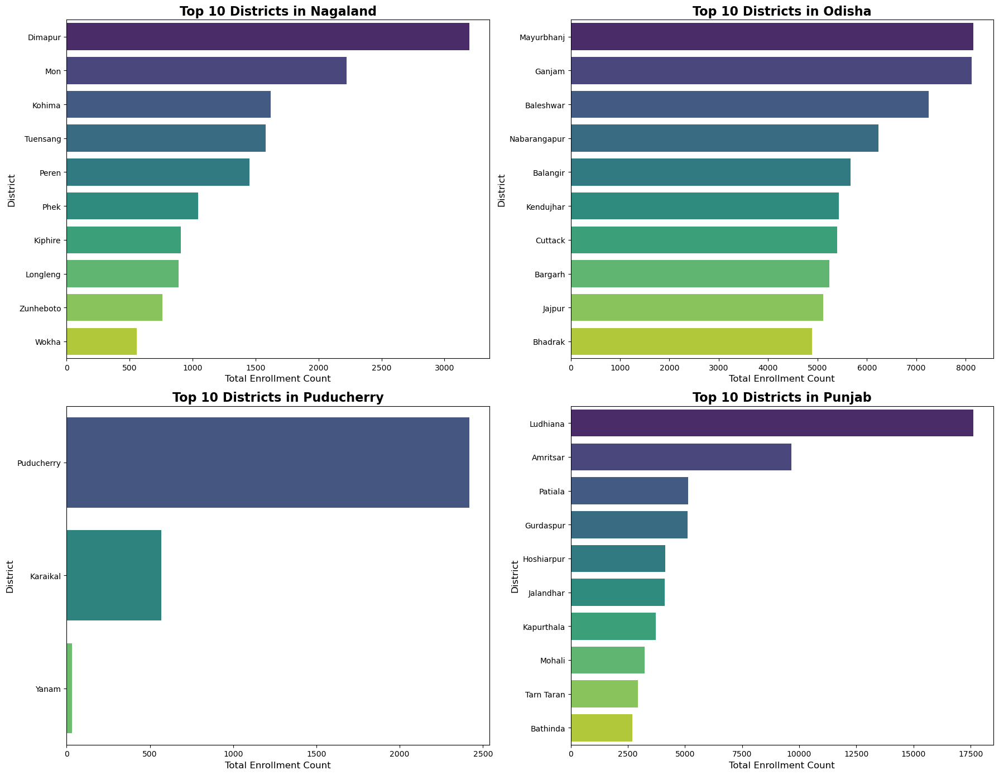

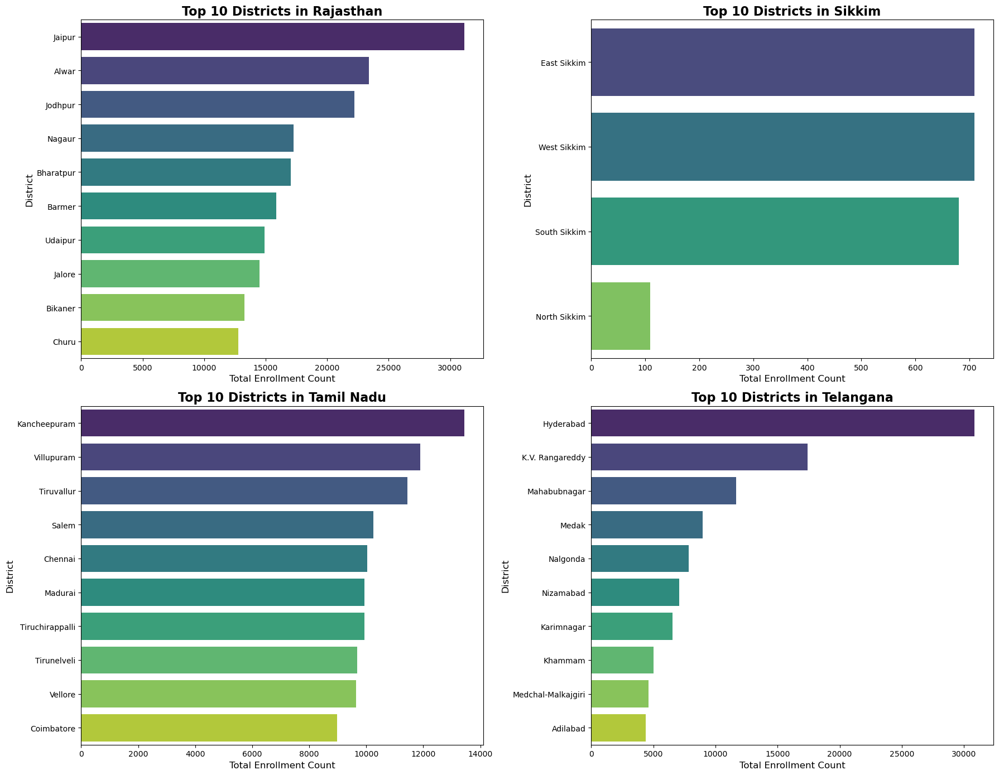

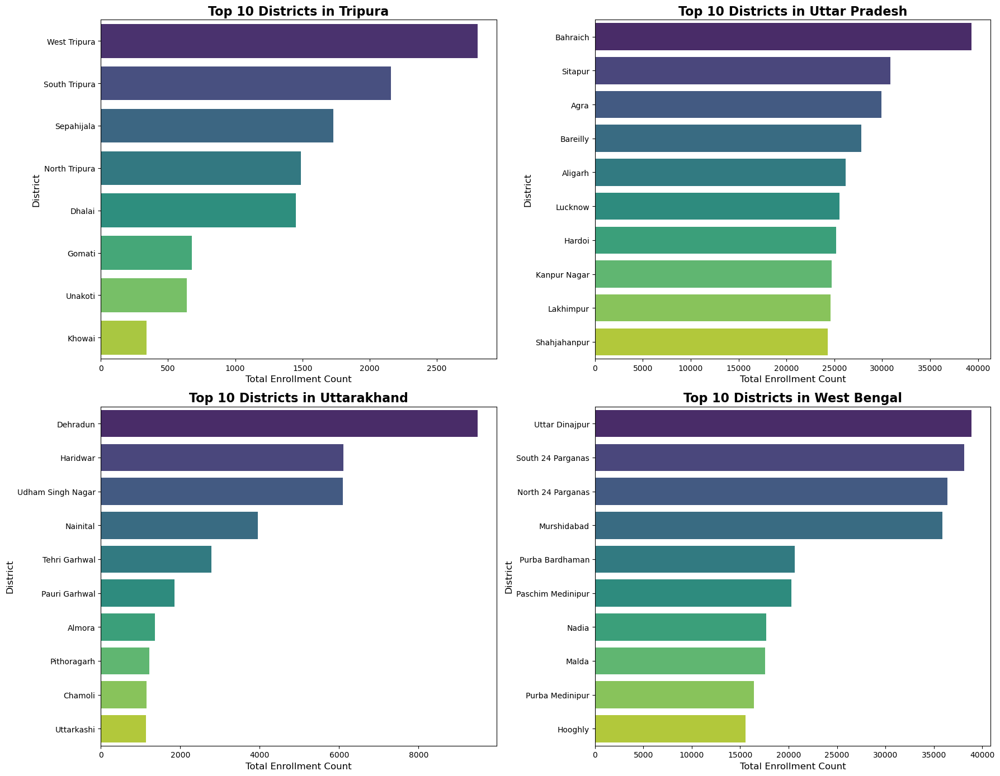

Analysis Complete. 9 batch images generated.


In [223]:
import math
enrol_df['total_enrollment'] = enrol_df['age_0_5'] + enrol_df['age_5_17'] + enrol_df['age_18_greater']

# 3. Aggregation
district_agg = enrol_df.groupby(['state', 'district'])['total_enrollment'].sum().reset_index()

# 4. Filter for Top 10
top_10_per_state = district_agg.groupby('state').apply(
    lambda x: x.nlargest(10, 'total_enrollment')
).reset_index(drop=True)

# 5. Visualization Setup
states = sorted(top_10_per_state['state'].unique())
num_states = len(states)
states_per_fig = 4  # Number of states to show in one image (2x2 grid)
num_figs = math.ceil(num_states / states_per_fig)

# 6. Plotting Loop
for i in range(num_figs):
    start_idx = i * states_per_fig
    end_idx = min((i + 1) * states_per_fig, num_states)
    current_states = states[start_idx:end_idx]
    
    # Initialize a 2x2 subplot grid
    fig, axes = plt.subplots(2, 2, figsize=(18, 14))
    axes = axes.flatten()
    
    for j, state in enumerate(current_states):
        # Get data for the specific state
        state_data = top_10_per_state[top_10_per_state['state'] == state].sort_values('total_enrollment', ascending=False)
        
        # Create the bar chart
        sns.barplot(data=state_data, x='total_enrollment', y='district', ax=axes[j], palette='viridis')
        
        # Formatting the chart
        axes[j].set_title(f'Top 10 Districts in {state}', fontsize=16, fontweight='bold')
        axes[j].set_xlabel('Total Enrollment Count', fontsize=12)
        axes[j].set_ylabel('District', fontsize=12)
        
    # Remove any empty subplots in the final batch
    for k in range(len(current_states), 4):
        fig.delaxes(axes[k])
        
    plt.tight_layout()
    plt.savefig(f'top_districts_batch_{i+1}.png')
    plt.show()

print(f"Analysis Complete. {num_figs} batch images generated.")

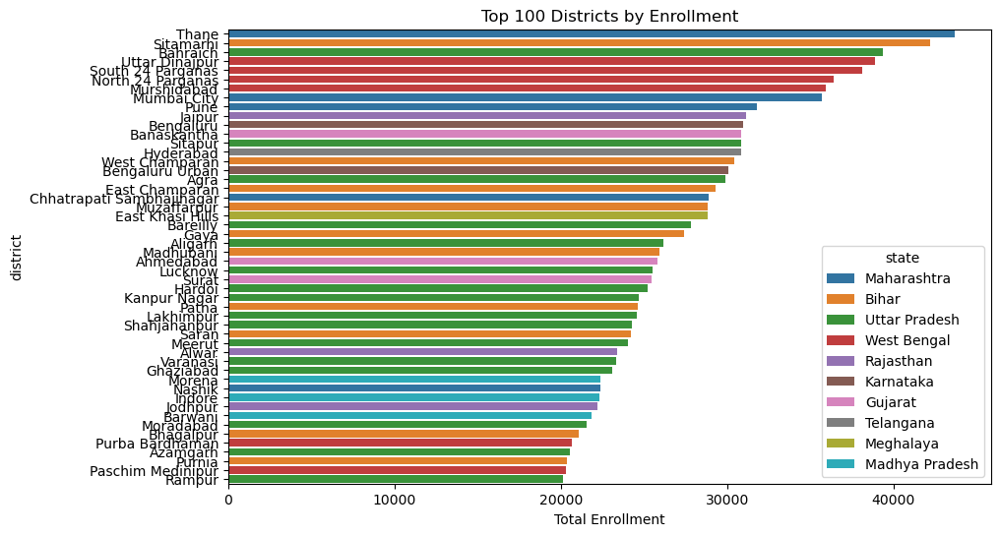

In [224]:
import seaborn as sns
enrol_df['total_enrollment'] = enrol_df['age_0_5'] + enrol_df['age_5_17'] + enrol_df['age_18_greater']

# Grouping by district
district_data = enrol_df.groupby(['district', 'state'])['total_enrollment'].sum().reset_index()
top_30 = district_data.sort_values(by='total_enrollment', ascending=False).head(50)

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(data=top_30, x='total_enrollment', y='district', hue='state', dodge=False)
plt.title('Top 100 Districts by Enrollment')
plt.xlabel('Total Enrollment')
plt.show()

In [225]:
month_order = [
    "January","February","March", "April", "May", "June",
    "July", "August", "September",
    "October", "November", "December"
]

# Convert month_name to ordered categorical
enrol_df["month_name"] = pd.Categorical(
    enrol_df["month_name"],
    categories=month_order,
    ordered=True
)

def plot_state_district_trends(state_name):

    # 1. Total enrollment
    enrol_df["total_enrollment"] = (
        enrol_df["age_0_5"] +
        enrol_df["age_5_17"] +
        enrol_df["age_18_greater"]
    )

    # 2. Aggregate total enrollment by state & district
    district_agg = (
        enrol_df.groupby(["state", "district"])["total_enrollment"]
        .sum()
        .reset_index()
    )

    # 3. Select top 10 districts for the given state
    top_districts_state = (
        district_agg[district_agg["state"] == state_name]
        .nlargest(10, "total_enrollment")
    )

    # 4. Monthly aggregation (IMPORTANT: keep month order)
    monthly = (
        enrol_df.groupby(
            ["district", "month_name"],
            observed=False
        )[["age_0_5", "age_5_17", "age_18_greater"]]
        .sum()
        .reset_index()
        .sort_values("month_name")
    )

    fig, axes = plt.subplots(5, 2, figsize=(18, 22))
    fig.suptitle(f"District Trends in {state_name}", fontsize=20)
    axes = axes.flatten()

    for i, dist in enumerate(top_districts_state["district"].values):
        data = monthly[monthly["district"] == dist]

        ax = axes[i]
        ax.plot(data["month_name"], data["age_0_5"], marker="o", label="0-5")
        ax.plot(data["month_name"], data["age_5_17"], marker="s", label="5-17")
        ax.plot(data["month_name"], data["age_18_greater"], marker="^", label="18+")

        ax.set_title(f"District: {dist}")
        ax.set_xlabel("Month")
        ax.set_ylabel("Enrollment")
        ax.legend()
        ax.grid(True, alpha=0.3)

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

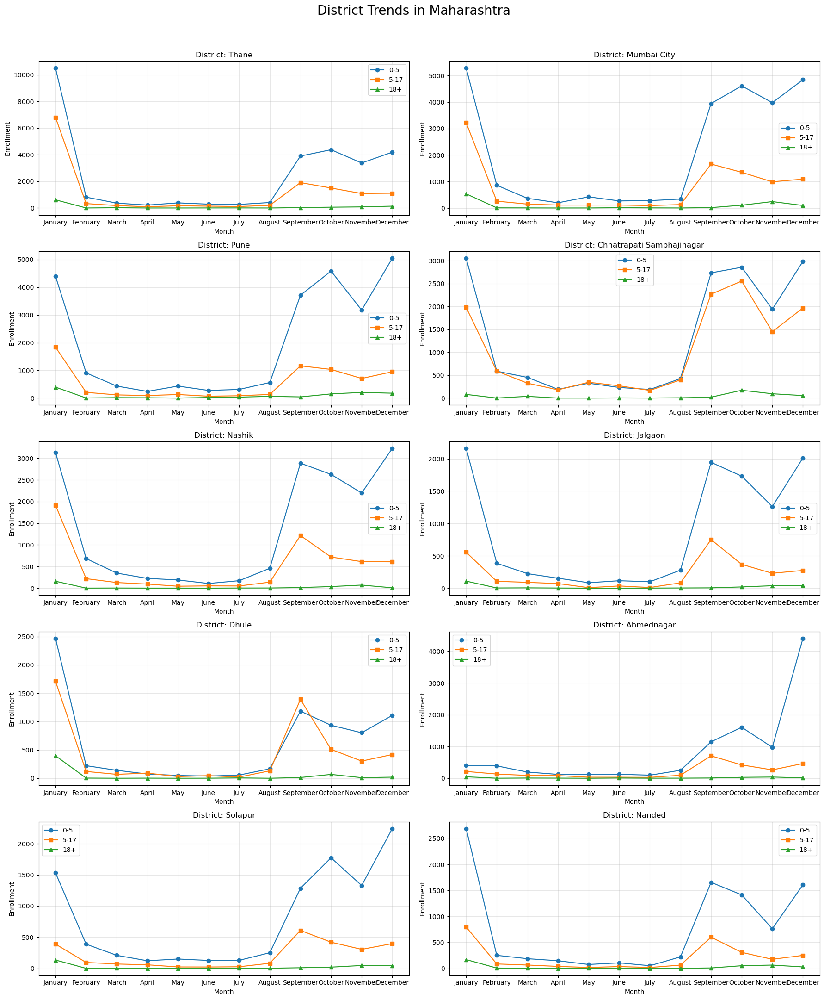

In [226]:
plot_state_district_trends("Maharashtra")

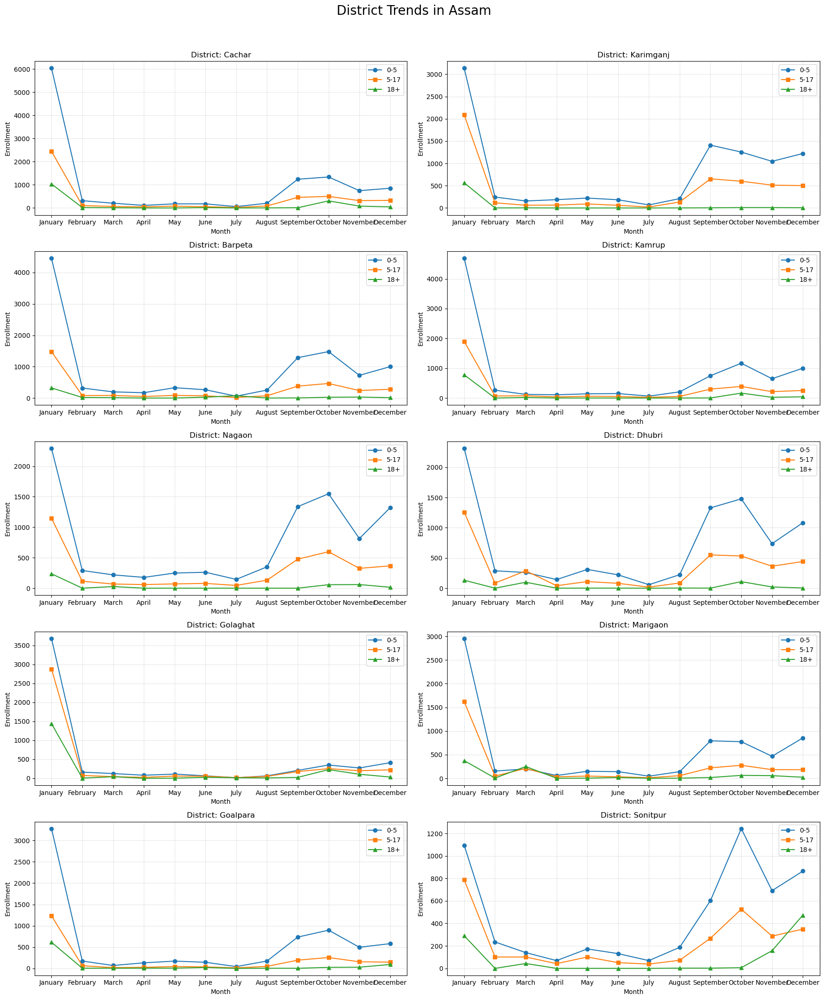

In [227]:
plot_state_district_trends("Assam")

## Bottom 10 Districts with most enrollments per state

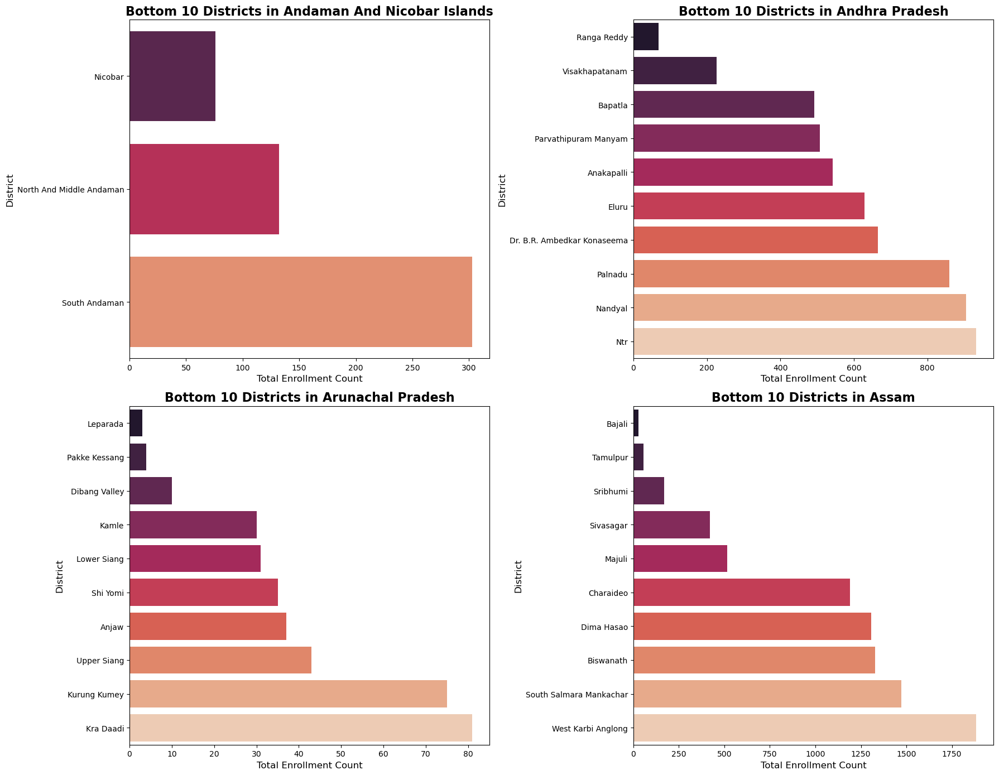

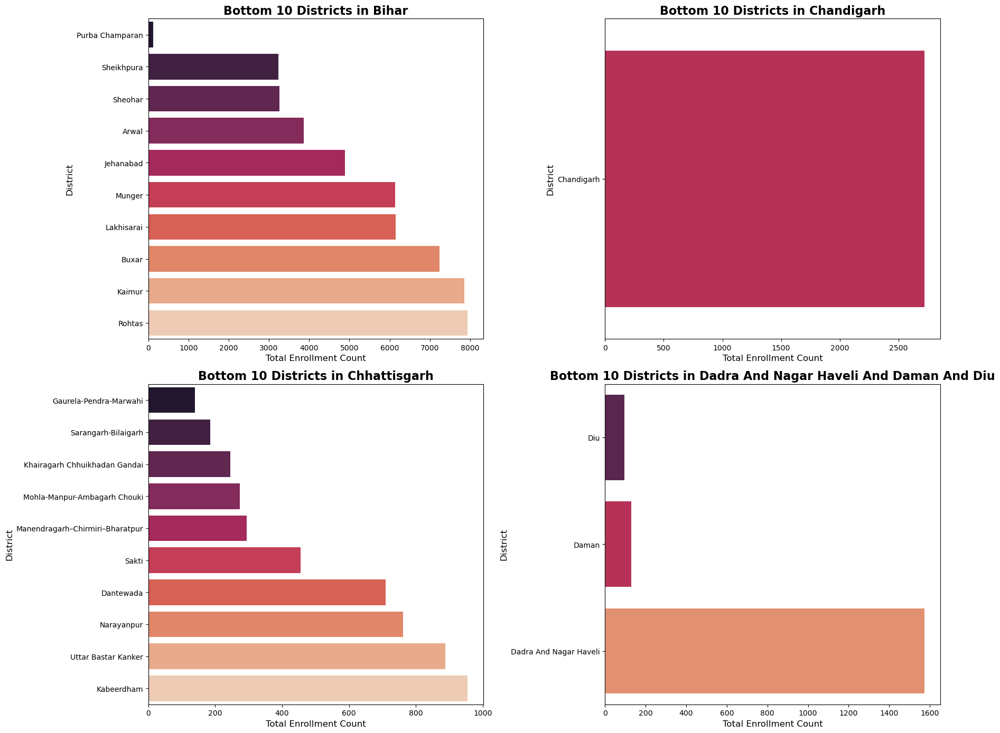

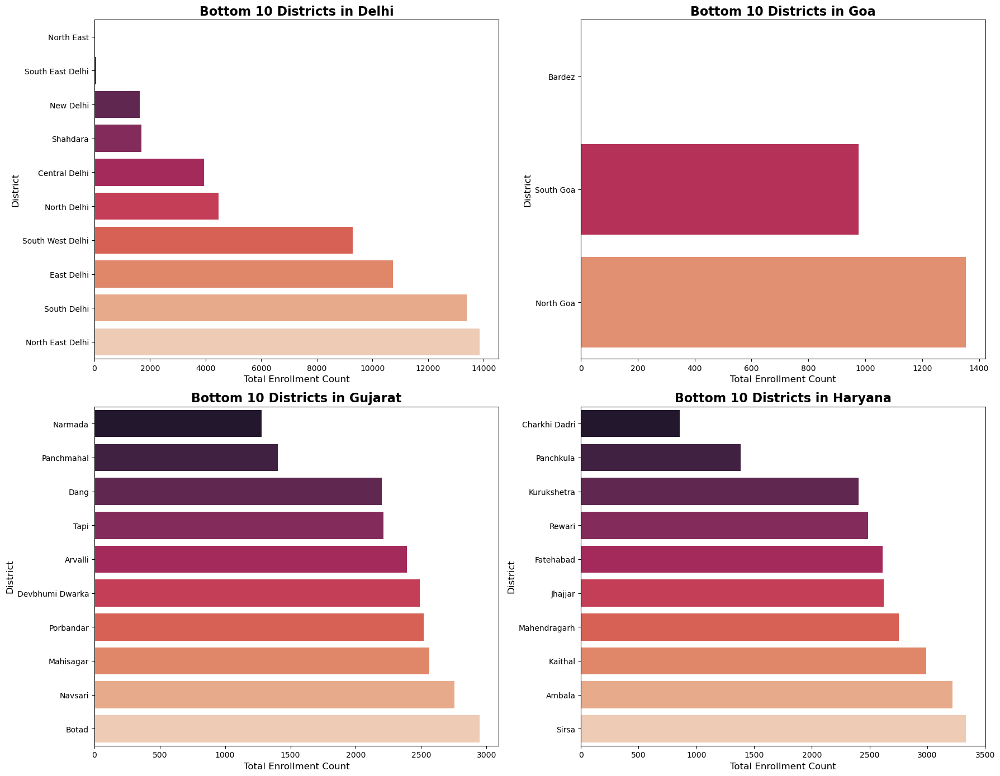

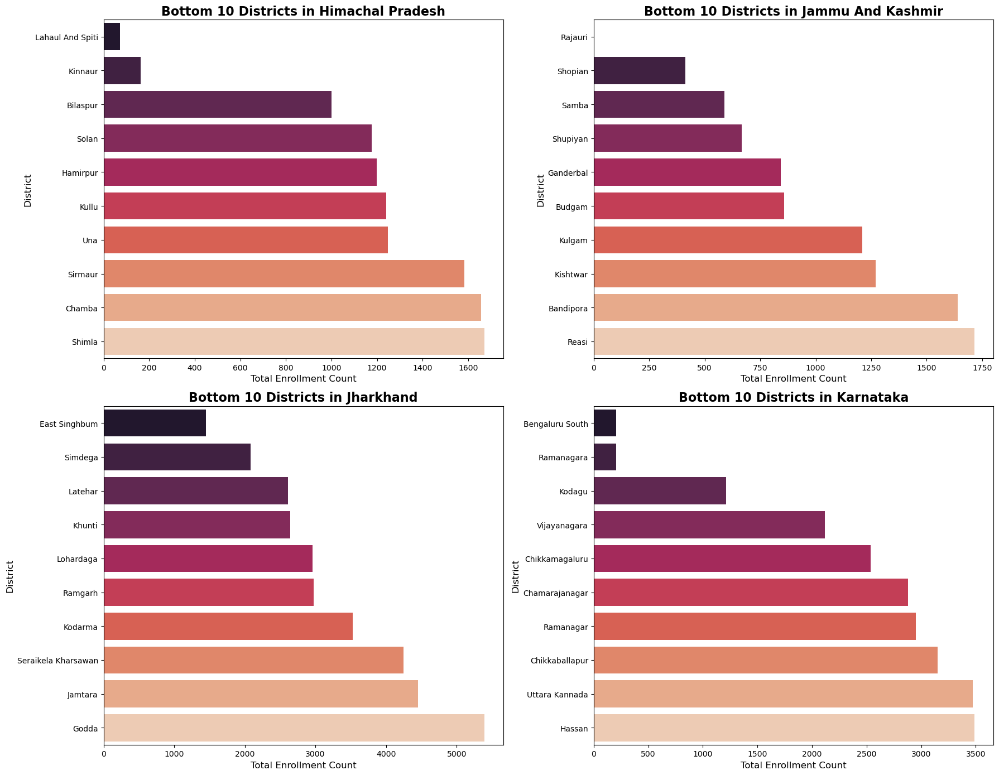

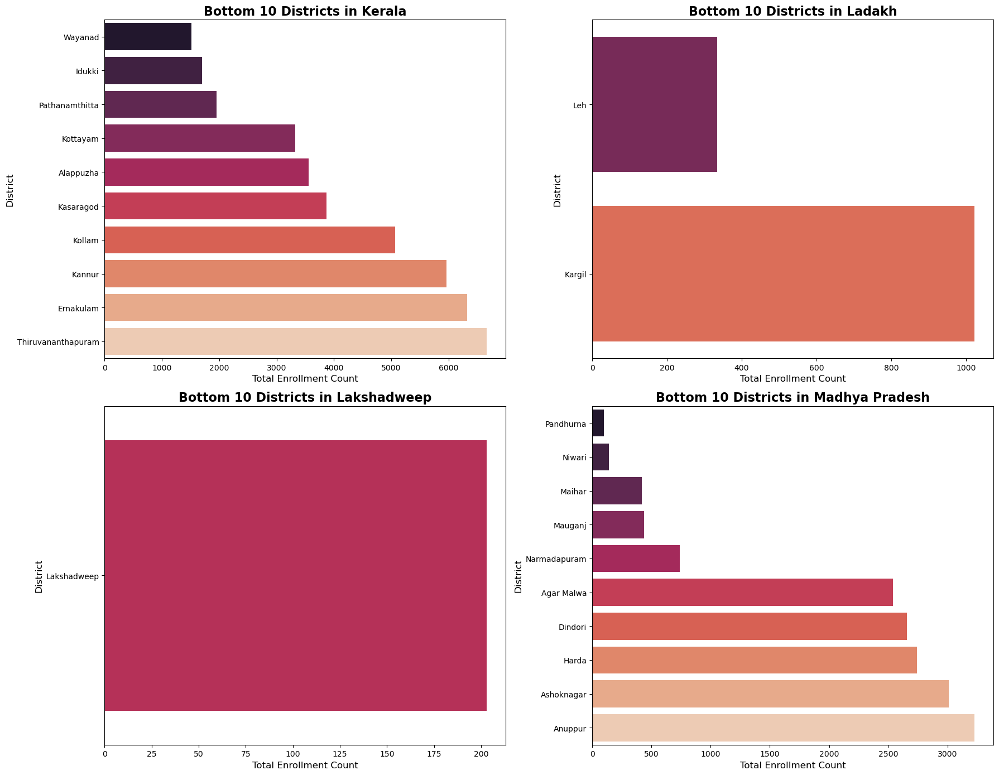

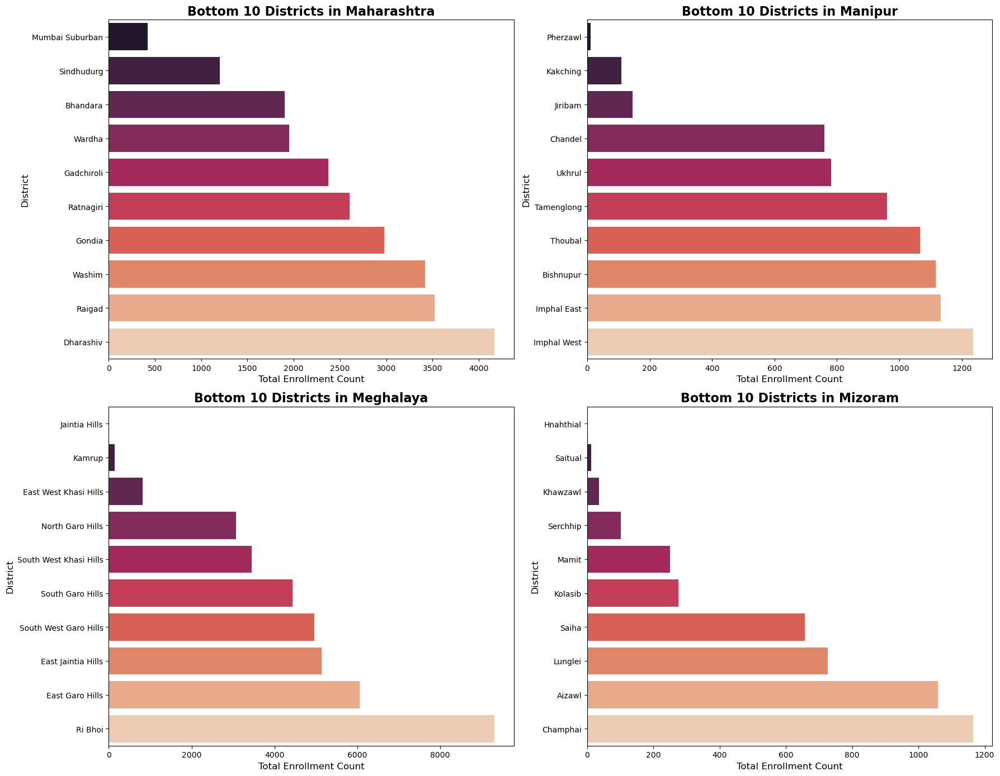

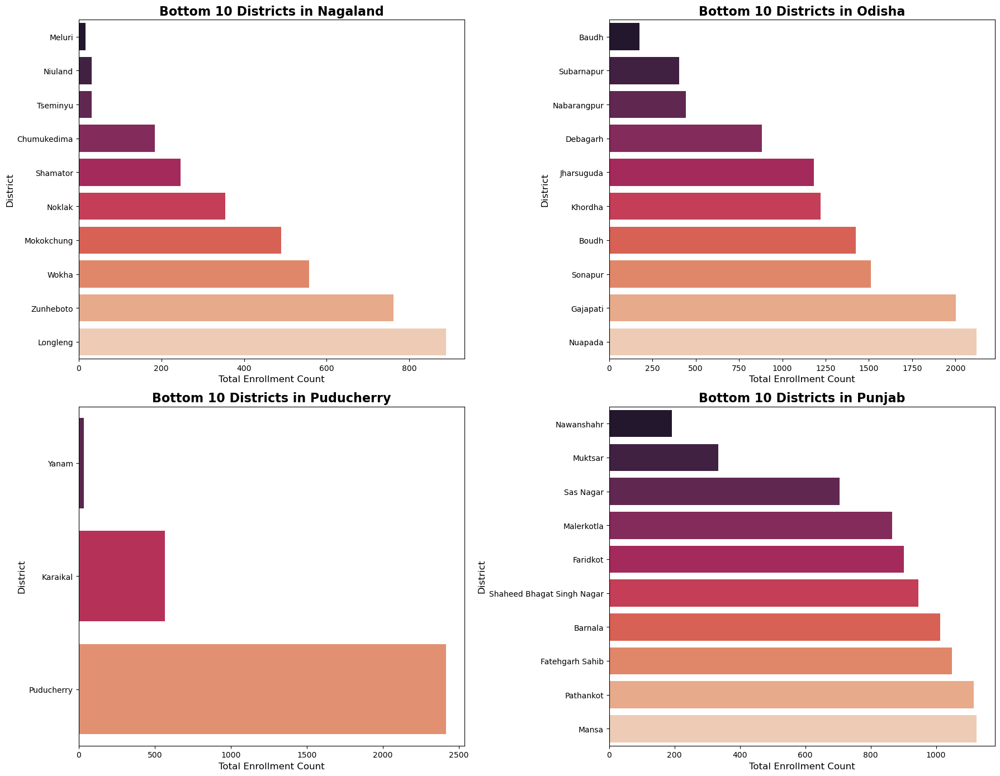

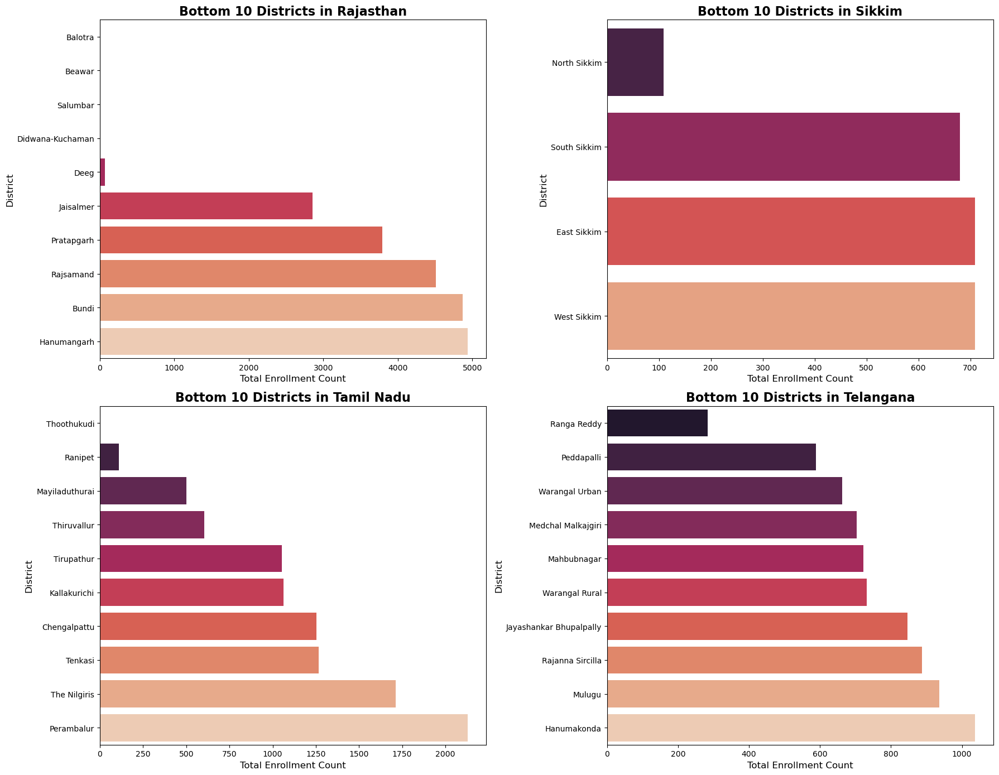

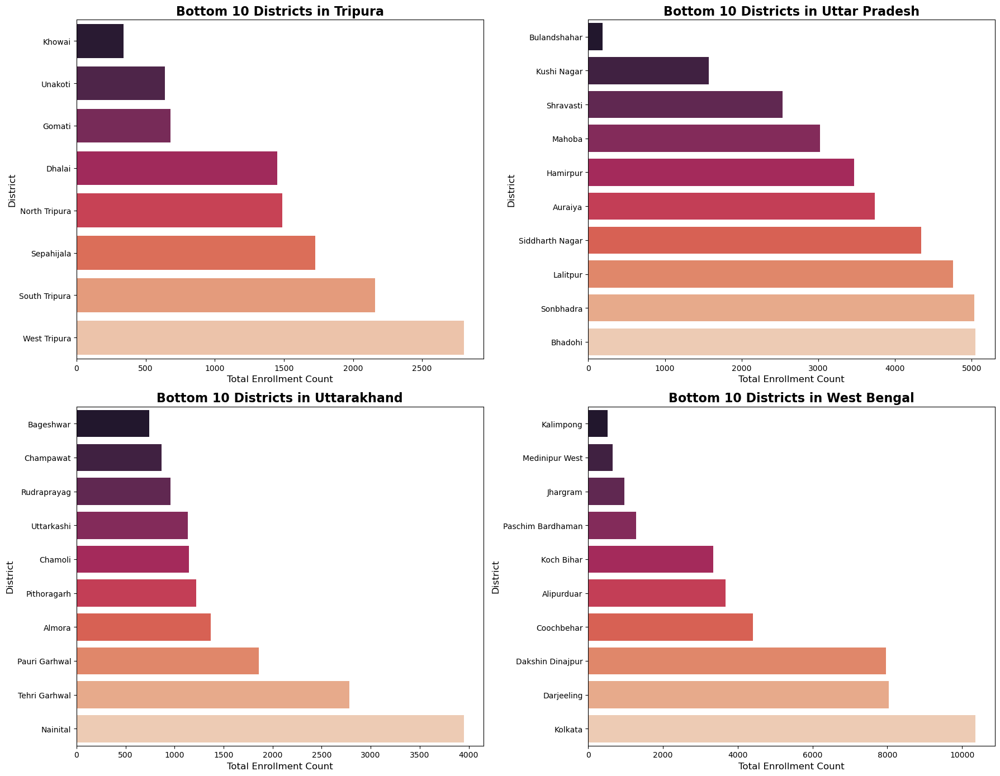

Analysis Complete. 9 batch images generated.


In [228]:
# 2. Pre-processing
enrol_df['total_enrollment'] = enrol_df['age_0_5'] + enrol_df['age_5_17'] + enrol_df['age_18_greater']

# 3. Aggregation
district_agg = enrol_df.groupby(['state', 'district'])['total_enrollment'].sum().reset_index()

# 4. Filter for Bottom 10 (Changed from nlargest to nsmallest)
bottom_10_per_state = district_agg.groupby('state').apply(
    lambda x: x.nsmallest(10, 'total_enrollment')
).reset_index(drop=True)

# 5. Visualization Setup
states = sorted(bottom_10_per_state['state'].unique())
num_states = len(states)
states_per_fig = 4 
num_figs = math.ceil(num_states / states_per_fig)

# 6. Plotting Loop
for i in range(num_figs):
    start_idx = i * states_per_fig
    end_idx = min((i + 1) * states_per_fig, num_states)
    current_states = states[start_idx:end_idx]
    
    fig, axes = plt.subplots(2, 2, figsize=(18, 14))
    axes = axes.flatten()
    
    for j, state in enumerate(current_states):
        # Sort data ascending for bottom-up view
        state_data = bottom_10_per_state[bottom_10_per_state['state'] == state].sort_values('total_enrollment', ascending=True)
        
        # Create the bar chart
        sns.barplot(data=state_data, x='total_enrollment', y='district', ax=axes[j], palette='rocket')
        
        # Formatting the chart
        axes[j].set_title(f'Bottom 10 Districts in {state}', fontsize=16, fontweight='bold')
        axes[j].set_xlabel('Total Enrollment Count', fontsize=12)
        axes[j].set_ylabel('District', fontsize=12)
        
    for k in range(len(current_states), 4):
        fig.delaxes(axes[k])
        
    plt.tight_layout()
    plt.savefig(f'bottom_districts_batch_{i+1}.png')
    plt.show()

print(f"Analysis Complete. {num_figs} batch images generated.")

In [229]:
month_order = [
    "January","February","March", "April", "May", "June",
    "July", "August", "September",
    "October", "November", "December"
]

# Convert month_name to ordered categorical
enrol_df["month_name"] = pd.Categorical(
    enrol_df["month_name"],
    categories=month_order,
    ordered=True
)

def plot_state_district_bottom_trends(state_name):

    # 1. Total enrollment
    enrol_df["total_enrollment"] = (
        enrol_df["age_0_5"] +
        enrol_df["age_5_17"] +
        enrol_df["age_18_greater"]
    )

    # 2. Aggregate total enrollment by state & district
    district_agg = (
        enrol_df.groupby(["state", "district"])["total_enrollment"]
        .sum()
        .reset_index()
    )

    # 3. Filter for the state and select bottom 10 districts
    bottom_10_districts = (
        district_agg[district_agg["state"] == state_name]
        .nsmallest(10, "total_enrollment")
    )

    # 4. Monthly aggregation (KEEP month order)
    monthly = (
        enrol_df.groupby(
            ["district", "month_name"],
            observed=True
        )[["age_0_5", "age_5_17", "age_18_greater"]]
        .sum()
        .reset_index()
        .sort_values("month_name")
    )


    fig, axes = plt.subplots(5, 2, figsize=(18, 22))
    fig.suptitle(f"Bottom 10 District Trends in {state_name}", fontsize=20)
    axes = axes.flatten()

    for i, dist in enumerate(bottom_10_districts["district"].values):
        data = monthly[monthly["district"] == dist]

        ax = axes[i]
        ax.plot(data["month_name"], data["age_0_5"], marker="o", label="0-5")
        ax.plot(data["month_name"], data["age_5_17"], marker="s", label="5-17")
        ax.plot(data["month_name"], data["age_18_greater"], marker="^", label="18+")

        ax.set_title(f"District: {dist}")
        ax.set_xlabel("Month")
        ax.set_ylabel("Enrollment")
        ax.legend()
        ax.grid(True, alpha=0.3)
        ax.tick_params(axis="x", rotation=45)

    # Hide unused subplots if districts < 10
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()



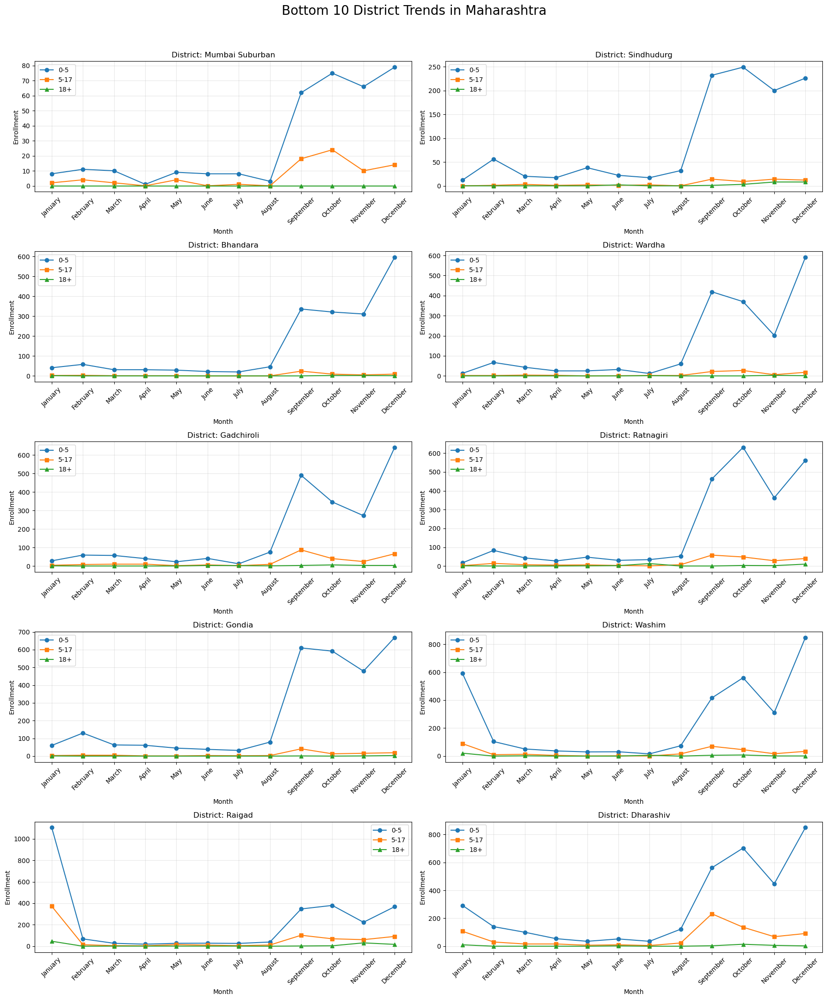

In [230]:
plot_state_district_bottom_trends('Maharashtra')

In [231]:
min_date = enrol_df['date'].min()
max_date = enrol_df['date'].max()
print(f"Minimum date: {min_date}")
print(f"Maximum date: {max_date}")

Minimum date: 2025-01-04 00:00:00
Maximum date: 2025-12-31 00:00:00


In [232]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name,total_enrollment
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,2,February,109
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,9,September,86
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,9,September,123
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,9,September,106
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,9,September,51


In [233]:
enrol_df["date"] = pd.to_datetime(enrol_df["date"], format="%Y-%m-%d")

# Extract day of week
enrol_df["day_of_week"] = enrol_df["date"].dt.day_name()

In [234]:
enrol_df.columns

Index(['date', 'state', 'district', 'pincode', 'age_0_5', 'age_5_17',
       'age_18_greater', 'month', 'month_name', 'total_enrollment',
       'day_of_week'],
      dtype='object')

In [235]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name,total_enrollment,day_of_week
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,2,February,109,Monday
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,9,September,86,Wednesday
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,9,September,123,Wednesday
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,9,September,106,Wednesday
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,9,September,51,Wednesday


In [236]:
enrol_df.tail(20)

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name,total_enrollment,day_of_week
1005987,2025-12-31,West Bengal,South 24 Parganas,743395,2,6,0,12,December,8,Wednesday
1005988,2025-12-31,West Bengal,South 24 Parganas,743507,2,2,0,12,December,4,Wednesday
1005989,2025-12-31,West Bengal,South 24 Parganas,743513,12,7,0,12,December,19,Wednesday
1005990,2025-12-31,West Bengal,South 24 Parganas,743601,2,0,0,12,December,2,Wednesday
1005991,2025-12-31,West Bengal,South 24 Parganas,700063,0,3,0,12,December,3,Wednesday
1005992,2025-12-31,West Bengal,South 24 Parganas,700104,1,0,0,12,December,1,Wednesday
1005993,2025-12-31,West Bengal,South 24 Parganas,700137,1,3,0,12,December,4,Wednesday
1005994,2025-12-31,West Bengal,South 24 Parganas,743503,0,5,0,12,December,5,Wednesday
1005995,2025-12-31,West Bengal,Uttar Dinajpur,733134,11,10,1,12,December,22,Wednesday
1005996,2025-12-31,West Bengal,Uttar Dinajpur,733201,33,26,1,12,December,60,Wednesday


In [237]:
enrol_df["day_type"] = enrol_df["date"].dt.weekday.apply(
    lambda x: "Weekend" if x >= 5 else "Weekday"
)


In [238]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name,total_enrollment,day_of_week,day_type
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,2,February,109,Monday,Weekday
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,9,September,86,Wednesday,Weekday
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,9,September,123,Wednesday,Weekday
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,9,September,106,Wednesday,Weekday
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,9,September,51,Wednesday,Weekday


In [239]:
enrol_df[enrol_df["day_of_week"] == "Tuesday"]

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name,total_enrollment,day_of_week,day_type
2146,2025-01-07,Haryana,Panipat,132103,1344,169,10,1,January,1523,Tuesday,Weekday
2147,2025-01-07,Arunachal Pradesh,West Kameng,790101,43,30,10,1,January,83,Tuesday,Weekday
2148,2025-01-07,Himachal Pradesh,Kullu,175101,57,24,33,1,January,114,Tuesday,Weekday
2149,2025-01-07,Karnataka,Bengaluru Urban,560068,394,263,147,1,January,804,Tuesday,Weekday
2150,2025-01-07,Karnataka,Bengaluru Rural,560087,153,98,88,1,January,339,Tuesday,Weekday
...,...,...,...,...,...,...,...,...,...,...,...,...
907902,2025-12-23,West Bengal,South 24 Parganas,700103,1,0,0,12,December,1,Tuesday,Weekday
907903,2025-12-23,West Bengal,South 24 Parganas,743318,5,0,0,12,December,5,Tuesday,Weekday
907904,2025-12-23,West Bengal,Uttar Dinajpur,733202,20,0,0,12,December,20,Tuesday,Weekday
907905,2025-12-23,West Bengal,Uttar Dinajpur,733207,12,0,0,12,December,12,Tuesday,Weekday


In [240]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name,total_enrollment,day_of_week,day_type
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,2,February,109,Monday,Weekday
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,9,September,86,Wednesday,Weekday
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,9,September,123,Wednesday,Weekday
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,9,September,106,Wednesday,Weekday
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,9,September,51,Wednesday,Weekday


## Weekday vs Weekend Total Enrollment Analysis

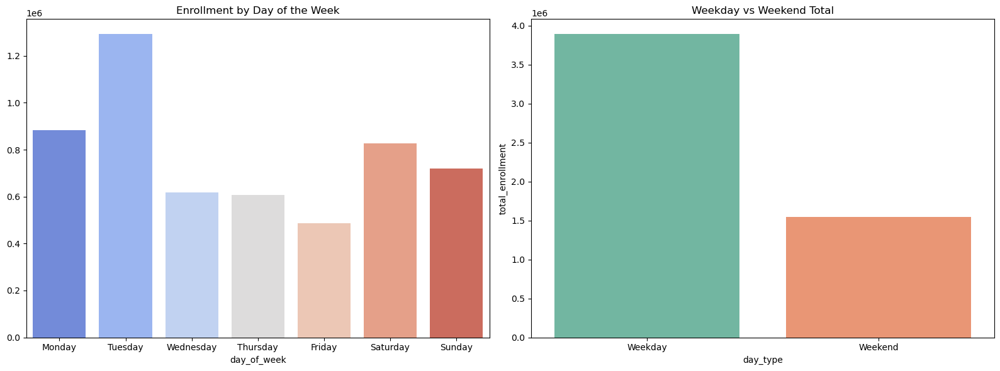

In [241]:
import pandas as pd
enrol_df['total_enrollment'] = enrol_df['age_0_5'] + enrol_df['age_5_17'] + enrol_df['age_18_greater']

# Grouping for Day of the Week
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
weekly_data = enrol_df.groupby('day_of_week')['total_enrollment'].sum().reindex(day_order)

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot 1: Weekly Distribution
sns.barplot(x=weekly_data.index, y=weekly_data.values, ax=axes[0], palette='coolwarm')
axes[0].set_title('Enrollment by Day of the Week')

# Plot 2: Weekday vs Weekend
sns.barplot(data=enrol_df.groupby('day_type')['total_enrollment'].sum().reset_index(), 
            x='day_type', y='total_enrollment', ax=axes[1], palette='Set2')
axes[1].set_title('Weekday vs Weekend Total')

plt.tight_layout()
plt.show()

In [242]:
# Group by month_name and get unique day names for each month
days_names_per_month = enrol_df.groupby('month_name')['day_of_week'].apply(lambda x: sorted(x.unique())).reset_index()
print(days_names_per_month)

   month_name                                        day_of_week
0     January      [Monday, Saturday, Sunday, Thursday, Tuesday]
1    February                          [Monday, Sunday, Tuesday]
2       March  [Friday, Saturday, Sunday, Thursday, Tuesday, ...
3       April                                [Friday, Wednesday]
4         May                                   [Friday, Sunday]
5        June                                [Monday, Wednesday]
6        July                                [Friday, Wednesday]
7      August                                 [Monday, Saturday]
8   September  [Friday, Monday, Saturday, Sunday, Thursday, T...
9     October  [Friday, Monday, Saturday, Sunday, Thursday, T...
10   November  [Friday, Monday, Saturday, Sunday, Thursday, T...
11   December  [Friday, Monday, Saturday, Sunday, Thursday, T...


In [243]:
#e Group by month_name and get unique days for each month
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
enrol_df['month_name'] = pd.Categorical(enrol_df['month_name'], categories=month_order, ordered=True)
days_per_month = enrol_df.groupby('month_name')['date'].apply(lambda x: sorted(x.dt.day.unique())).reset_index()
print(days_per_month)

   month_name                                               date
0     January                                [4, 5, 6, 7, 9, 11]
1    February                                         [3, 9, 11]
2       March                [9, 11, 15, 20, 23, 26, 27, 28, 29]
3       April                                            [9, 11]
4         May                                            [9, 11]
5        June                                            [9, 11]
6        July                                            [9, 11]
7      August                                            [9, 11]
8   September  [3, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21,...
9     October  [9, 11, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23...
10   November            [9, 11, 13, 14, 15, 16, 17, 18, 19, 25]
11   December  [9, 11, 15, 21, 22, 23, 24, 25, 26, 27, 28, 29...


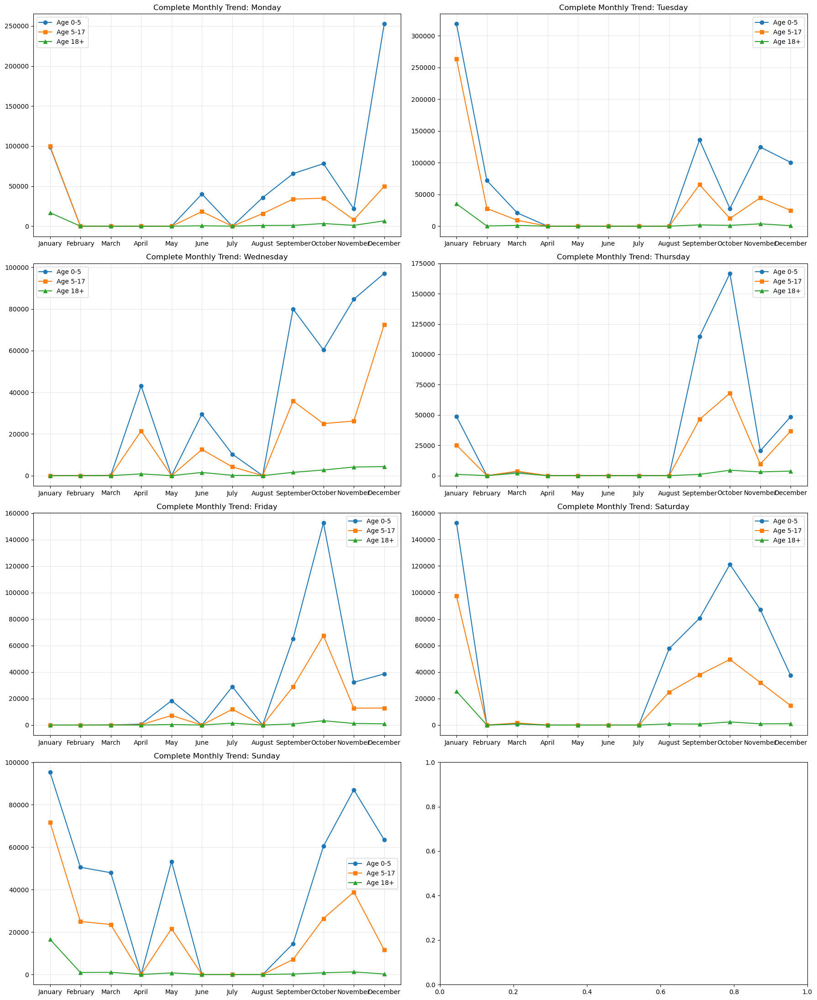

In [244]:
# Get all unique months in order
month_info = enrol_df[['month', 'month_name']].drop_duplicates().sort_values('month')
all_months = month_info['month_name'].tolist()
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Aggregate
daily_monthly_age = enrol_df.groupby(['day_of_week', 'month_name'])[['age_0_5', 'age_5_17', 'age_18_greater']].sum().reset_index()

# Plotting 7 charts (one for each day)
fig, axes = plt.subplots(4, 2, figsize=(18, 22))
axes = axes.flatten()

for i, day in enumerate(day_order):
    ax = axes[i]
    # Filter and reindex to include ALL months (filling missing with 0)
    day_data = daily_monthly_age[daily_monthly_age['day_of_week'] == day]
    day_data_full = day_data.set_index('month_name').reindex(all_months).fillna(0).reset_index()
    
    # Plot lines
    ax.plot(day_data_full['month_name'], day_data_full['age_0_5'], marker='o', label='Age 0-5')
    ax.plot(day_data_full['month_name'], day_data_full['age_5_17'], marker='s', label='Age 5-17')
    ax.plot(day_data_full['month_name'], day_data_full['age_18_greater'], marker='^', label='Age 18+')
    
    ax.set_title(f'Complete Monthly Trend: {day}')
    ax.legend()
    ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

* Tuesday's Special Operations: Tuesday is the only day where we see activity in April and July. This suggests that during these early months, the enrollment infrastructure was only active or reported on Tuesdays.

* Thursday (May) & Sunday (June): Similarly, the data shows that enrollment centers or specific drives were only captured on a single day of the week during these months.

* The "Full-Week" Shift (September – December): Starting from September, the data becomes "dense," with enrollments happening every single day of the week. This indicates a transition from periodic/special drives to a full-time, daily operational model.

* Monday's December Peak: You can see a massive vertical surge on Mondays in December for the 0-5 age group, while the other days remain relatively lower.

* Special Weekend Activity (November/December): * In November, Sunday enrollment numbers are surprisingly high, rivaling or exceeding midweek days. This suggests that during high-demand months, authorities likely organize special "Sunday Camps" to clear backlogs.

## Weekdays vs Weekends Monthly Analysis Age wise

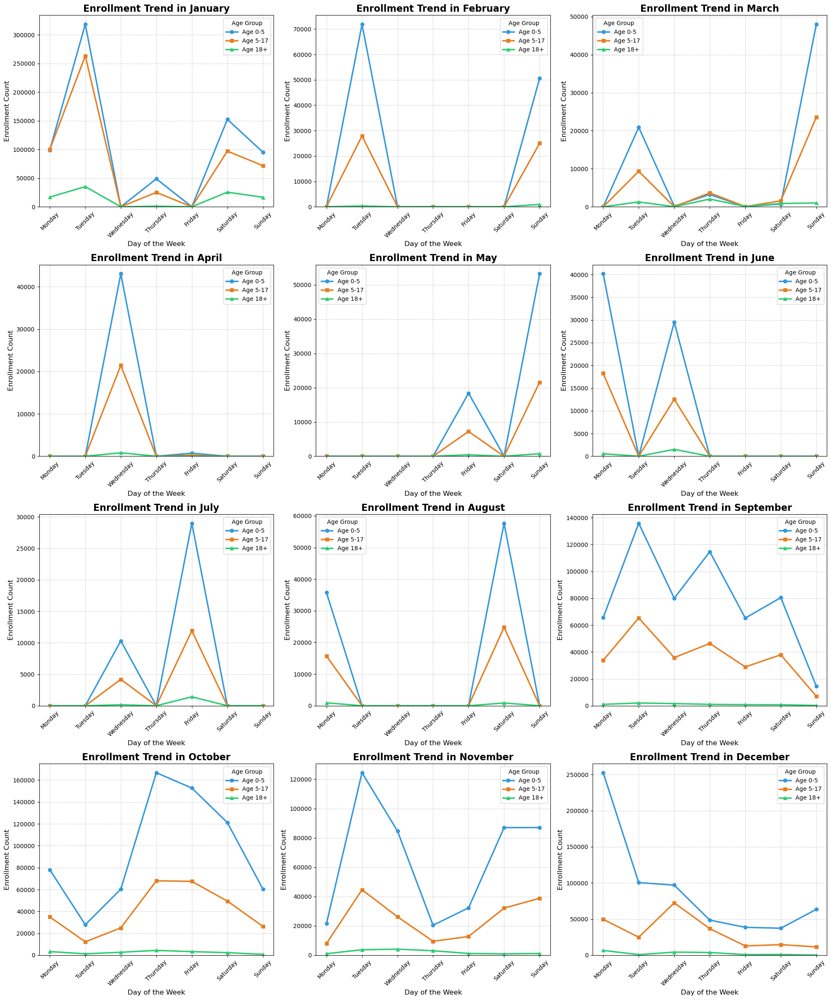

Analysis Complete. 12 month charts generated.


In [245]:
# 2. Define chronological orders
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
# Get unique month names in the correct chronological order using the numeric 'month' column
month_info = enrol_df[['month', 'month_name']].drop_duplicates().sort_values('month')
all_months = month_info['month_name'].unique().tolist()

# 3. Aggregate the data by Month (numeric), Month Name, and Day of Week
monthly_daily_age = enrol_df.groupby(['month', 'month_name', 'day_of_week'])[['age_0_5', 'age_5_17', 'age_18_greater']].sum().reset_index()
# 4. Create subplots for each month
num_months = len(all_months)
cols = 3
rows = math.ceil(num_months / cols)

fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 6))
axes = axes.flatten()

for i, month_name in enumerate(all_months):
    ax = axes[i]
    
    # Filter for the specific month name
    month_data = monthly_daily_age[monthly_daily_age['month_name'] == month_name]
    
    # FIXED STEP: Ensure day_of_week labels are unique before reindexing
    # We group by day_of_week and sum again to aggregate any duplicate month names
    month_data_grouped = month_data.groupby('day_of_week')[['age_0_5', 'age_5_17', 'age_18_greater']].sum()
    
    # Reindex to ensure ALL 7 days of the week are present on the chart
    month_data_full = month_data_grouped.reindex(day_order).fillna(0).reset_index()
    
    # 5. Plotting
    ax.plot(month_data_full['day_of_week'], month_data_full['age_0_5'], marker='o', label='Age 0-5', linewidth=2.5, color='#3498db')
    ax.plot(month_data_full['day_of_week'], month_data_full['age_5_17'], marker='s', label='Age 5-17', linewidth=2.5, color='#e67e22')
    ax.plot(month_data_full['day_of_week'], month_data_full['age_18_greater'], marker='^', label='Age 18+', linewidth=2.5, color='#2ecc71')
    
    ax.set_title(f'Enrollment Trend in {month_name}', fontsize=16, fontweight='bold')
    ax.set_xlabel('Day of the Week', fontsize=12)
    ax.set_ylabel('Enrollment Count', fontsize=12)
    ax.legend(title='Age Group')
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.set_ylim(bottom=0)
    ax.tick_params(axis='x', rotation=45)

# Remove any extra empty subplots
for k in range(num_months, len(axes)):
    fig.delaxes(axes[k])

plt.tight_layout()
plt.savefig('monthly_daywise_trends_fixed.png')
plt.show()

print(f"Analysis Complete. {num_months} month charts generated.")

1. Selective Operation Days (March – July): * During the early part of the year, data recording or drives were highly specific to certain days.

    * April and July: Activities were recorded exclusively on Tuesdays.
    * May: Activities were recorded only on Thursdays.
    * June: Activities were recorded only on Sundays.
    * March: Shows very low activity spread across Wednesday to Sunday.

2. Full-Scale Operations (September – December): * From September onwards, the system moved to a full 7-day operational cycle.

    * In September, the Age 0-5 group peaked significantly across all weekdays, with a notable dip on Sundays.
    * In November, activity became more balanced, with Sunday enrollment rising to match or exceed some weekdays.

3. Age-Group Dynamics:

    * In September and October, the Age 0-5 group (blue line) dominates every day of the week.
    * However, in months like November and December, the gap between the 0-5 and 5-17 age groups narrows on specific days, indicating a shift in focus toward school-age children during those periods.

In [246]:
enrol_df.head()

,date,state,district,pincode,age_0_5,age_5_17,age_18_greater,month,month_name,total_enrollment,day_of_week,day_type
0,2025-02-03,Meghalaya,East Khasi Hills,793121,11,61,37,2,February,109,Monday,Weekday
1,2025-09-03,Karnataka,Bengaluru Urban,560043,14,33,39,9,September,86,Wednesday,Weekday
2,2025-09-03,Uttar Pradesh,Kanpur Nagar,208001,29,82,12,9,September,123,Wednesday,Weekday
3,2025-09-03,Uttar Pradesh,Aligarh,202133,62,29,15,9,September,106,Wednesday,Weekday
4,2025-09-03,Karnataka,Bengaluru Urban,560016,14,16,21,9,September,51,Wednesday,Weekday


In [247]:
import pandas as pd

def validate_month(date_str):
    """
    Validate if month is between 1 and 12
    Returns: True if valid, False if invalid, None if not a date
    """
    if pd.isna(date_str):
        return None
    
    try:
        date_str = str(date_str)
        
        # Split by common separators
        if '-' in date_str:
            parts = date_str.split('-')
        elif '/' in date_str:
            parts = date_str.split('/')
        elif '.' in date_str:
            parts = date_str.split('.')
        else:
            return None
        
        # Check if we have at least 3 parts
        if len(parts) < 3:
            return None
        
        # Try to extract month (second element in yyyy-mm-dd format)
        month = int(parts[1])
        
        # Validate month range
        if 1 <= month <= 12:
            return True
        else:
            return False
    
    except (ValueError, IndexError):
        return None

# Apply validation
enrol_df['month_valid'] = enrol_df['date'].apply(validate_month)

# Get invalid rows
invalid_rows = enrol_df[enrol_df['month_valid'] == False]
valid_rows = enrol_df[enrol_df['month_valid'] == True]
ambiguous_rows = enrol_df[enrol_df['month_valid'].isna()]

print(f"Invalid months: {len(invalid_rows)} rows")
print(f"Valid months: {len(valid_rows)} rows")
print(f"Ambiguous dates: {len(ambiguous_rows)} rows")

Invalid months: 0 rows
Valid months: 1006007 rows
Ambiguous dates: 0 rows


In [248]:
print(f"Valid months: {len(valid_rows)} rows")
print(f"Ambiguous dates: {len(ambiguous_rows)} rows")

Valid months: 1006007 rows
Ambiguous dates: 0 rows


## State wise Monthly enrollment with respect to Age Groups

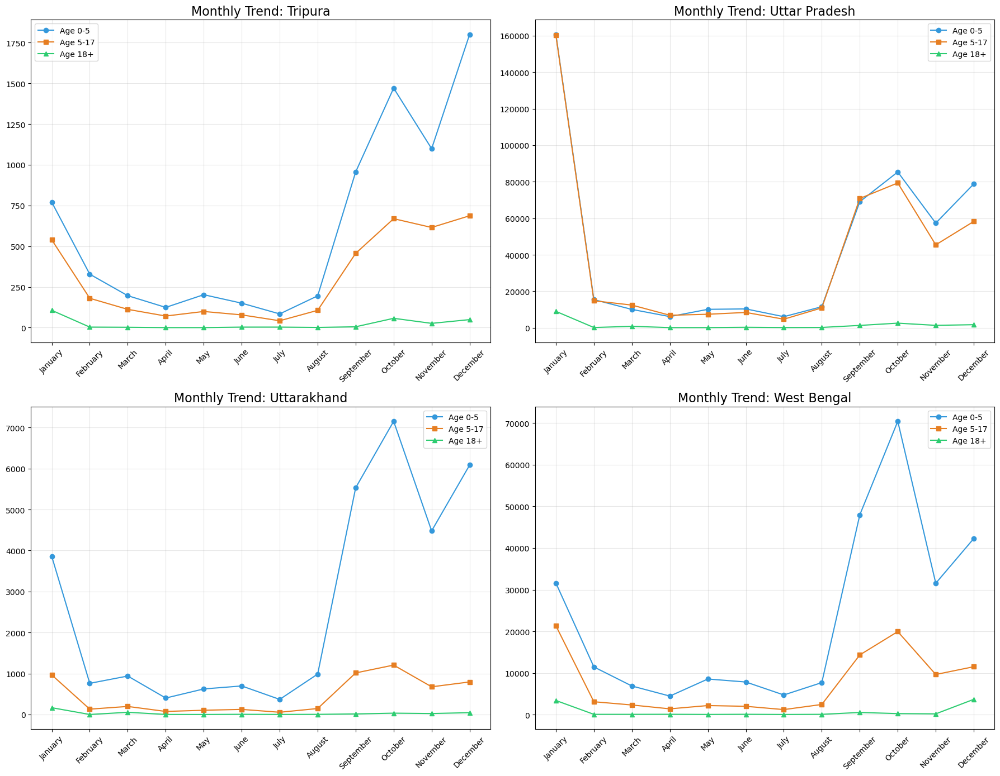

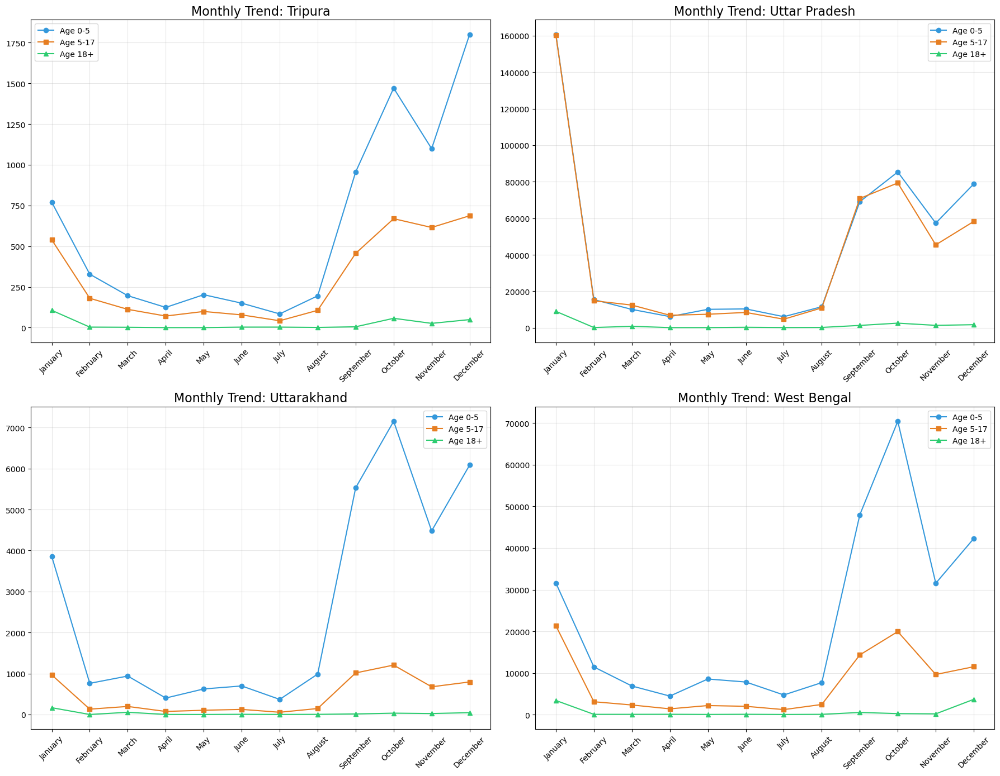

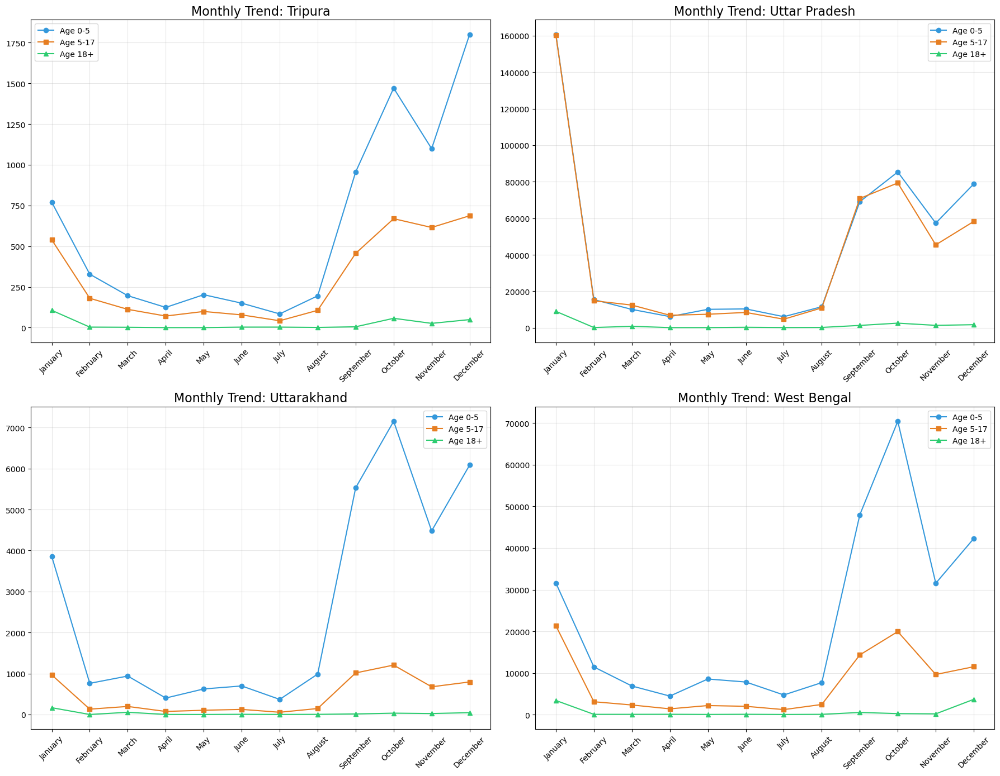

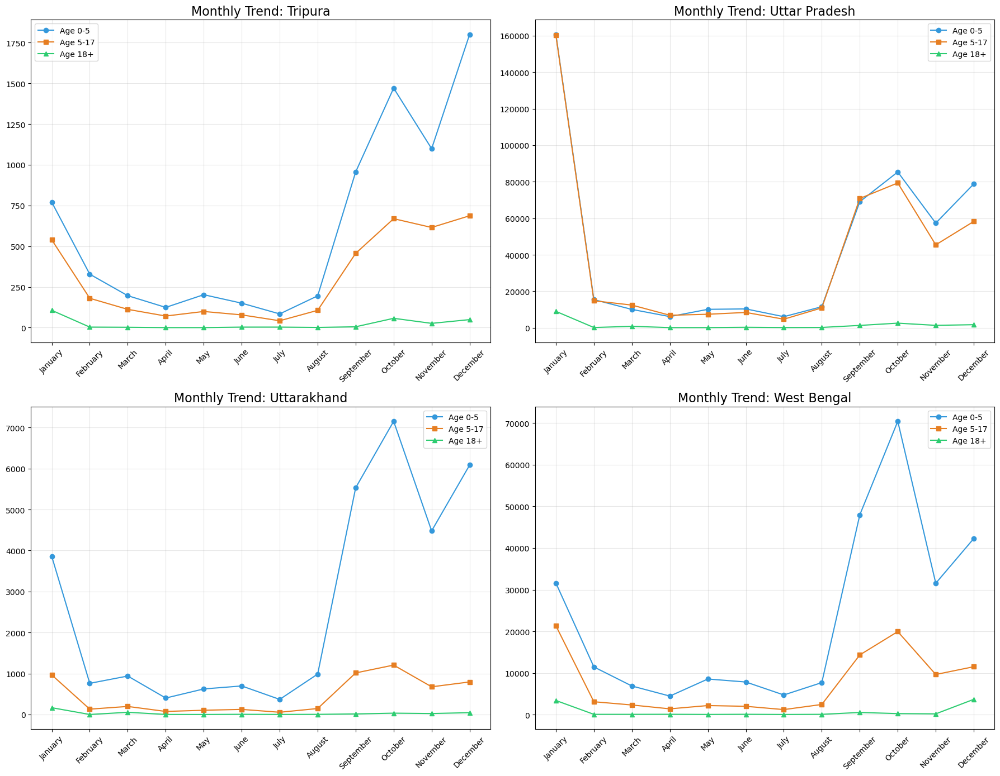

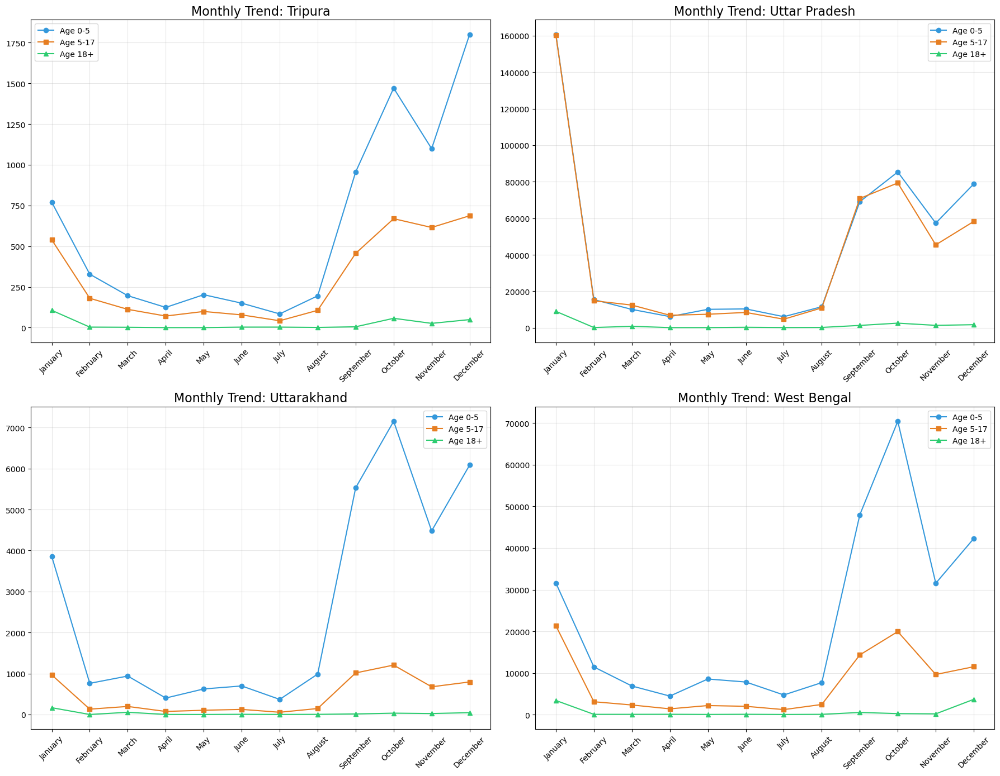

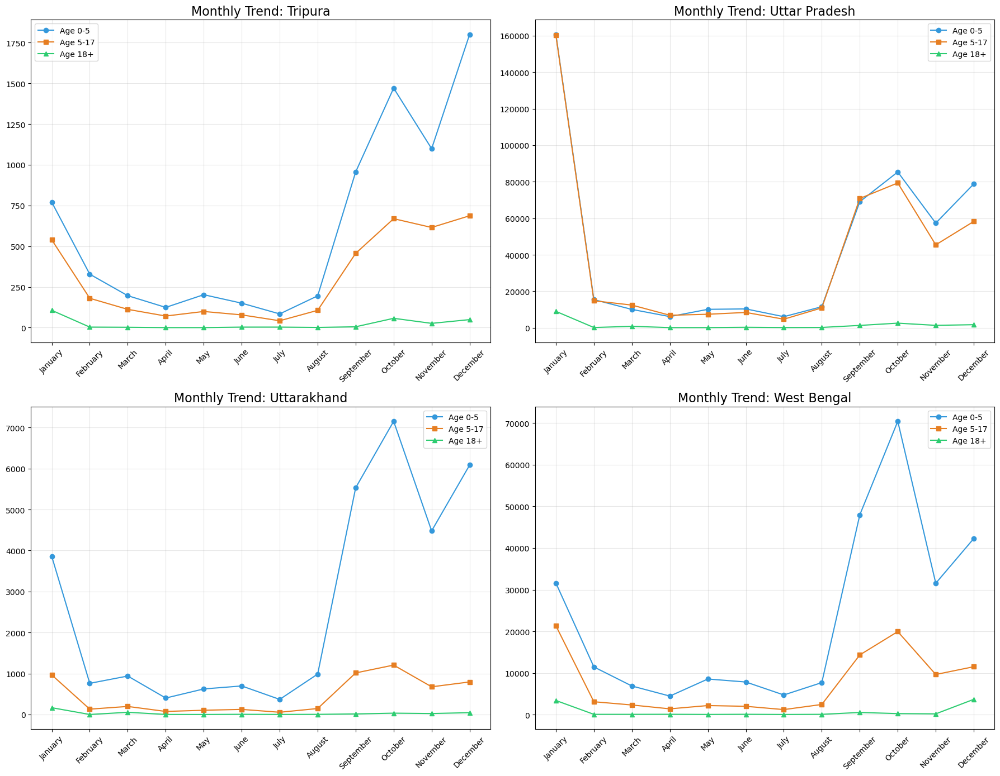

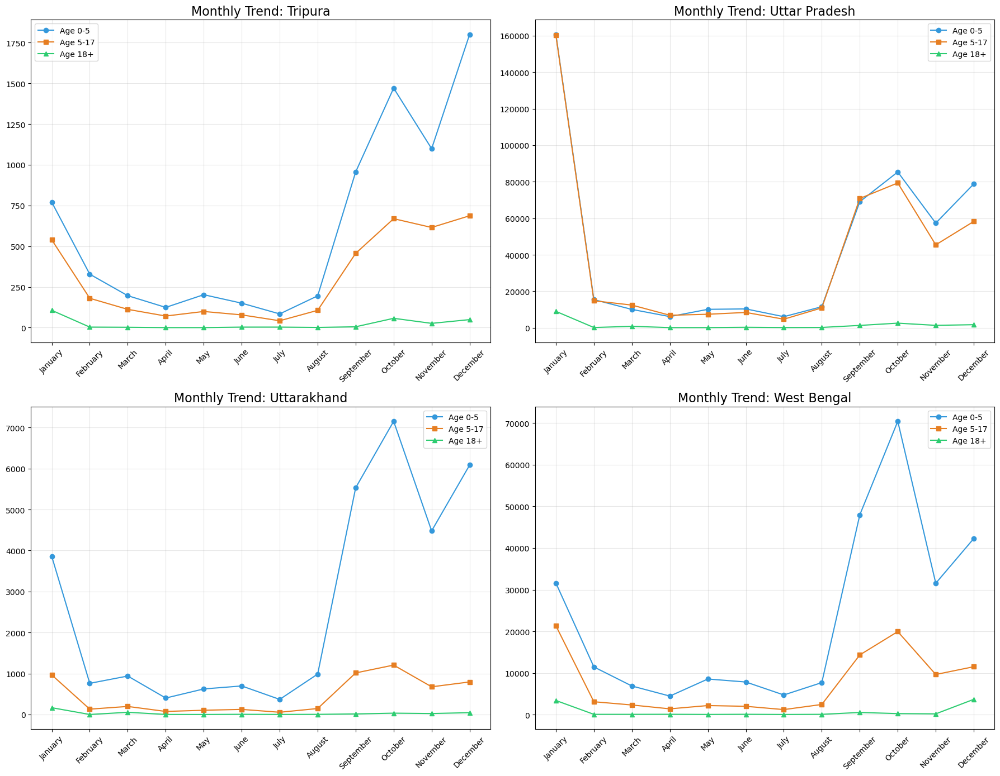

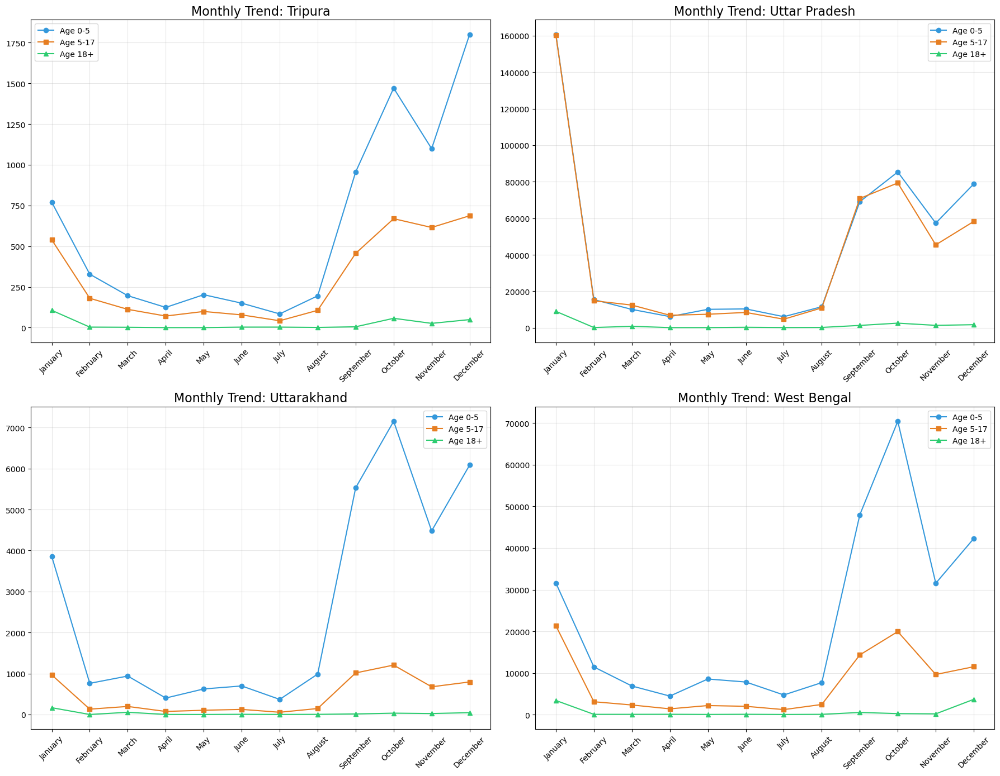

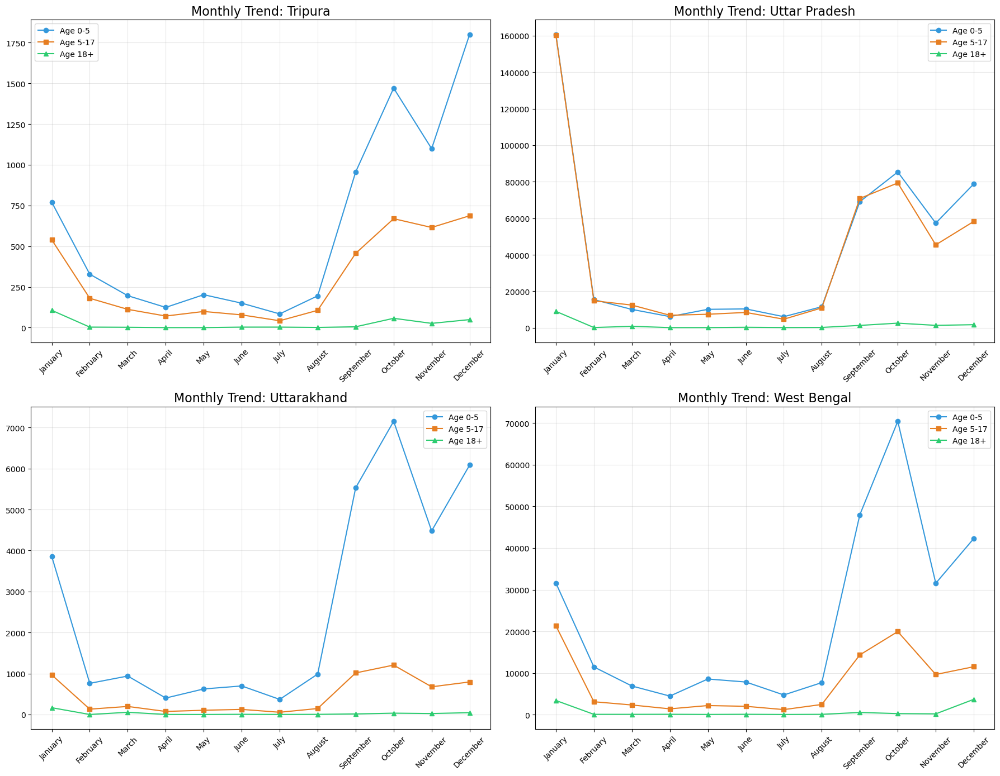

In [249]:
# 2. Define the full list of months you WANT to see (including Jan/Feb)
all_months = [
    "January", "February", "March", "April", "May", "June",
    "July", "August", "September", "October", "November", "December"
]

# 3. Aggregation: Group ONLY by state and month_name to ensure uniqueness
state_monthly = enrol_df.groupby(['state', 'month_name'], observed=False)[['age_0_5', 'age_5_17', 'age_18_greater']].sum().reset_index()

states = sorted(state_monthly['state'].unique())

# 4. Plotting in Batches
num_states = len(states)
num_figs = math.ceil(num_states / 4)

for i in range(num_figs):
    current_batch = states[i*4 : (i+1)*4]
    fig, axes = plt.subplots(2, 2, figsize=(18, 14))
    axes = axes.flatten()
    
    for j, state in enumerate(current_states):
        # Filter for the state
        data = state_monthly[state_monthly['state'] == state]
        
        # FIX: Explicitly aggregate again by month_name just in case of duplicates 
        # then reindex using the full 12-month list
        data_full = data.groupby('month_name')[['age_0_5', 'age_5_17', 'age_18_greater']].sum()
        data_full = data_full.reindex(all_months).fillna(0).reset_index()
        
        ax = axes[j]
        ax.plot(data_full['month_name'], data_full['age_0_5'], marker='o', label='Age 0-5', color='#3498db')
        ax.plot(data_full['month_name'], data_full['age_5_17'], marker='s', label='Age 5-17', color='#e67e22')
        ax.plot(data_full['month_name'], data_full['age_18_greater'], marker='^', label='Age 18+', color='#2ecc71')
        
        ax.set_title(f'Monthly Trend: {state}', fontsize=16)
        ax.legend()
        ax.grid(True, alpha=0.3)
        ax.tick_params(axis='x', rotation=45)

    for k in range(len(current_batch), 4): fig.delaxes(axes[k])
    
    plt.tight_layout()
    plt.show()

In [250]:
enrol_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1006007 entries, 0 to 1006006
Data columns (total 13 columns):
 #   Column            Non-Null Count    Dtype         
---  ------            --------------    -----         
 0   date              1006007 non-null  datetime64[ns]
 1   state             1006007 non-null  object        
 2   district          1006007 non-null  object        
 3   pincode           1006007 non-null  int64         
 4   age_0_5           1006007 non-null  int64         
 5   age_5_17          1006007 non-null  int64         
 6   age_18_greater    1006007 non-null  int64         
 7   month             1006007 non-null  int32         
 8   month_name        1006007 non-null  category      
 9   total_enrollment  1006007 non-null  int64         
 10  day_of_week       1006007 non-null  object        
 11  day_type          1006007 non-null  object        
 12  month_valid       1006007 non-null  bool          
dtypes: bool(1), category(1), datetime64[ns](1)

## State wise Monthly Day wise enrollment with respect to Age Groups

In [251]:
# 2. Setup orderings
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
all_months = enrol_df.sort_values('month')['month_name'].unique().tolist()

def plot_state_monthly_day_trends(state_name):
    # 1. Filter for the state
    state_df = enrol_df[enrol_df['state'] == state_name]
    
    # 2. Aggregate by Month and Day
    # We include 'month' (numeric) to keep things sorted but aggregate the counts
    monthly_daily = state_df.groupby(['month', 'month_name', 'day_of_week'], observed=True)[
        ['age_0_5', 'age_5_17', 'age_18_greater']
    ].sum().reset_index()
    
    # Grid setup (3x3 for 9 months)
    rows, cols = 4, 3
    fig, axes = plt.subplots(rows, cols, figsize=(18, 15))
    axes = axes.flatten()
    
    # Use the unique months found in this specific state's data to avoid empty plots
    state_months = state_df.sort_values('month')['month_name'].unique().tolist()
    
    for i, month in enumerate(state_months):
        ax = axes[i]
        
        # 3. Filter for the month
        m_data = monthly_daily[monthly_daily['month_name'] == month]
        
        # 4. FIX: Use numeric_only=True or explicitly select columns to sum
        # This prevents the TypeError with categorical 'month_name'
        m_data_grouped = m_data.groupby('day_of_week', observed=True)[
            ['age_0_5', 'age_5_17', 'age_18_greater']
        ].sum()
        
        # 5. Reindex for all 7 days
        m_data_full = m_data_grouped.reindex(day_order).fillna(0).reset_index()
        
        # Plotting
        ax.plot(m_data_full['day_of_week'], m_data_full['age_0_5'], marker='o', label='0-5', linewidth=2)
        ax.plot(m_data_full['day_of_week'], m_data_full['age_5_17'], marker='s', label='5-17', linewidth=2)
        ax.plot(m_data_full['day_of_week'], m_data_full['age_18_greater'], marker='^', label='18+', linewidth=2)
        
        ax.set_title(f'Trend in {month}', fontweight='bold')
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True, alpha=0.3)
        if i == 0: ax.legend()

    # Hide extra subplots if there are fewer than 9 months
    for k in range(len(state_months), len(axes)):
        axes[k].set_visible(False)

    fig.suptitle(f'Monthly Day-wise Trends: {state_name}', fontsize=22, y=1.02)
    plt.tight_layout()
    plt.show()


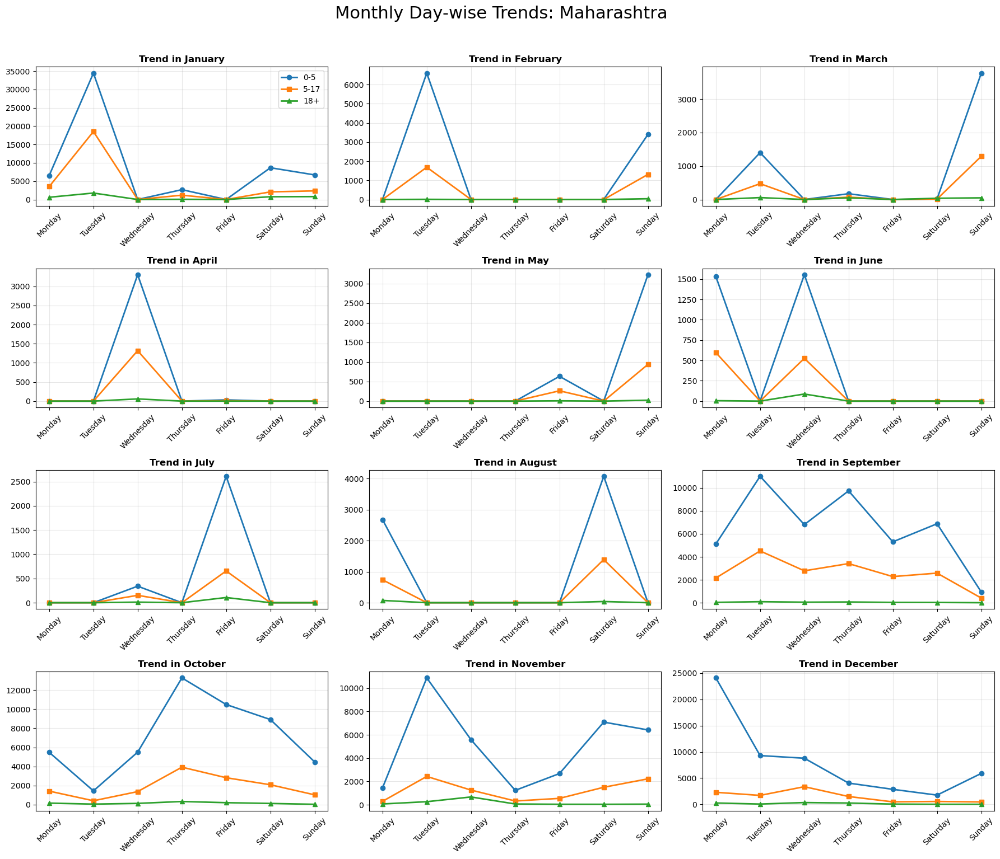

In [252]:
plot_state_monthly_day_trends('Maharashtra')

In [253]:
month_order = ["January","February","March", "April", "May", "June", "July", "August", "September", "October", "November", "December"]
day_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

# Convert to ordered categorical for proper sorting
enrol_df["month_name"] = pd.Categorical(enrol_df["month_name"], categories=month_order, ordered=True)
enrol_df["day_of_week"] = pd.Categorical(enrol_df["day_of_week"], categories=day_order, ordered=True)

def plot_state_district_day_trends(state_name):
    # 3. Total enrollment for ranking
    enrol_df["total_enrollment"] = enrol_df["age_0_5"] + enrol_df["age_5_17"] + enrol_df["age_18_greater"]

    # 4. Select top 10 districts for the given state
    district_agg = enrol_df[enrol_df["state"] == state_name].groupby("district")["total_enrollment"].sum().reset_index()
    top_districts = district_agg.nlargest(10, "total_enrollment")["district"].values

    # 5. Filter and Aggregate by District, Month, AND Day of Week
    df_filtered = enrol_df[(enrol_df["state"] == state_name) & (enrol_df["district"].isin(top_districts))].copy()
    
    agg = df_filtered.groupby(["district", "month_name", "day_of_week"], observed=True)[
        ["age_0_5", "age_5_17", "age_18_greater"]
    ].sum().reset_index()

    # Sort to ensure continuous timeline (Chronological)
    agg = agg.sort_values(["district", "month_name", "day_of_week"])

    # Create descriptive X-axis labels (e.g., Sep-Mon)
    agg["label"] = agg["month_name"].astype(str).str[:3] + "-" + agg["day_of_week"].astype(str).str[:3]

    # 6. Plotting - Using 10 rows to give the detailed timeline more room
    fig, axes = plt.subplots(10, 1, figsize=(20, 45))
    fig.suptitle(f"Individual Day-wise Trends for Top 10 Districts in {state_name}", fontsize=24, y=1.0)
    
    for i, dist in enumerate(top_districts):
        data = agg[agg["district"] == dist]
        ax = axes[i]
        
        ax.plot(data["label"], data["age_0_5"], marker="o", label="0-5", linewidth=1.5)
        ax.plot(data["label"], data["age_5_17"], marker="s", label="5-17", linewidth=1.5)
        ax.plot(data["label"], data["age_18_greater"], marker="^", label="18+", linewidth=1.5)

        ax.set_title(f"District: {dist}", fontsize=18, fontweight='bold')
        ax.set_ylabel("Enrollment Count")
        ax.legend()
        ax.grid(True, alpha=0.3)
        ax.tick_params(axis='x', rotation=90) # Rotate for readability

    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()



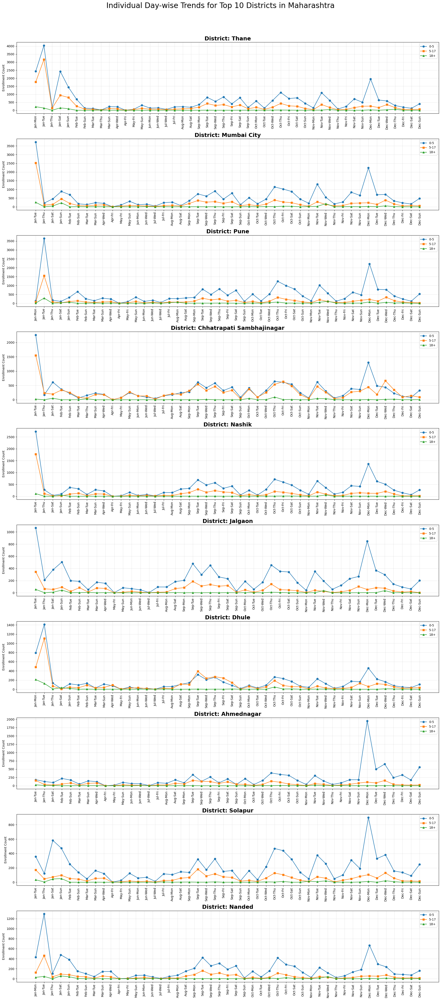

In [254]:
plot_state_district_day_trends("Maharashtra")

In [255]:
# Define Chronological Orders
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
month_order = ["January", "February", "March", "April", "May", "June", 
               "July", "August", "September", "October", "November", "December"]

# Convert to ordered categorical for proper plotting
enrol_df["month_name"] = pd.Categorical(enrol_df["month_name"], categories=month_order, ordered=True)
enrol_df["day_of_week"] = pd.Categorical(enrol_df["day_of_week"], categories=day_order, ordered=True)

def generate_district_monthly_day_plots(state_name):
    # Filter for the state and find top 10 districts
    state_df = enrol_df[enrol_df['state'] == state_name]
    district_agg = state_df.groupby('district')['total_enrollment'].sum().reset_index()
    top_10_districts = district_agg.nlargest(10, 'total_enrollment')['district'].tolist()
    
    # Process each district individually
    for dist in top_10_districts:
        dist_df = state_df[state_df['district'] == dist]
        
        # Create a 4x3 grid for the 12 months
        fig, axes = plt.subplots(4, 3, figsize=(20, 20))
        fig.suptitle(f'12-Month Day-wise Analysis: {dist} ({state_name})', fontsize=26, fontweight='bold', y=1.03)
        axes = axes.flatten()
        
        for i, month in enumerate(month_order):
            ax = axes[i]
            
            # Filter and aggregate for this month
            month_data = dist_df[dist_df['month_name'] == month]
            day_data = month_data.groupby('day_of_week', observed=True)[['age_0_5', 'age_5_17', 'age_18_greater']].sum()
            
            # Ensure all 7 days are represented on the axis
            day_data_full = day_data.reindex(day_order).fillna(0).reset_index()
            
            # Plot age groups
            ax.plot(day_data_full['day_of_week'], day_data_full['age_0_5'], marker='o', label='0-5', color='#3498db', linewidth=2)
            ax.plot(day_data_full['day_of_week'], day_data_full['age_5_17'], marker='s', label='5-17', color='#e67e22', linewidth=2)
            ax.plot(day_data_full['day_of_week'], day_data_full['age_18_greater'], marker='^', label='18+', color='#2ecc71', linewidth=2)
            
            ax.set_title(month, fontsize=16, fontweight='bold')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(True, alpha=0.3)
            if i == 0: ax.legend()
        
        plt.tight_layout()
        plt.savefig(f'analysis_{dist.replace(" ", "_")}.png', bbox_inches='tight')
        plt.show()


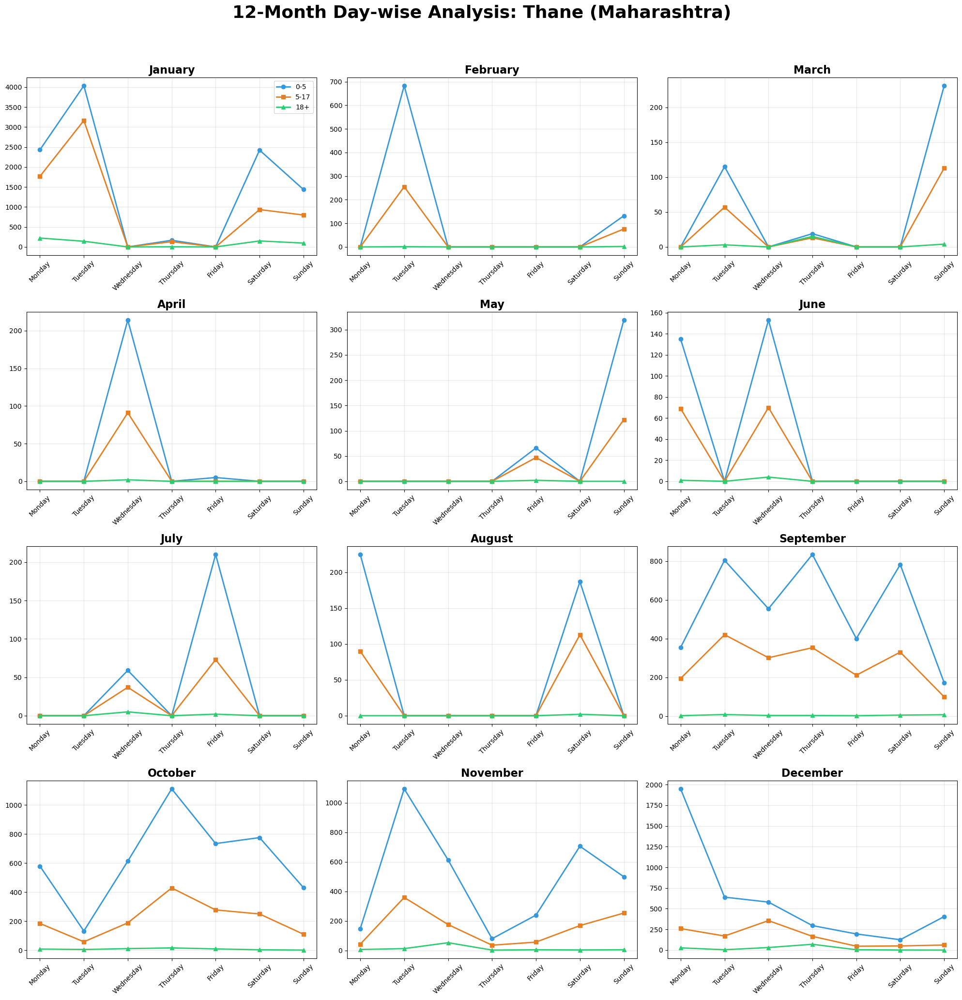

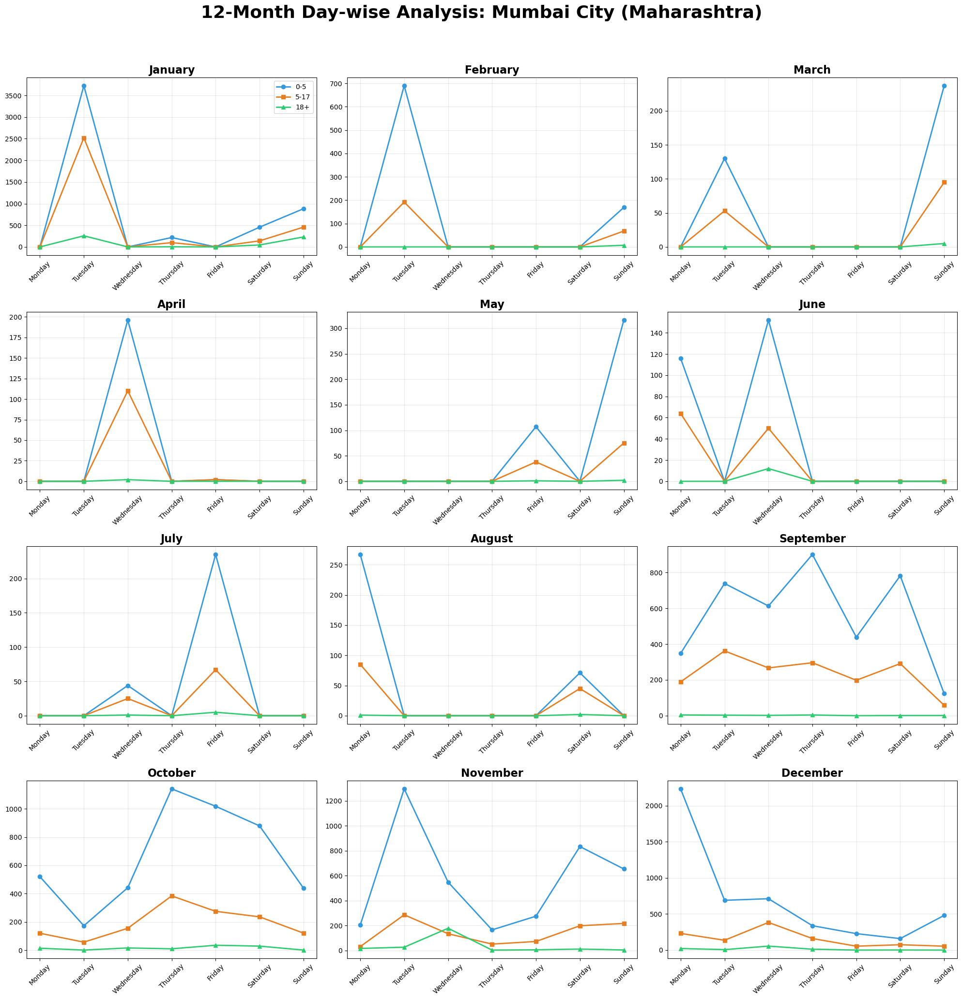

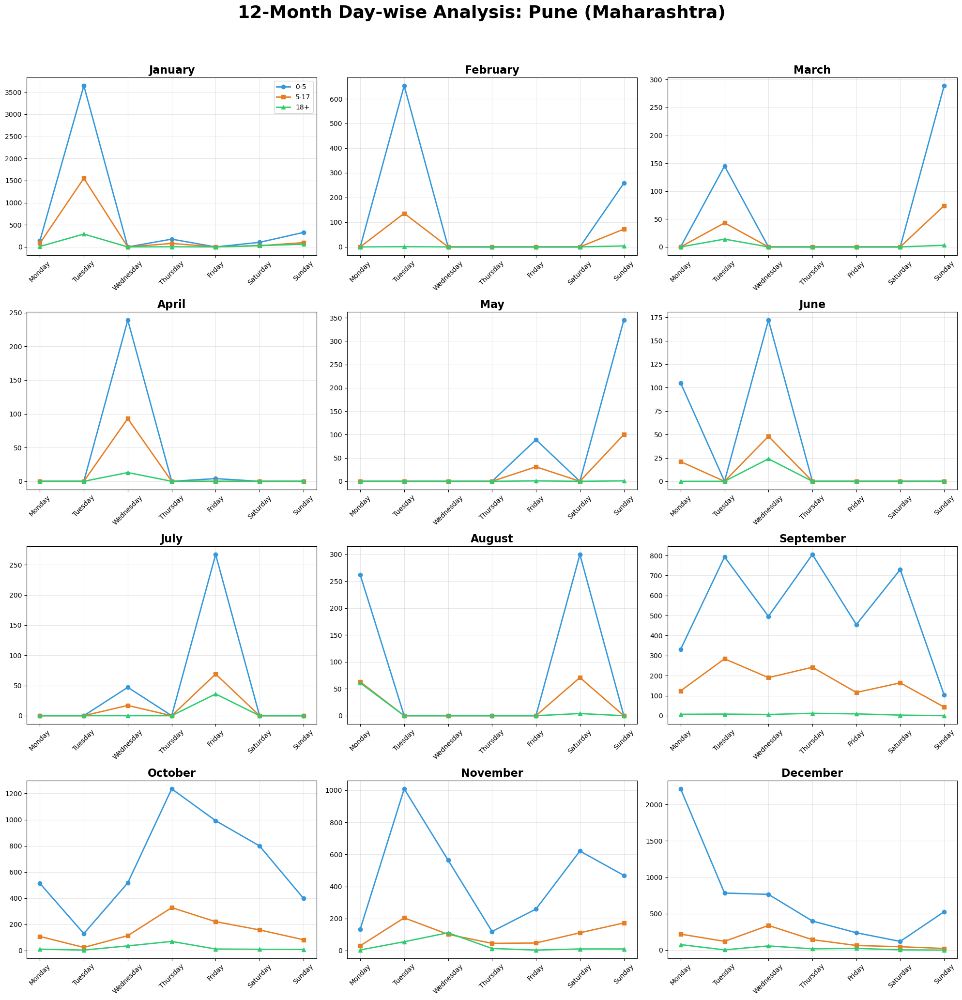

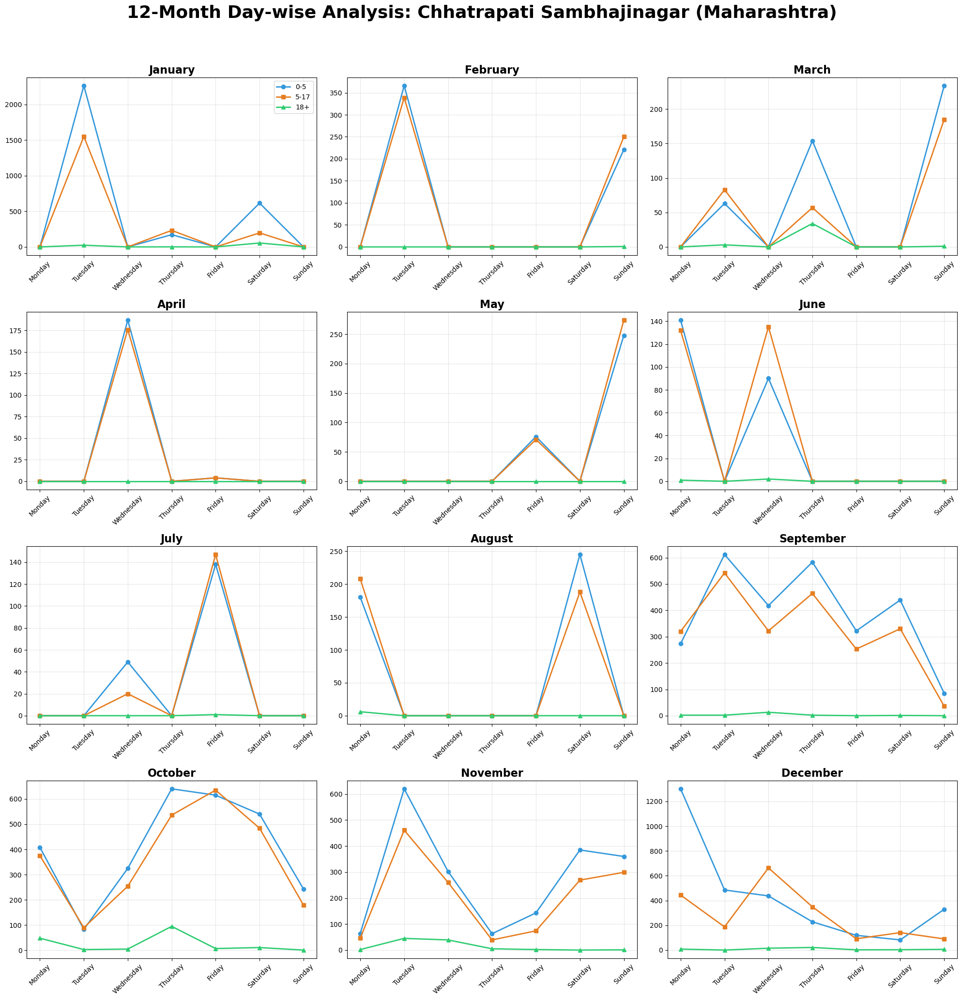

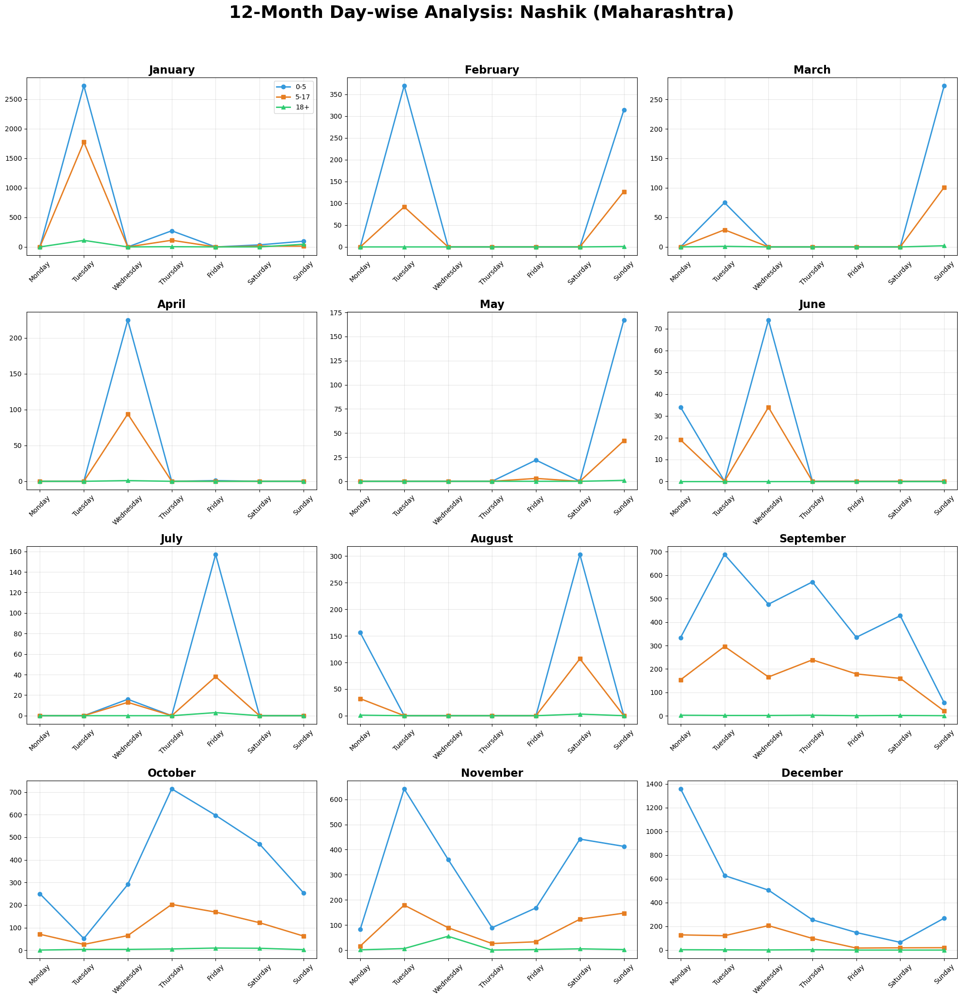

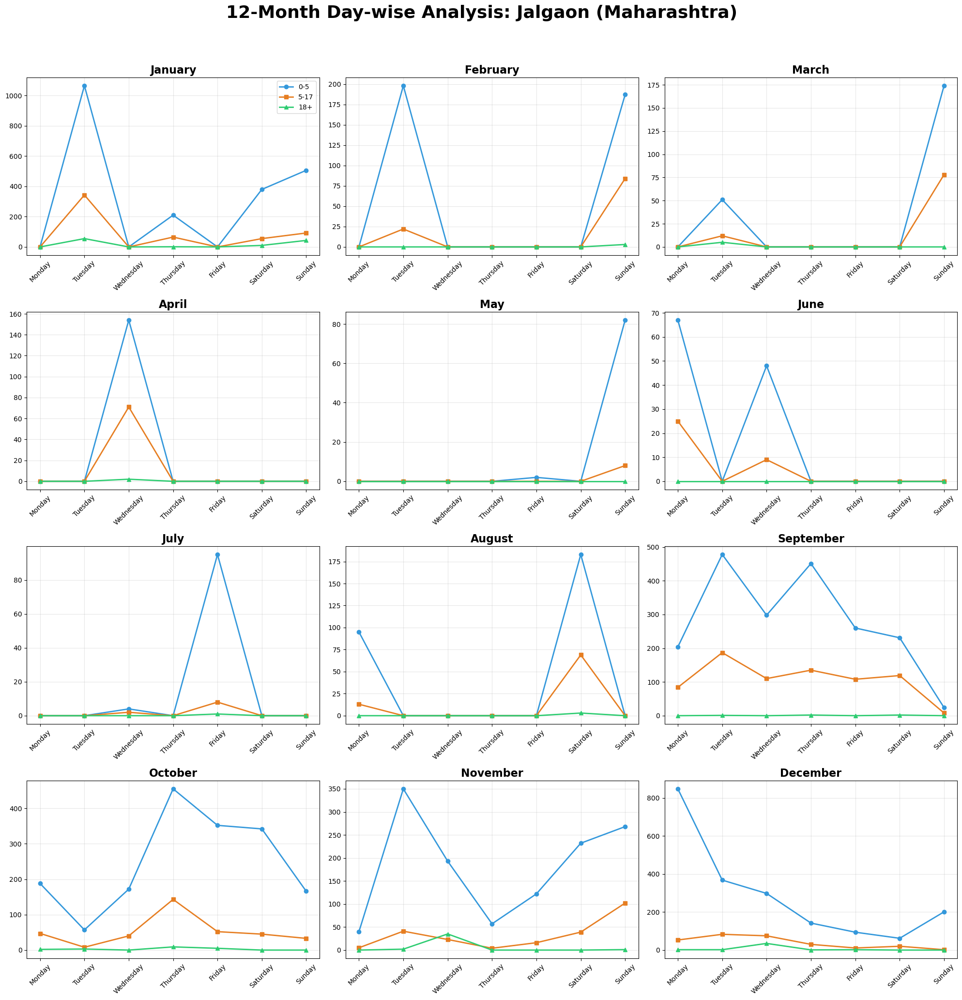

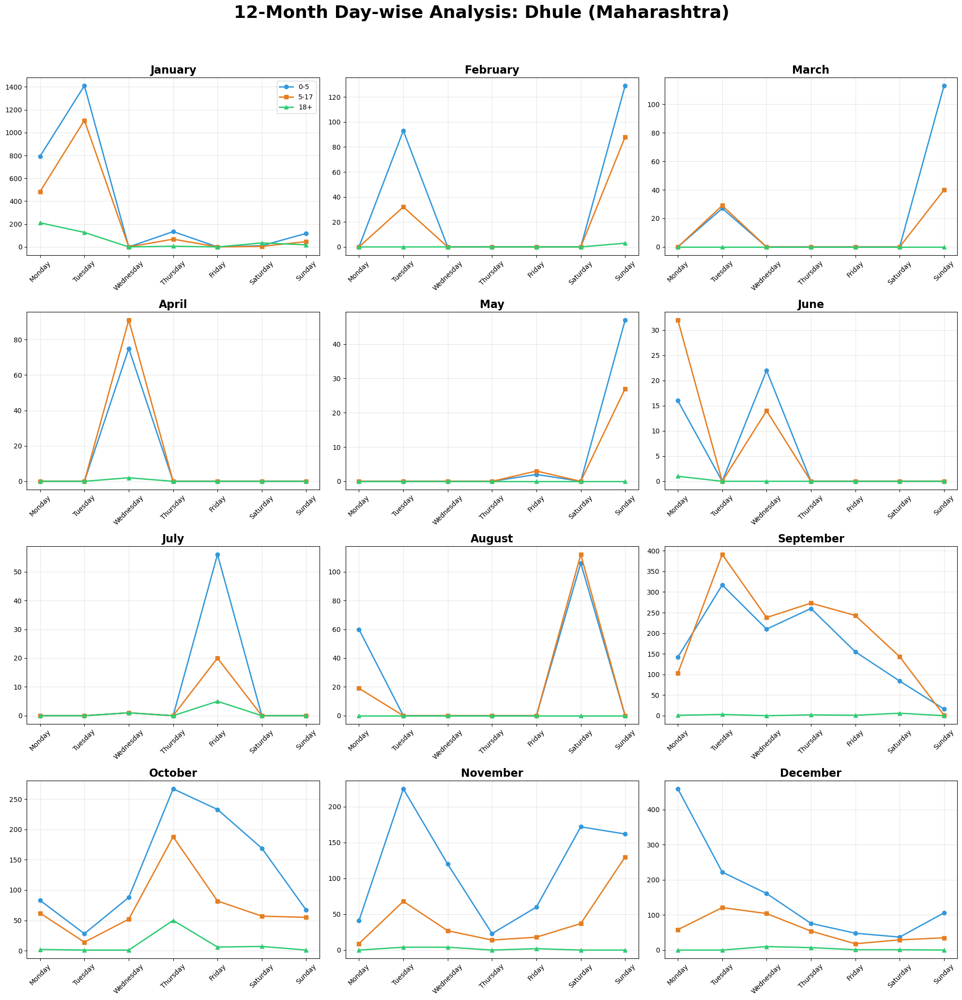

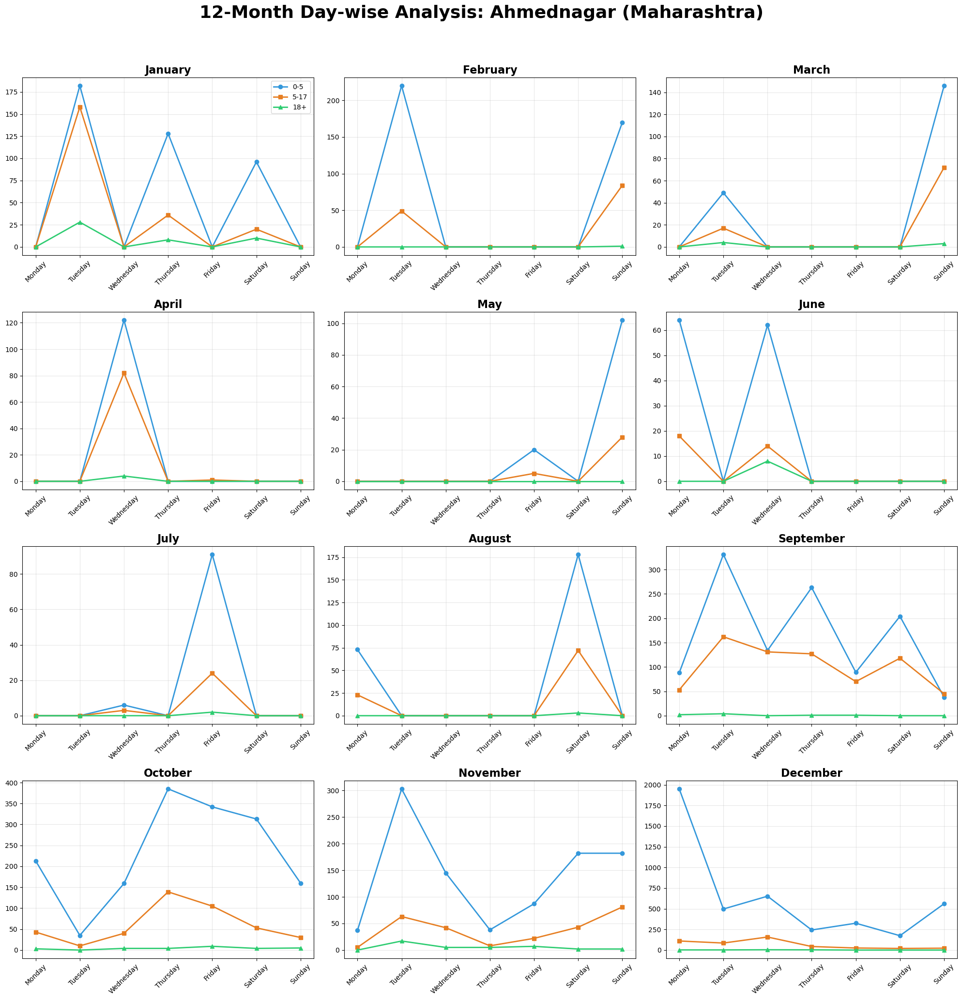

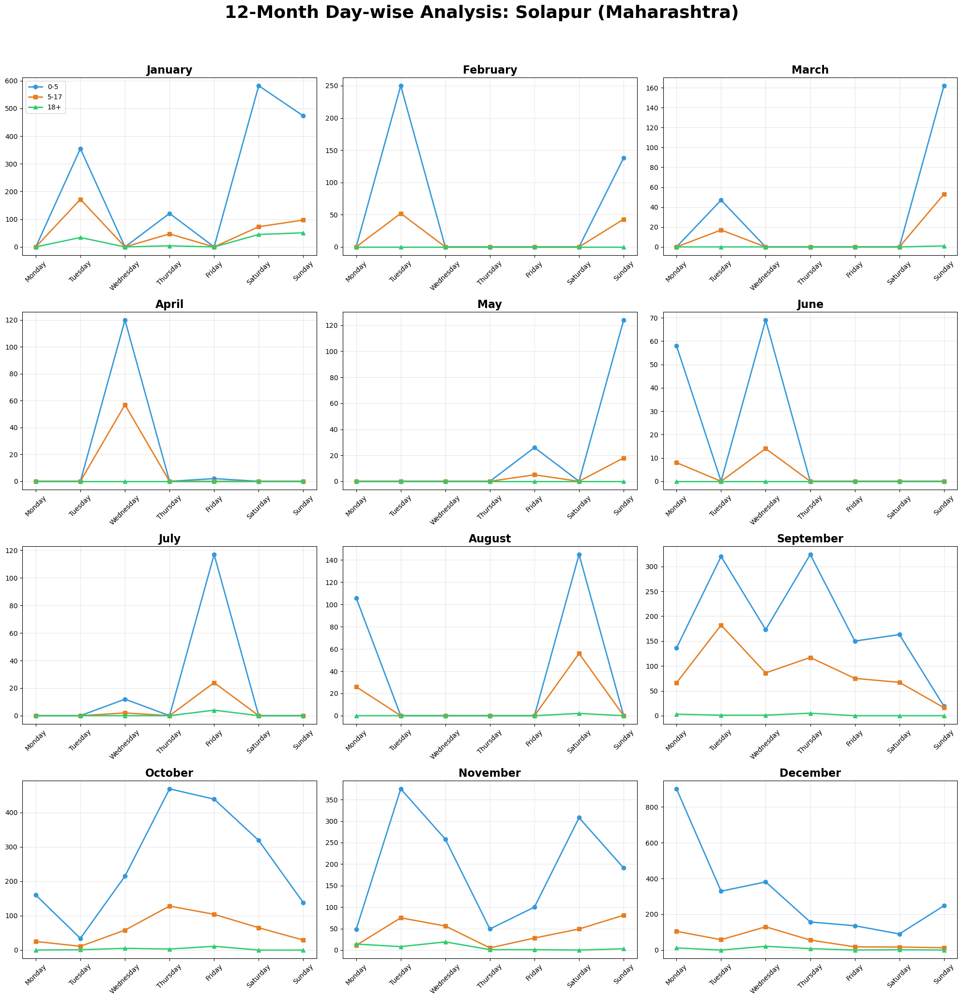

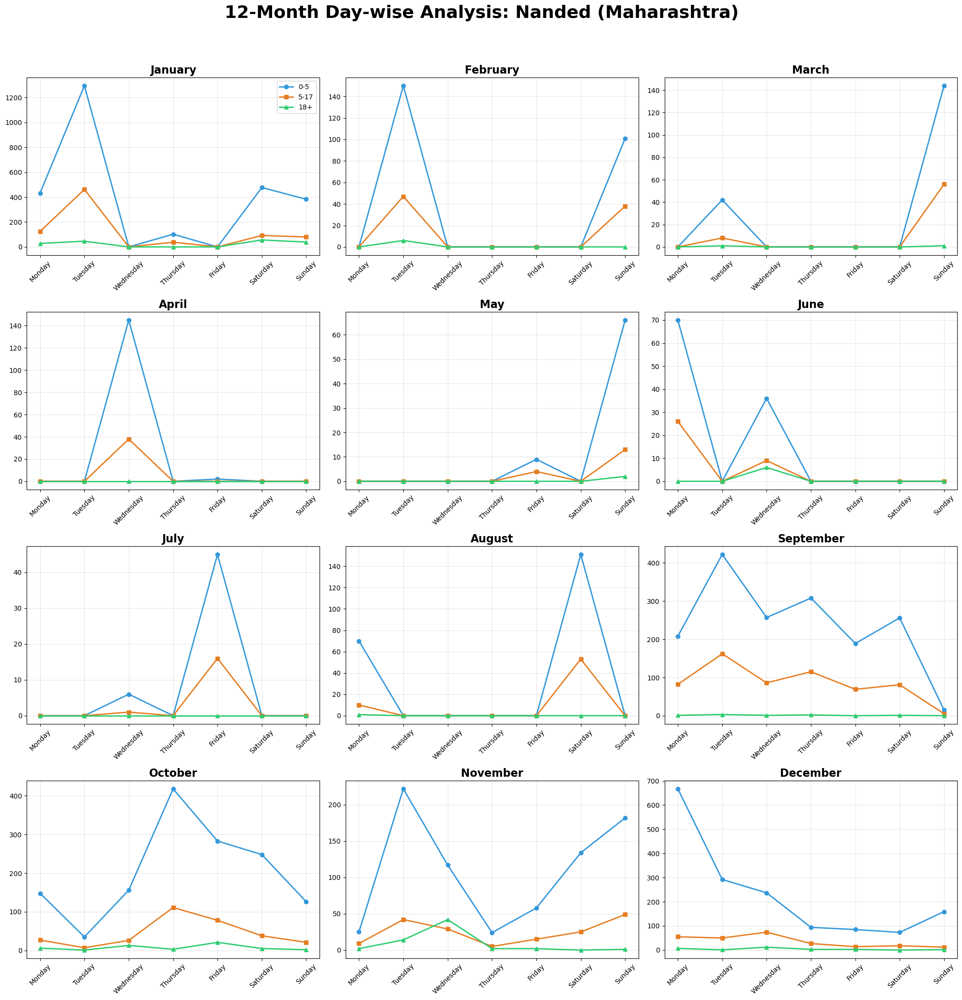

In [256]:
generate_district_monthly_day_plots("Maharashtra")

In [257]:
month_order = ["January", "February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"]
day_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

# Convert to ordered categorical for proper sorting
enrol_df["month_name"] = pd.Categorical(enrol_df["month_name"], categories=month_order, ordered=True)
enrol_df["day_of_week"] = pd.Categorical(enrol_df["day_of_week"], categories=day_order, ordered=True)

def plot_state_district_bottom_day_trends(state_name):
    # 3. Total enrollment for ranking
    enrol_df["total_enrollment"] = enrol_df["age_0_5"] + enrol_df["age_5_17"] + enrol_df["age_18_greater"]

    # 4. Select bottom 10 districts for the given state (using nsmallest)
    district_agg = enrol_df[enrol_df["state"] == state_name].groupby("district")["total_enrollment"].sum().reset_index()
    bottom_districts = district_agg.nsmallest(10, "total_enrollment")["district"].values

    # 5. Filter and Aggregate by District, Month, AND Day of Week
    df_filtered = enrol_df[(enrol_df["state"] == state_name) & (enrol_df["district"].isin(bottom_districts))].copy()
    
    agg = df_filtered.groupby(["district", "month_name", "day_of_week"], observed=True)[
        ["age_0_5", "age_5_17", "age_18_greater"]
    ].sum().reset_index()

    # Sort to ensure continuous timeline (Chronological)
    agg = agg.sort_values(["district", "month_name", "day_of_week"])

    # Create descriptive X-axis labels (e.g., Sep-Mon)
    agg["label"] = agg["month_name"].astype(str).str[:3] + "-" + agg["day_of_week"].astype(str).str[:3]

    # 6. Plotting - Using 10 rows for detail
    fig, axes = plt.subplots(10, 1, figsize=(20, 45))
    fig.suptitle(f"Individual Day-wise Trends for Bottom 10 Districts in {state_name}", fontsize=24, y=1.0)
    
    for i, dist in enumerate(bottom_districts):
        data = agg[agg["district"] == dist]
        ax = axes[i]
        
        if not data.empty:
            ax.plot(data["label"], data["age_0_5"], marker="o", label="0-5", linewidth=1.5)
            ax.plot(data["label"], data["age_5_17"], marker="s", label="5-17", linewidth=1.5)
            ax.plot(data["label"], data["age_18_greater"], marker="^", label="18+", linewidth=1.5)

            ax.set_title(f"District: {dist} (Bottom)", fontsize=18, fontweight='bold')
            ax.set_ylabel("Enrollment Count")
            ax.legend()
            ax.grid(True, alpha=0.3)
            ax.tick_params(axis='x', rotation=90)
        else:
            ax.text(0.5, 0.5, "No Data Available", transform=ax.transAxes, ha="center")
            ax.set_title(f"District: {dist} (Bottom)", fontsize=18, fontweight='bold')

    # Hide unused subplots if the state has fewer than 10 districts
    for j in range(len(bottom_districts), 10):
        axes[j].set_visible(False)

    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


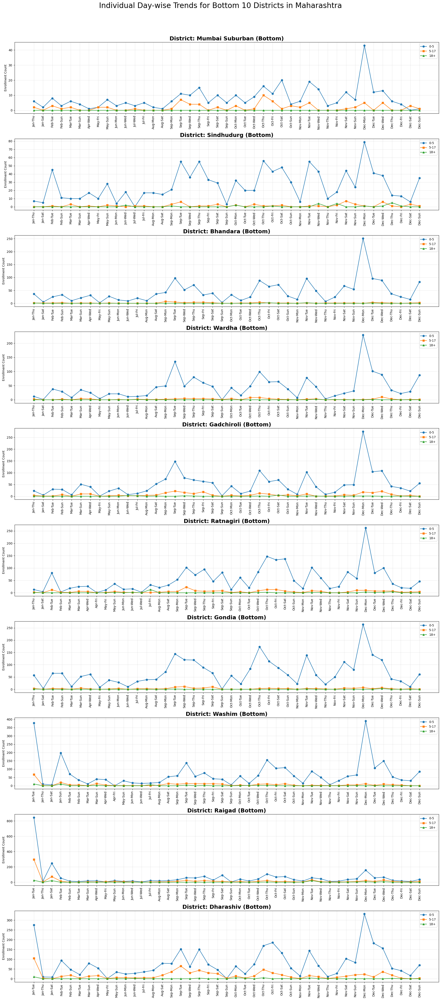

In [258]:
plot_state_district_bottom_day_trends("Maharashtra")

In [259]:
# Define Chronological Orders
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
month_order = ["January", "February", "March", "April", "May", "June", 
               "July", "August", "September", "October", "November", "December"]

# Convert to ordered categorical for proper plotting
enrol_df["month_name"] = pd.Categorical(enrol_df["month_name"], categories=month_order, ordered=True)
enrol_df["day_of_week"] = pd.Categorical(enrol_df["day_of_week"], categories=day_order, ordered=True)

def generate_bottom_district_monthly_day_plots(state_name):
    # Filter for the state and find bottom 10 districts
    state_df = enrol_df[enrol_df['state'] == state_name]
    district_agg = state_df.groupby('district')['total_enrollment'].sum().reset_index()
    
    # Use nsmallest to get bottom 10 districts
    bottom_10_districts = district_agg.nsmallest(10, 'total_enrollment')['district'].tolist()
    
    # Process each district individually
    for dist in bottom_10_districts:
        dist_df = state_df[state_df['district'] == dist]
        
        # Create a 4x3 grid for the 12 months
        fig, axes = plt.subplots(4, 3, figsize=(20, 20))
        fig.suptitle(f'12-Month Day-wise Analysis (Bottom District): {dist} ({state_name})', 
                     fontsize=26, fontweight='bold', y=1.03)
        axes = axes.flatten()
        
        for i, month in enumerate(month_order):
            ax = axes[i]
            
            # Filter and aggregate for this month
            month_data = dist_df[dist_df['month_name'] == month]
            day_data = month_data.groupby('day_of_week', observed=True)[['age_0_5', 'age_5_17', 'age_18_greater']].sum()
            
            # Ensure all 7 days are represented on the axis
            day_data_full = day_data.reindex(day_order).fillna(0).reset_index()
            
            # Plot age groups
            ax.plot(day_data_full['day_of_week'], day_data_full['age_0_5'], marker='o', label='0-5', color='#3498db')
            ax.plot(day_data_full['day_of_week'], day_data_full['age_5_17'], marker='s', label='5-17', color='#e67e22')
            ax.plot(day_data_full['day_of_week'], day_data_full['age_18_greater'], marker='^', label='18+', color='#2ecc71')
            
            ax.set_title(month, fontsize=16, fontweight='bold')
            ax.tick_params(axis='x', rotation=45)
            ax.grid(True, alpha=0.3)
            ax.set_ylim(bottom=0)
            if i == 0: ax.legend()
        
        plt.tight_layout()
        plt.savefig(f'bottom_analysis_{dist.replace(" ", "_")}.png', bbox_inches='tight')
        plt.show()



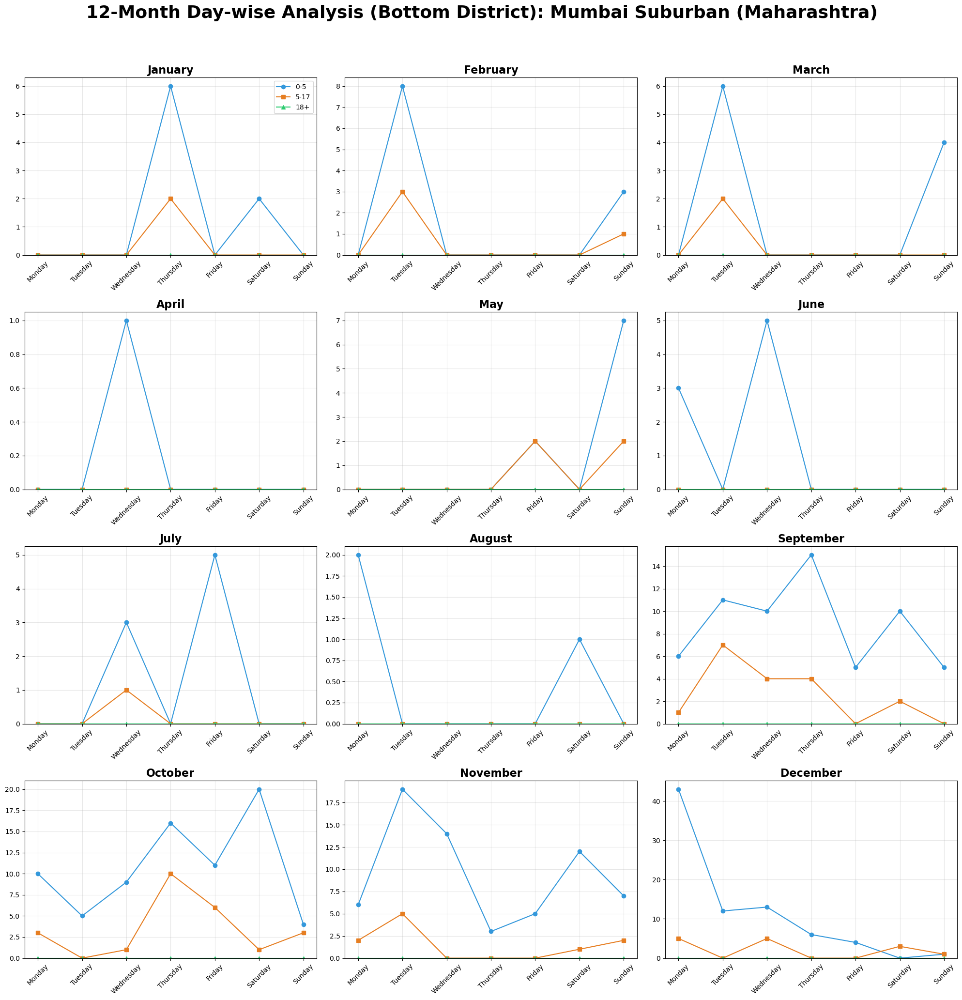

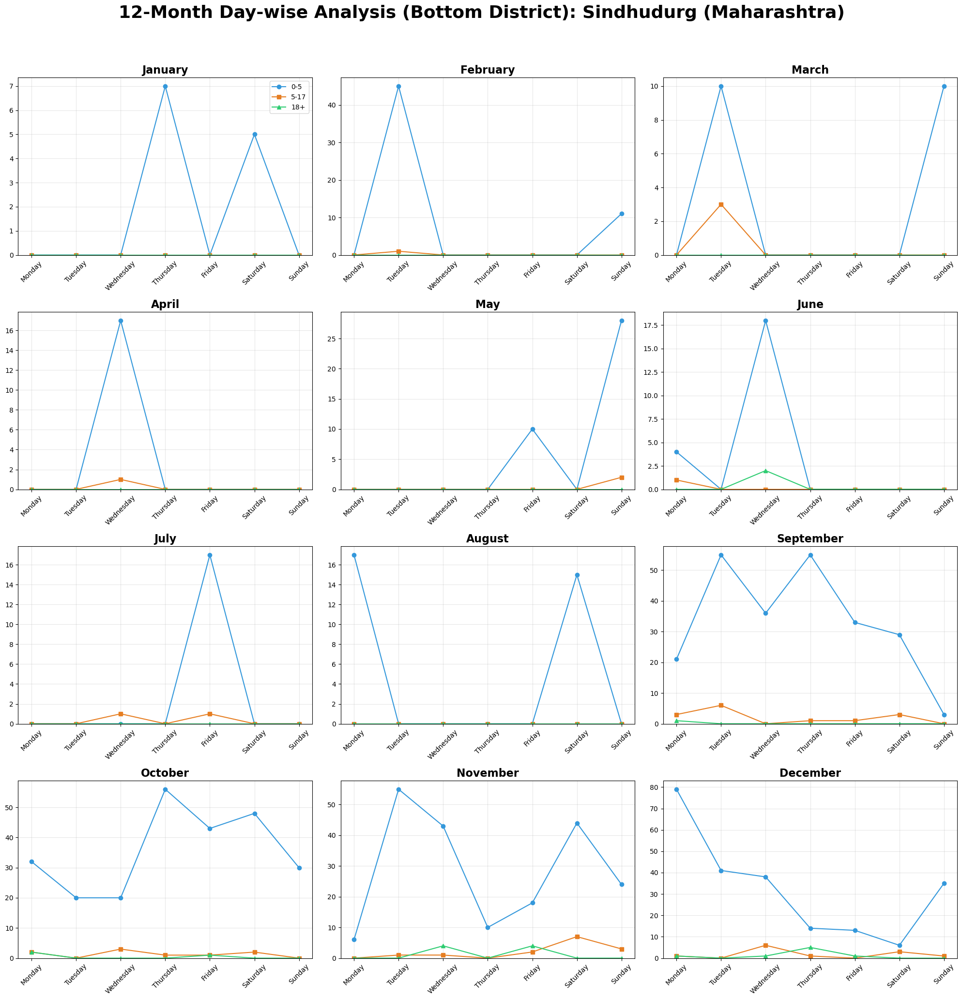

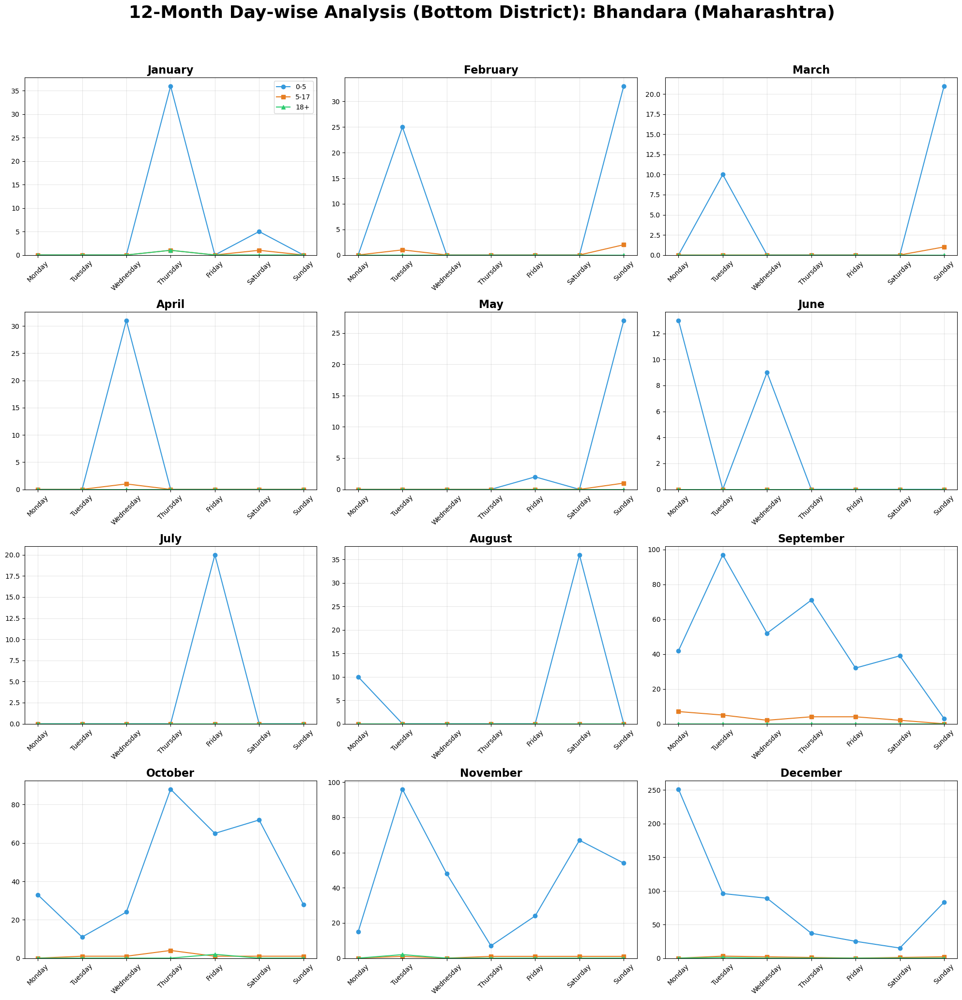

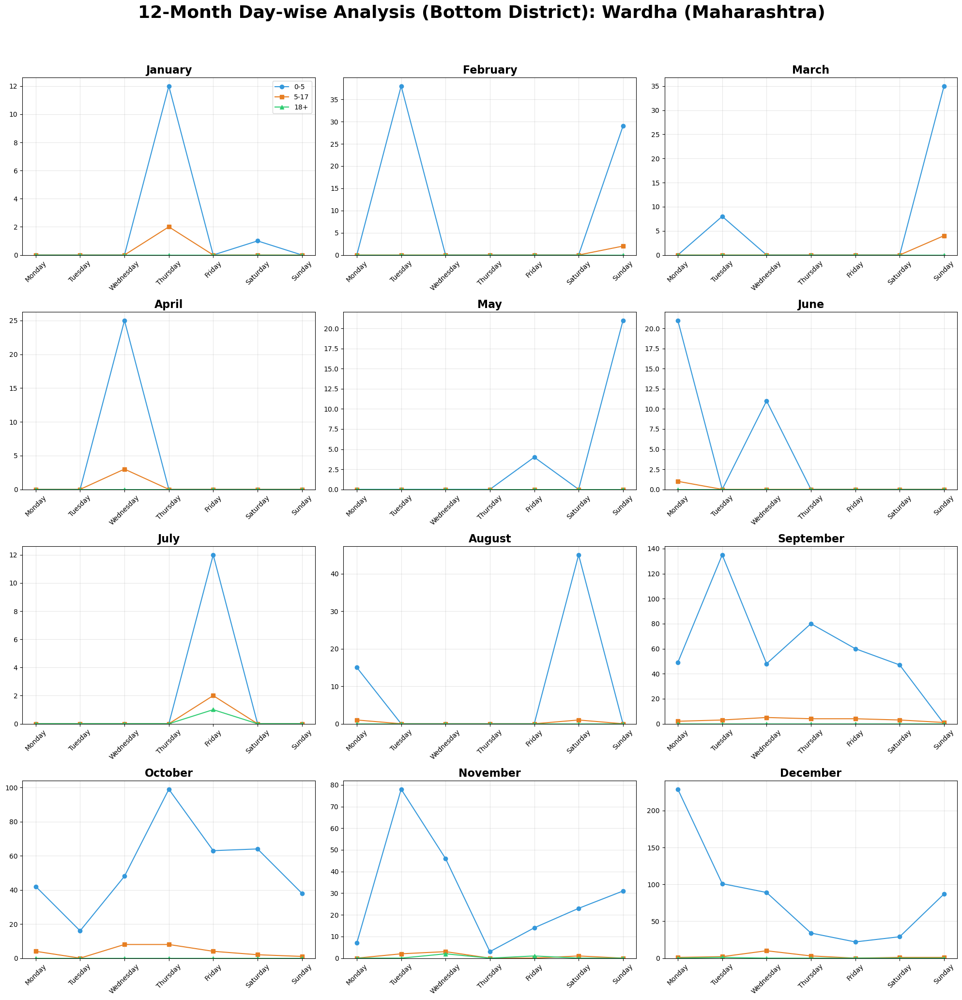

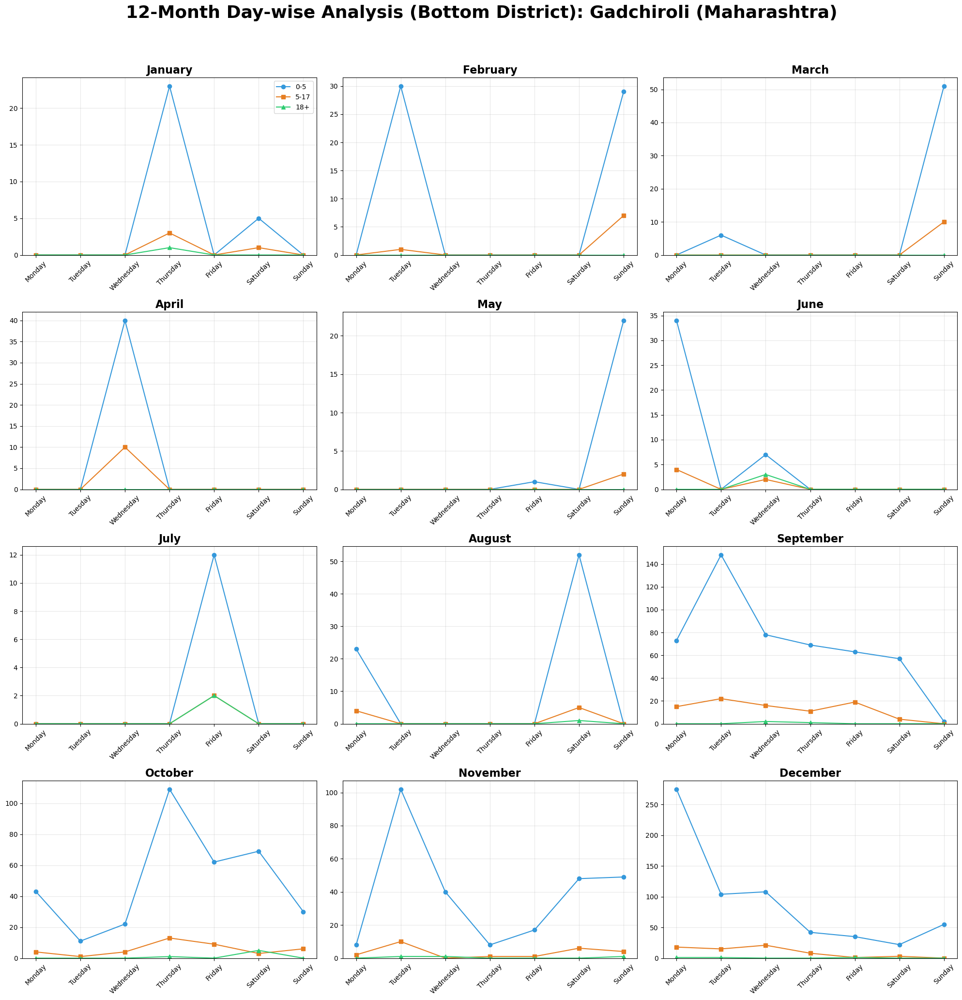

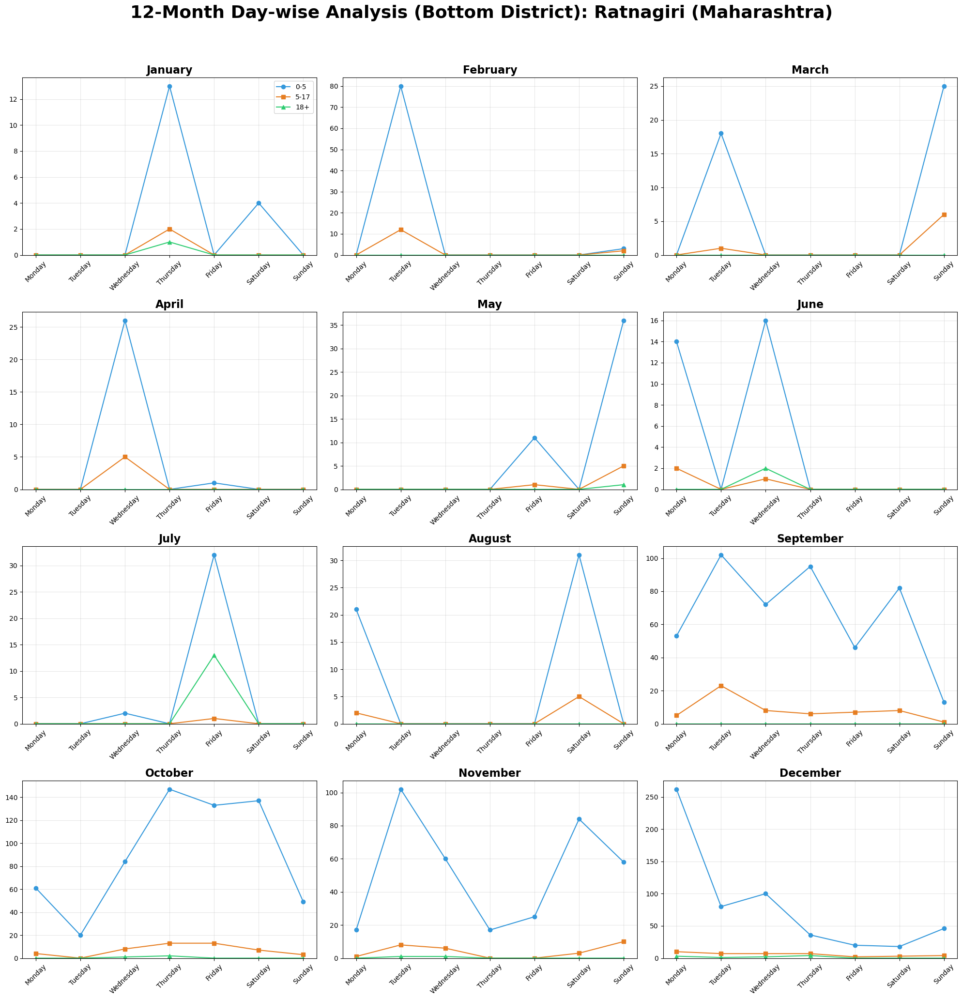

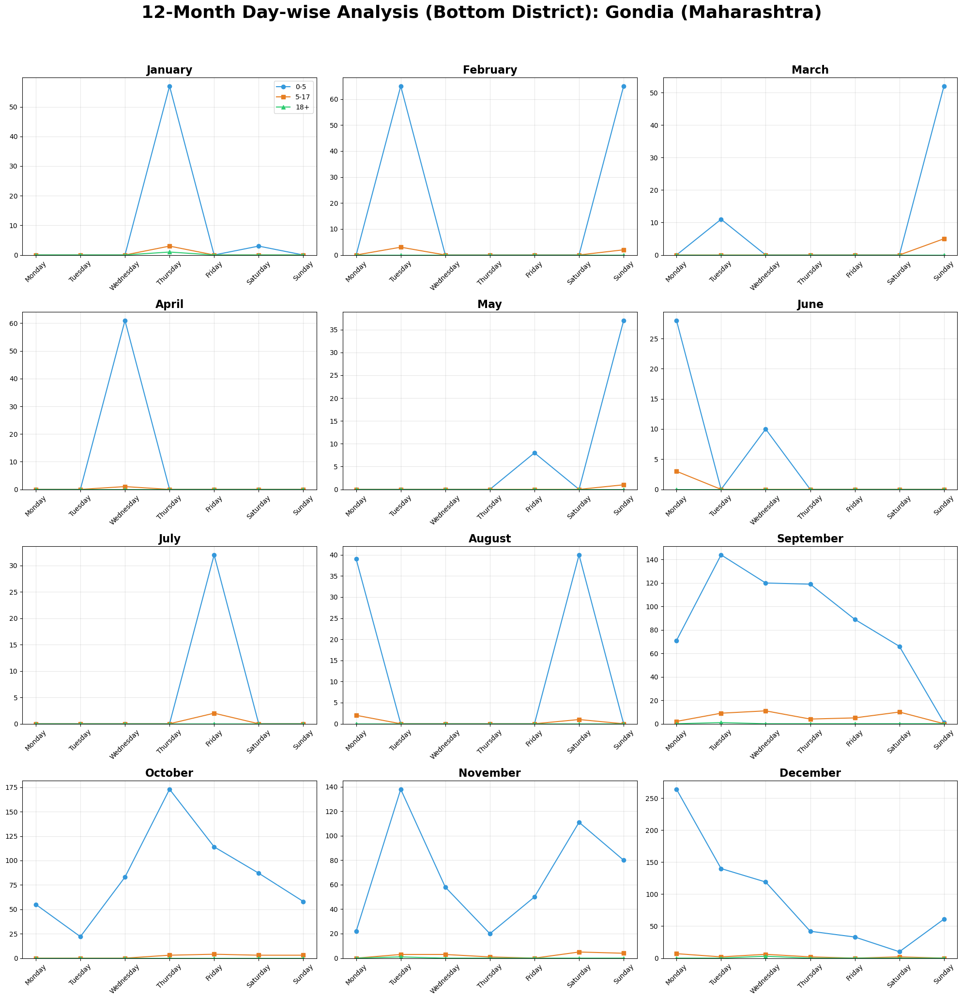

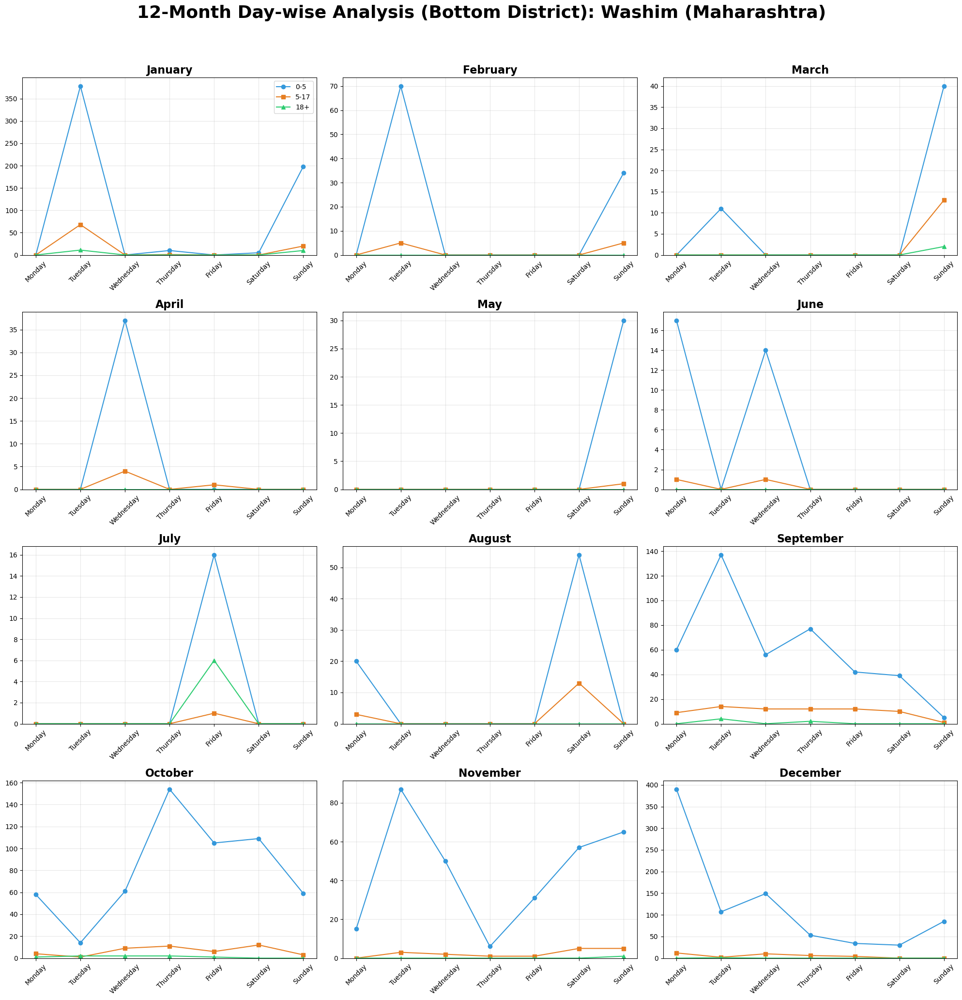

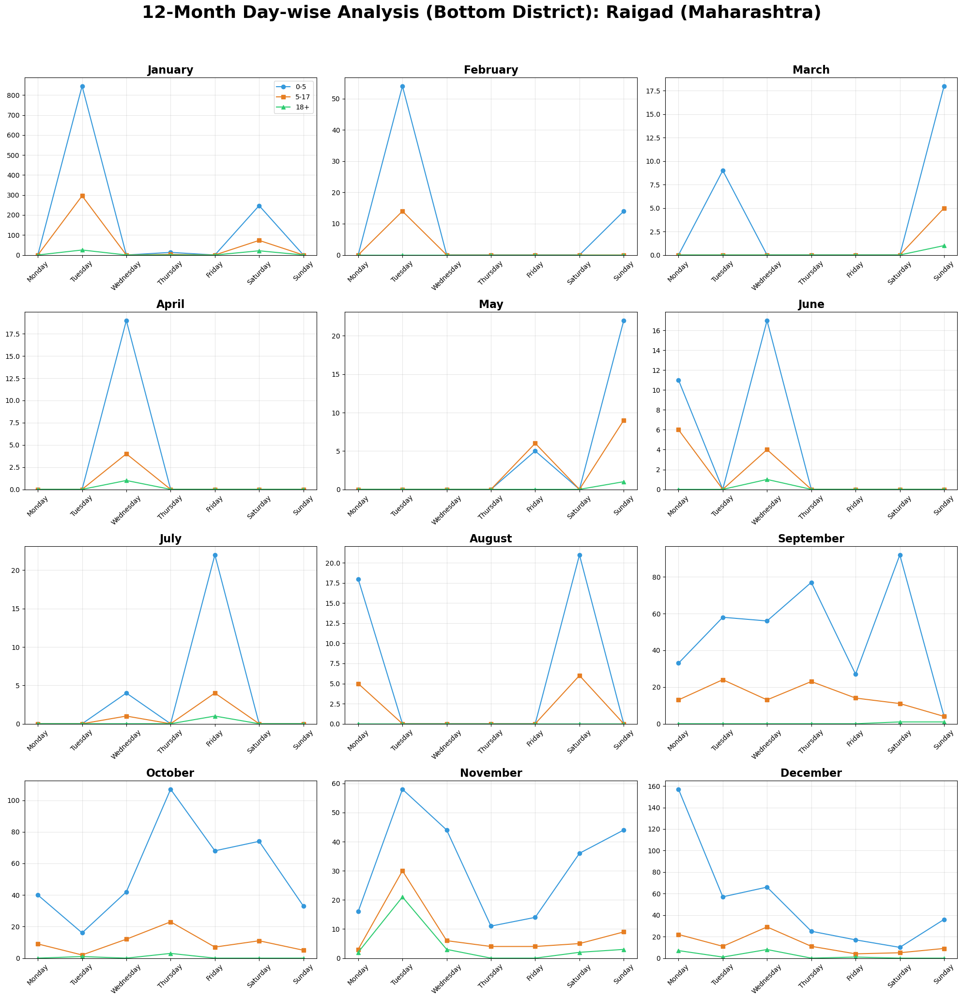

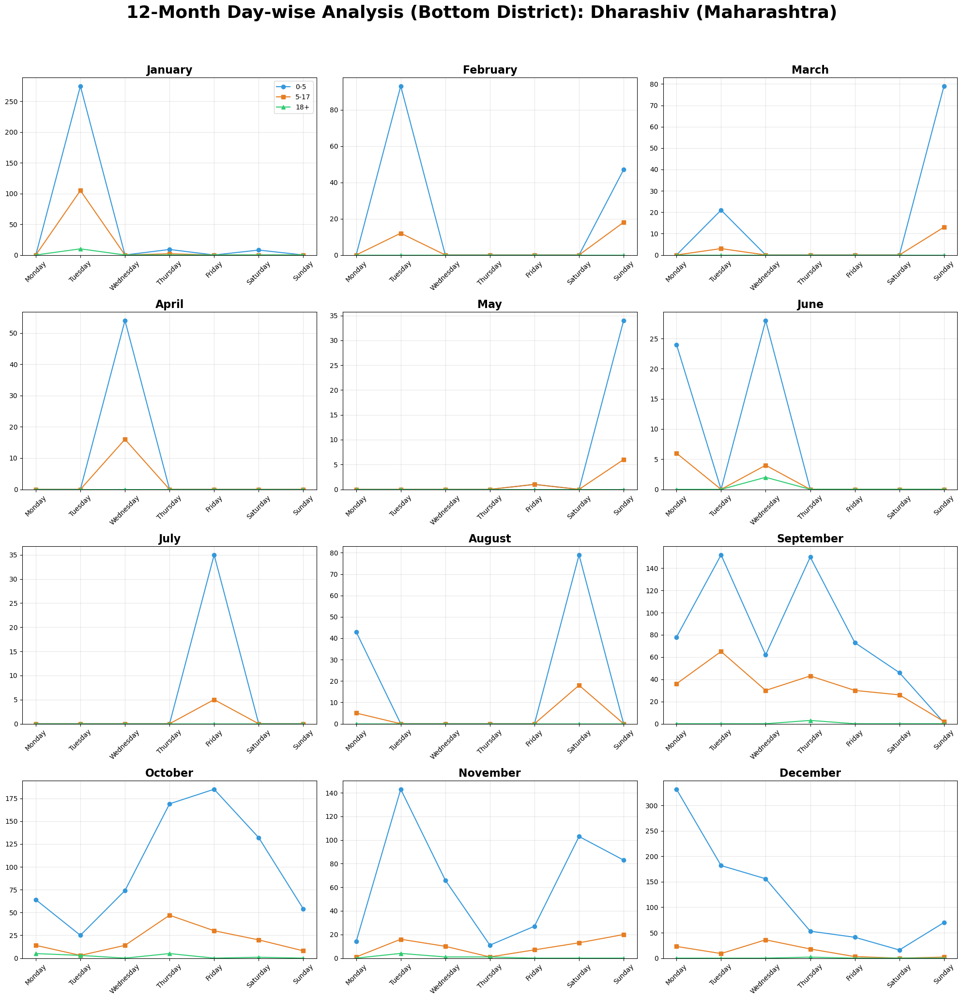

In [260]:
generate_bottom_district_monthly_day_plots("Maharashtra")

In [261]:
enrol_df.to_csv("enrol_df_new.csv", index=False)